# To build baseline model functions

In [1]:
#kernel = python37
from math import sqrt
import pandas as pd
import numpy as np
import sklearn
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from numpy import concatenate
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from datetime import datetime
from keras.layers import Bidirectional
import datetime
from keras.layers import RepeatVector
from keras.layers import TimeDistributed
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from numpy import array
import time
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from keras.layers import Flatten
from keras.layers.convolutional import Conv1D
from keras.layers.convolutional import MaxPooling1D
import tensorflow as tf
import os

from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
os.environ['CUDA_VISIBLE_DEVICES'] = '-1'
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
#********Check GPU
#gpus = tf.config.list_physical_devices('GPU')
#if gpus:
#  # Restrict TensorFlow to only allocate 1GB of memory on the first GPU
#  try:
#    tf.config.set_logical_device_configuration(
#        gpus[0],
#        [tf.config.LogicalDeviceConfiguration(memory_limit=1024*6)])
#    logical_gpus = tf.config.list_logical_devices('GPU')
#    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
#  except RuntimeError as e:
#    # Virtual devices must be set before GPUs have been initialized
#    print(e)

#********time check
from datetime import datetime
now = datetime.now()
dt_string = now.strftime("%Y/%m/%d %H:%M:%S")
print("Last update =", dt_string)

Num GPUs Available:  0
Last update = 2022/01/18 09:51:03


In [2]:
def rmse(pred, actual):
    error = np.subtract(pred, actual)
    sqerror= np.sum(np.square(error))/actual.shape[0]
    return np.sqrt(sqerror)

# Plot functions
To do:
1. Add R2 and MAE plot functions 

In [3]:
def Plot_Mean(name,Overall_Analysis,n_steps_out):


    labels = ['TrainRMSE(Mean)','TestRMSE(Mean)']
    MLP_Adam=[Overall_Analysis[0][0],Overall_Analysis[0][5]]
    MLP_Sgd=[Overall_Analysis[1][0],Overall_Analysis[1][5]]
    LSTM=[Overall_Analysis[2][0],Overall_Analysis[2][5]]
    Bi_LSTM=[Overall_Analysis[3][0],Overall_Analysis[3][5]]
    EN_DC=[Overall_Analysis[4][0],Overall_Analysis[4][5]]
    RNN=[Overall_Analysis[5][0],Overall_Analysis[5][5]]
    CNN=[Overall_Analysis[6][0],Overall_Analysis[6][5]]
    
    #yer1 = Train_CI_LB - Train_mean, Test_CI_LB - Test_mean
    yer1=np.array([Overall_Analysis[0][3]-Overall_Analysis[0][0],Overall_Analysis[0][8]-Overall_Analysis[0][5]])
    yer2=np.array([Overall_Analysis[1][3]-Overall_Analysis[1][0],Overall_Analysis[1][8]-Overall_Analysis[1][5]])
    yer3=np.array([Overall_Analysis[2][3]-Overall_Analysis[2][0],Overall_Analysis[2][8]-Overall_Analysis[2][5]])
    yer4=np.array([Overall_Analysis[3][3]-Overall_Analysis[3][0],Overall_Analysis[3][8]-Overall_Analysis[3][5]])
    yer5=np.array([Overall_Analysis[4][3]-Overall_Analysis[4][0],Overall_Analysis[4][8]-Overall_Analysis[4][5]])
    yer6=np.array([Overall_Analysis[5][3]-Overall_Analysis[5][0],Overall_Analysis[5][8]-Overall_Analysis[5][5]])
    yer7=np.array([Overall_Analysis[6][3]-Overall_Analysis[6][0],Overall_Analysis[6][8]-Overall_Analysis[6][5]])
    
    width = 0.12  # the width of the bars
    Plot(name,labels,width,MLP_Adam,MLP_Sgd,LSTM,Bi_LSTM,EN_DC,RNN,CNN,yer1,yer2,yer3,yer4,yer5,yer6,yer7,"","","Train&Test_RMSE_Mean_Comparison",4,'Train/Test Mean RMSE Comparison')



def Plot_Step_RMSE_Mean(name,Overall_Analysis,n_steps_out):


    MLP_Adam=Overall_Analysis[0,10:n_steps_out*5+10:5]
    MLP_Sgd=Overall_Analysis[1,10:n_steps_out*5+10:5]
    LSTM=Overall_Analysis[2,10:n_steps_out*5+10:5]
    Bi_LSTM=Overall_Analysis[3,10:n_steps_out*5+10:5]
    EN_DC=Overall_Analysis[4,10:n_steps_out*5+10:5]
    RNN=Overall_Analysis[5,10:n_steps_out*5+10:5]
    CNN=Overall_Analysis[6,10:n_steps_out*5+10:5]
    yer1=np.subtract(Overall_Analysis[0,13:n_steps_out*5+10:5],MLP_Adam)
    yer2=np.subtract(Overall_Analysis[1,13:n_steps_out*5+10:5],MLP_Sgd)
    yer3=np.subtract(Overall_Analysis[2,13:n_steps_out*5+10:5],LSTM)
    yer4=np.subtract(Overall_Analysis[3,13:n_steps_out*5+10:5],Bi_LSTM)
    yer5=np.subtract(Overall_Analysis[4,13:n_steps_out*5+10:5],EN_DC)
    yer6=np.subtract(Overall_Analysis[5,13:n_steps_out*5+10:5],RNN)
    yer7=np.subtract(Overall_Analysis[6,13:n_steps_out*5+10:5],CNN)
    labels = []
    for j in range(n_steps_out):
        labels=np.concatenate((labels,[str(j+1)]))
    width = 0.12  # the width of the bars
    Plot(name,labels,width,MLP_Adam,MLP_Sgd,LSTM,Bi_LSTM,EN_DC,RNN,CNN,yer1,yer2,yer3,yer4,yer5,yer6,yer7,"Steps","RMSE(Mean)","Step_RMSE_Comparison",2,'Step RMSE comparison')
    

def Plot(name,labels,width,MLP_Adam,MLP_Sgd,LSTM,Bi_LSTM,EN_DC,RNN,CNN,yer1,yer2,yer3,yer4,yer5,yer6,yer7,xlabel,ylabel,Gname,cap,title_name):

    
    r1 = np.arange(len(labels))
    r2 = [x + width for x in r1]
    r3 = [x + width for x in r2]
    r4 = [x + width for x in r3]
    r5 = [x + width for x in r4]
    r6 = [x + width for x in r5]
    r7 = [x + width for x in r6]

    fig, ax = plt.subplots()
    plt.suptitle(f'{title_name}')
    rects1 = ax.bar(r1, MLP_Adam, width,edgecolor = 'black', yerr=yer1, capsize=cap, label='FNN-Adam')
    rects2 = ax.bar(r2, MLP_Sgd, width,edgecolor = 'black', yerr=yer2,capsize=cap,  label='FNN-SGD')
    rects3 = ax.bar(r3, LSTM, width,edgecolor = 'black', yerr=yer3,capsize=cap,  label='LSTM')
    rects4 = ax.bar(r4, Bi_LSTM, width,edgecolor = 'black', yerr=yer4,capsize=cap,  label='BD-LSTM')
    rects5 = ax.bar(r5, EN_DC, width,edgecolor = 'black', yerr=yer5,capsize=cap,  label='ED-LSTM')
    rects6 = ax.bar(r6, RNN, width,edgecolor = 'black', yerr=yer6,capsize=cap,  label='RNN')
    rects7 = ax.bar(r7, CNN, width,edgecolor = 'black', yerr=yer7,capsize=cap,  label='CNN')
    
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.xticks([r + width for r in range(len(MLP_Adam))], labels)
    plt.setp(ax.get_xticklabels(), fontsize=8)
    ax.legend()
    fig.tight_layout()
    plt.savefig("Results/"+name+"/"+Gname+".png",dpi=300,bbox_inches='tight')
    plt.show()
    

# Model functions
To do 
1. Need to test how batch size from n to 36 affect the result of RNN models

Important
1. Batch size >> 36
2. lr >> 0.0003


# Execution

Observed
Experiment 1 in progress
TrainRMSE_Mean 0.37000425329569975
TestRMSE_Mean 0.6526964429885016
Experiment 2 in progress
TrainRMSE_Mean 0.3988496046527524
TestRMSE_Mean 0.6752369427425199
Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.3608308842794749
TestRMSE_Mean 0.6426769793286328
Experiment 4 in progress
TrainRMSE_Mean 0.3772876636151851
TestRMSE_Mean 0.5972644877926141
Experiment 5 in progress
TrainRMSE_Mean 0.35795898682141963
TestRMSE_Mean 0.6841560754885238
Experiment 6 in progress
TrainRMSE_Mean 0.38796815364008347
TestRMSE_Mean 0.6472377116629312
Experiment 7 in progress
TrainRMSE_Mean 0.3521871683708981
TestRMSE_Mean 0.7255650635047305
Experiment 8 in progress
TrainRMSE_Mean 0.3481174965116288
TestRMSE_Mean 0.7161897662716077
Experiment 9 in progress
TrainRMSE_Mean 0.3743321365631004
TestRMSE_Mean 0.6562847398741549
Experiment 10 in progress
TrainRMSE_Mean 0.3610002767601117
TestRMSE_Mean 0.6460093772470417
Total time for 10 experiments 9.58620834350586
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.37000   0.65270  0.20214  0.37088  0.49759
Exp2     0.39885   0.67524  0.20467  0.37963  0.51956
Exp3     0.36083   0.64268  0.17800  0.36008  0.50169
Exp4    

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


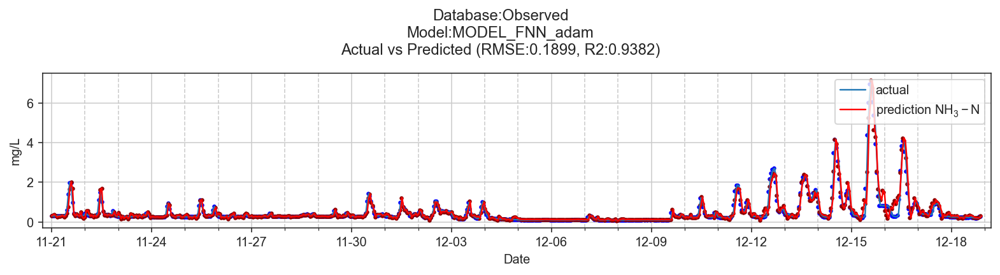

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


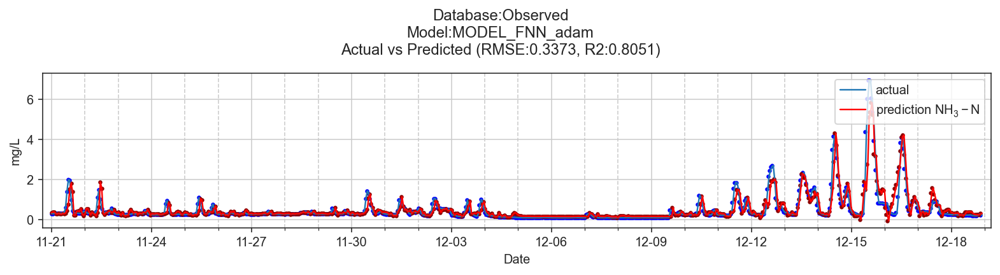

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


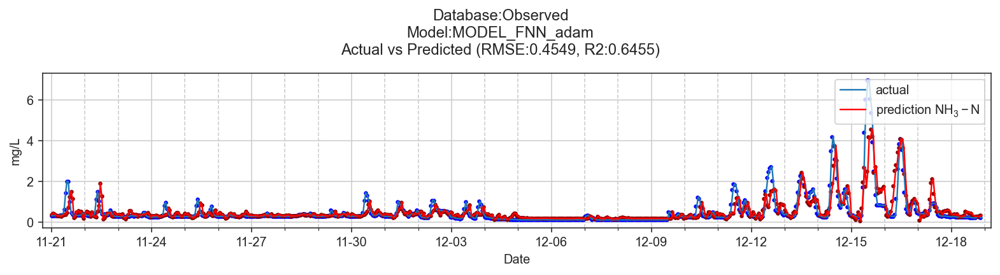

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


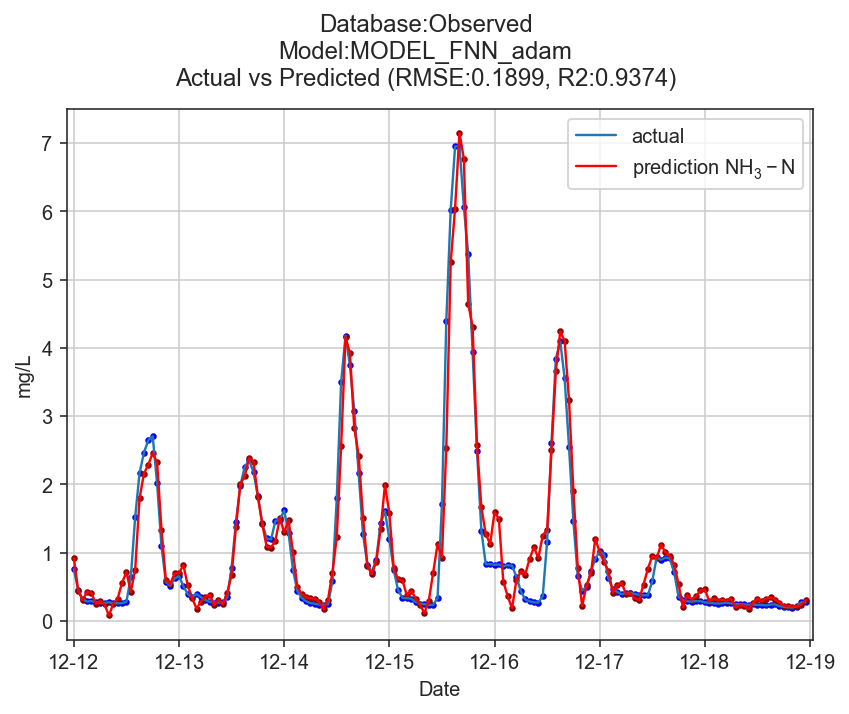

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


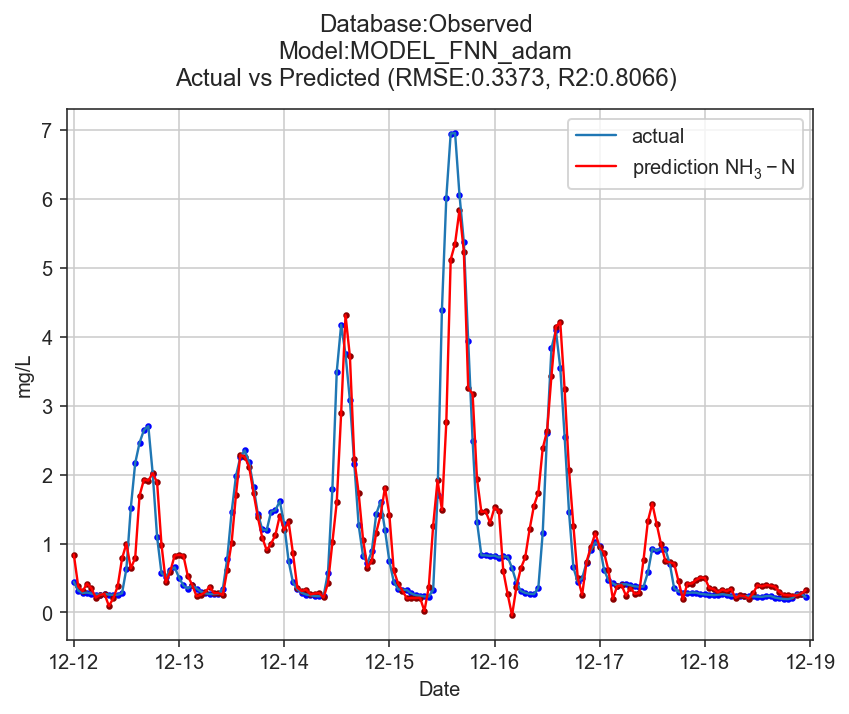

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


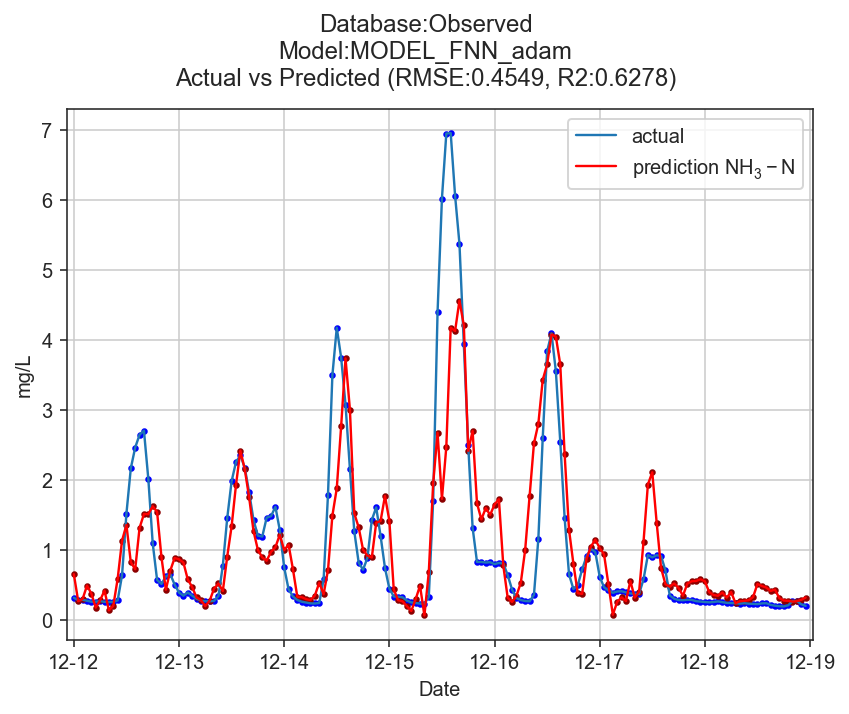

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 10.371768236160278
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.43253   0.65868  0.20559  0.37886  0.49806
Exp2     0.44415   0.70820  0.25361  0.37158  0.54696
Exp3     0.42701   0.65508  0.20775  0.37835  0.49277
Exp4     0.43053   0.64229  0.19911  0.36842  0.48698
Exp5     0.45485   0.70547  0.24080  0.39602  0.53185
Exp6     0.43487   0.65589  0.19890  0.38064  0.49572
Exp7     0.42747   0.66043  0.21779  0.38541  0.49009
Exp8     0.43324   0.64927  0.22530  0.36959  0.48394
Exp9     0.44224   0.70842  0.26652  0.40521  0.51636
Exp10    0.42584   0.66628  0.21272  0.38334  0.50172
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.43527             0.00874  0.42986  0.44069  0.42584  0.45485
TestRMSE   0.67100             0.02457  0.65577  0.68623  0.64229  0.70842
Step1      0.22281             0.02230  0.20899  0.23663  0.19890  0.26652
Step2      0.38174             0.01105  0.3

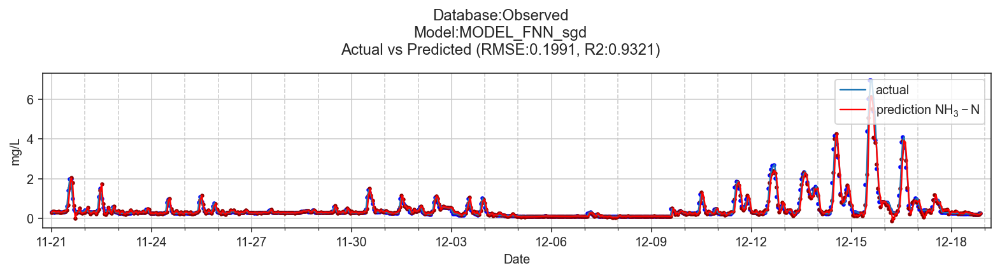

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


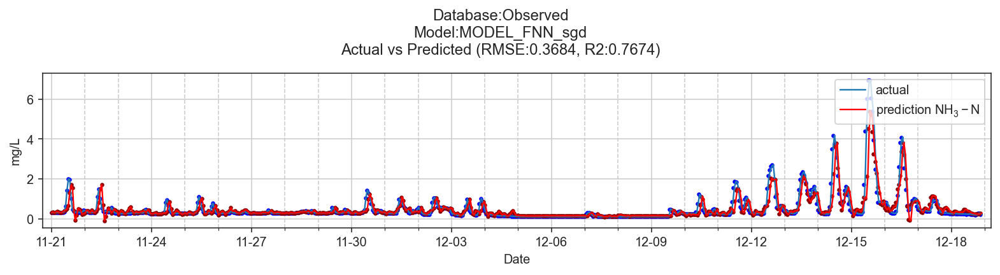

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


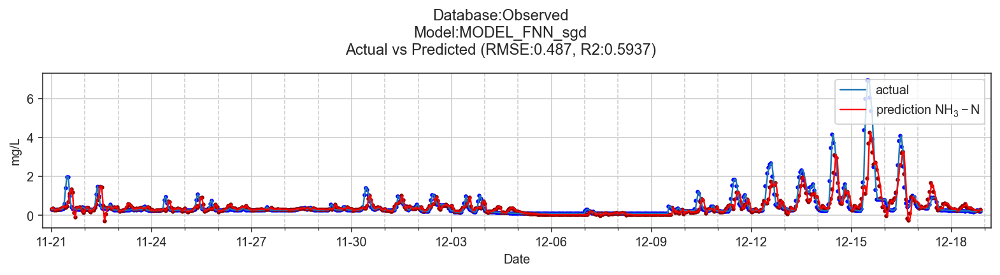

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


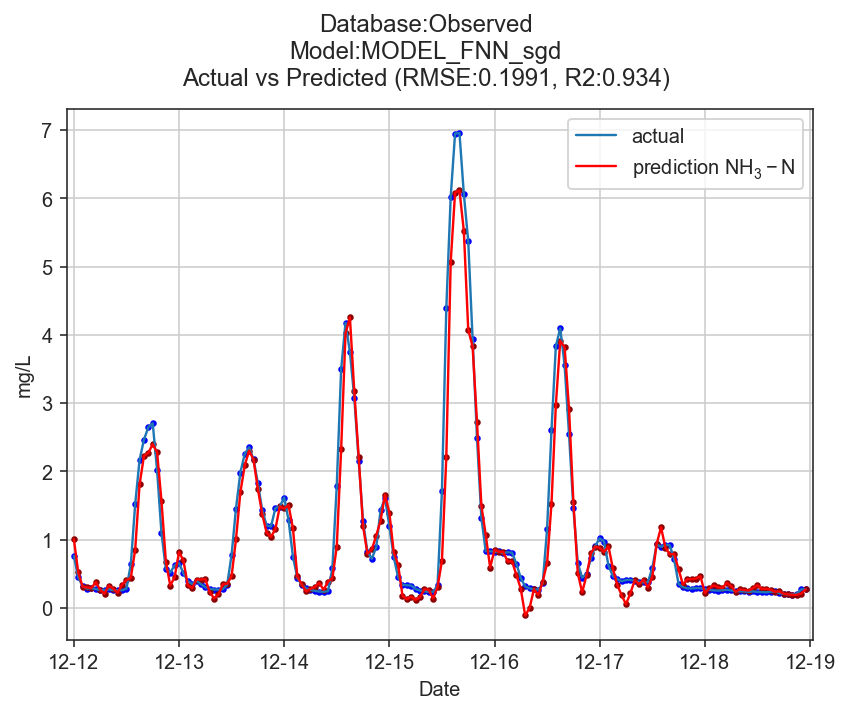

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


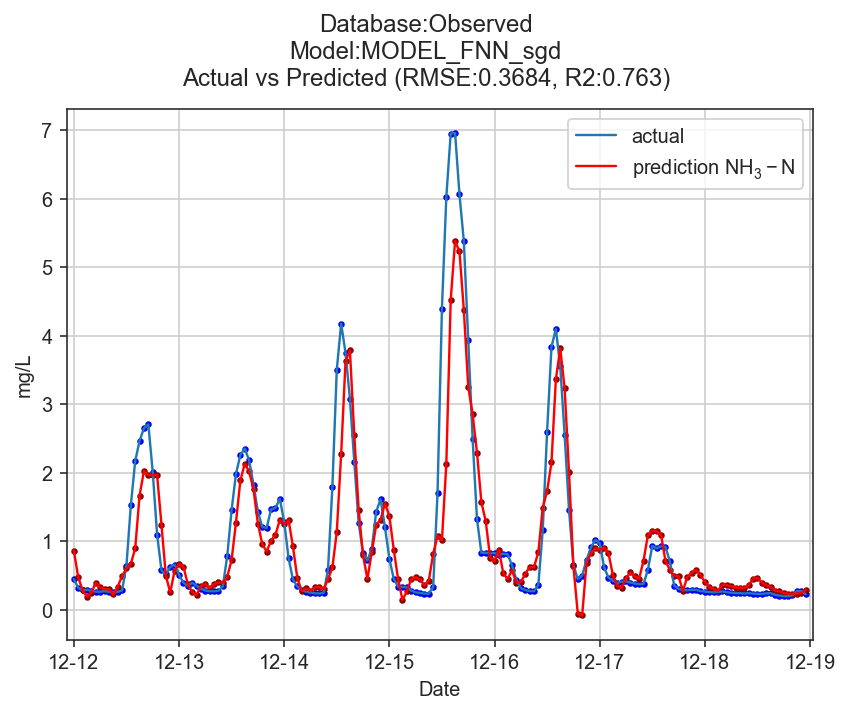

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


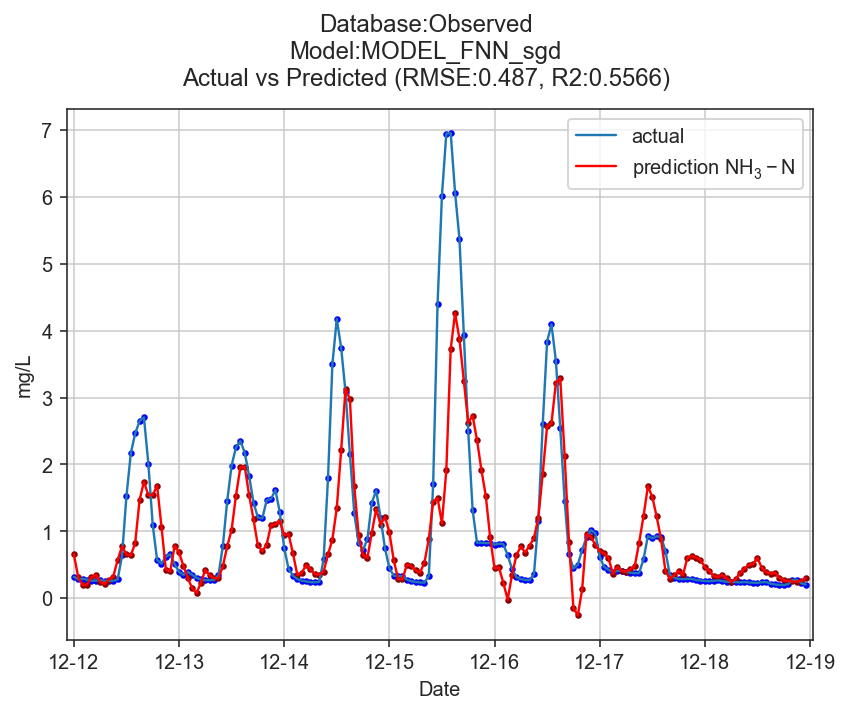

(934, 24, 1)
(670, 24, 1)
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 10)                480       
_________________________________________________________________
dense (Dense)                (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 359.59567284584045
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.31733   0.78635  0.24267  0.45854  0.59094
Exp2     0.25222   0.96553  0.33353  0.57081  0.70369
Exp3     0.23323   1.

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


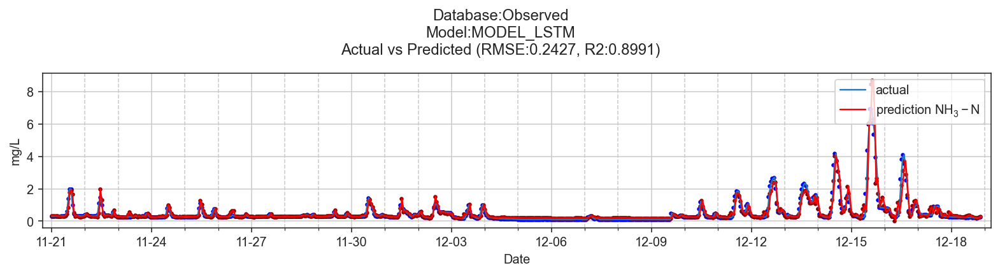

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


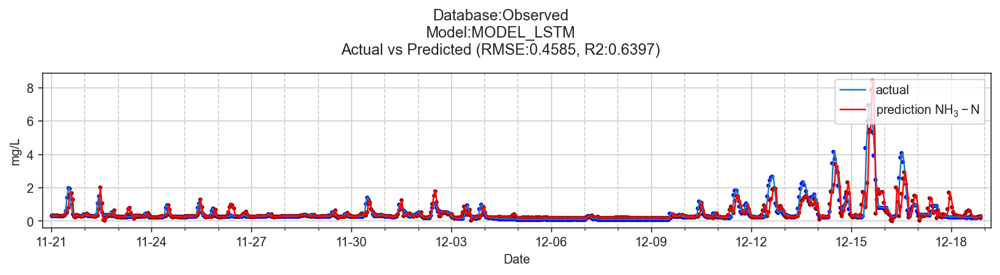

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


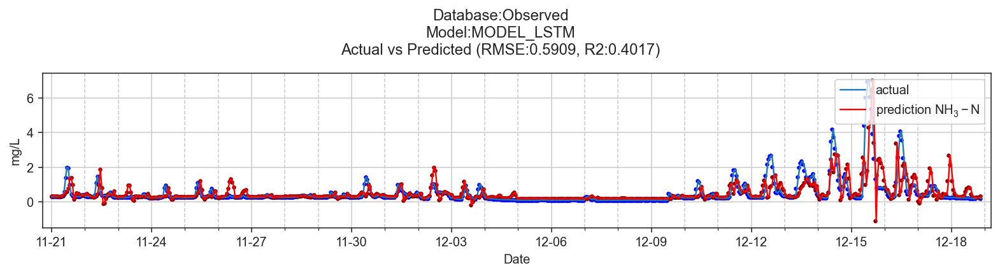

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


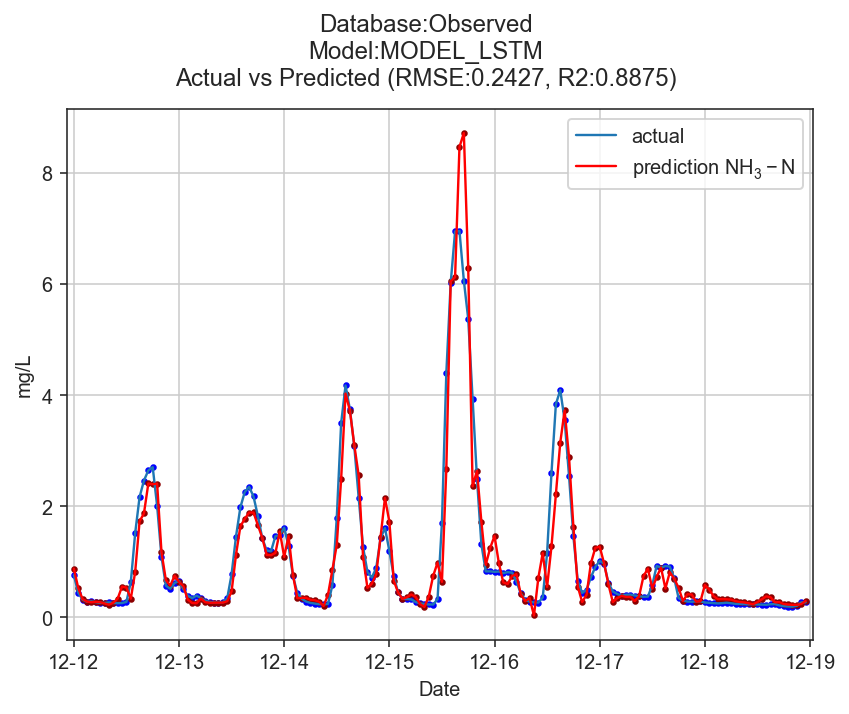

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


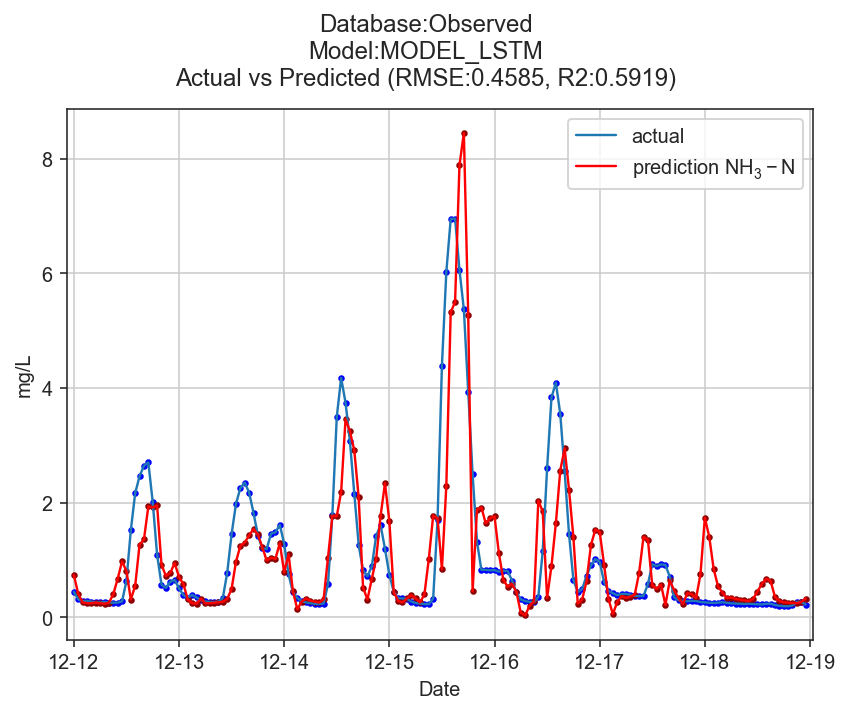

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


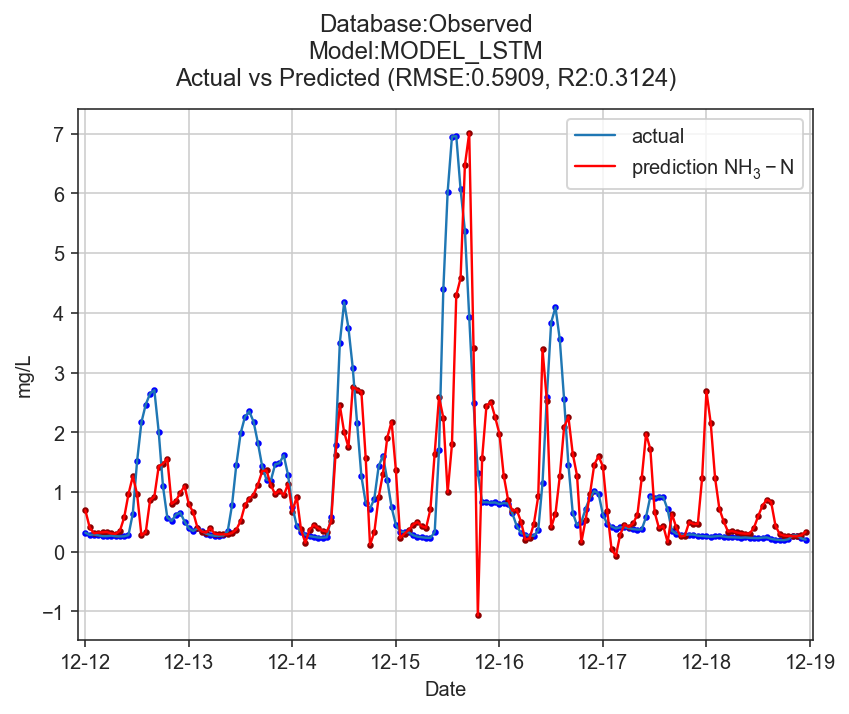

(934, 24, 1)
(670, 24, 1)
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional (Bidirectional (None, 20)                960       
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 434.98486399650574
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.36584   1.15064  0.34320  0.64425  0.88945
Exp2     0.30483   1.22632  0.40138  0.75425  0.87970
Exp3     0.2

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


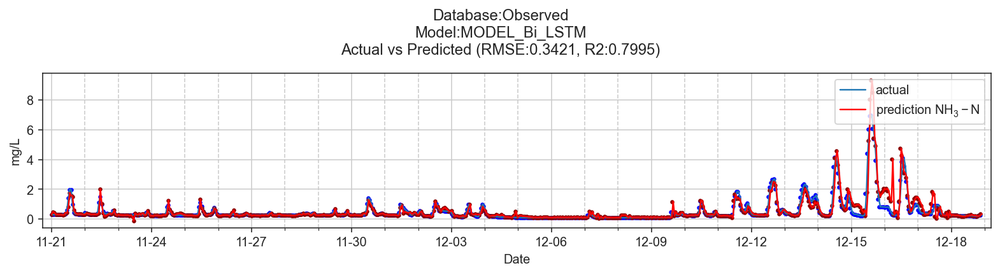

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


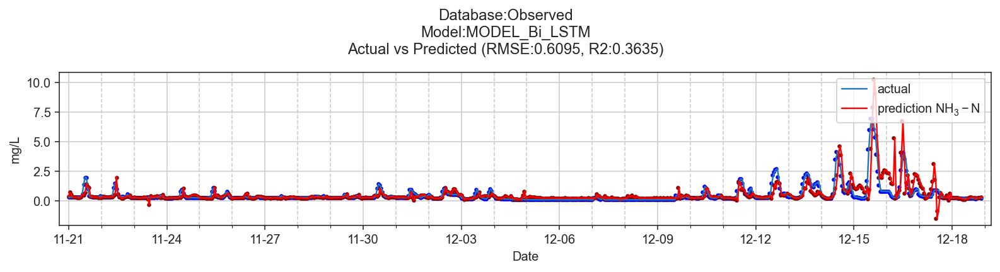

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


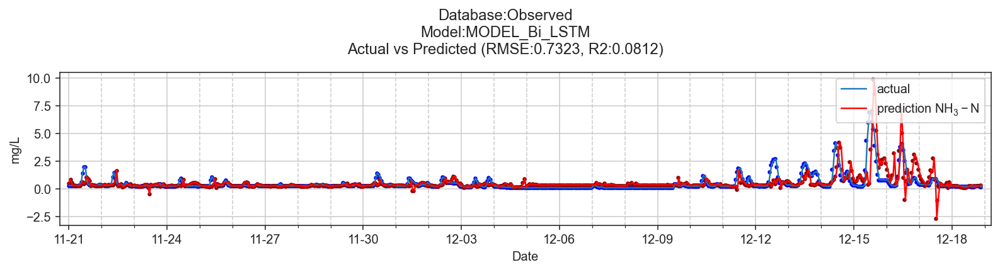

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


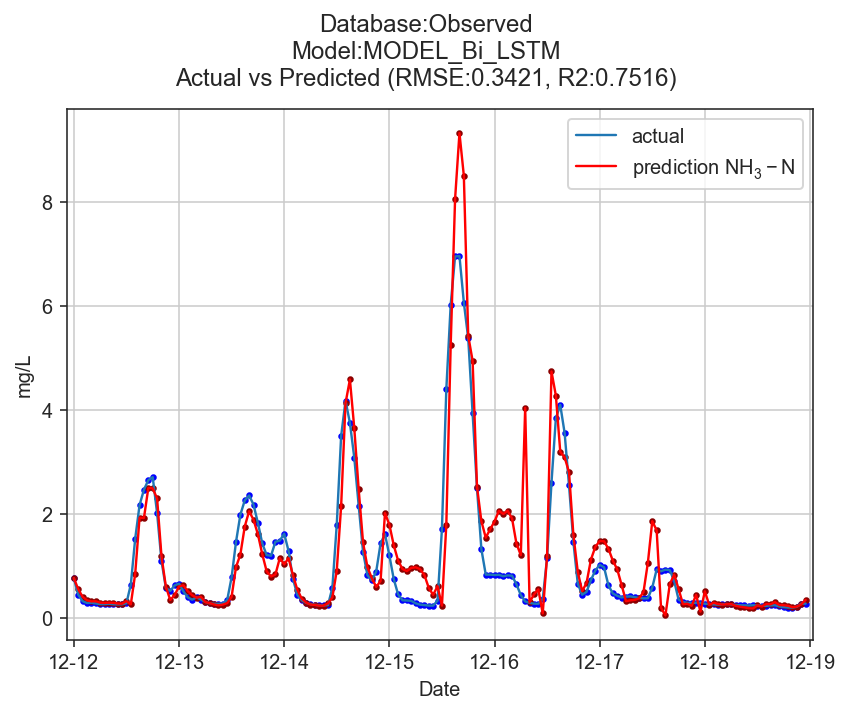

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


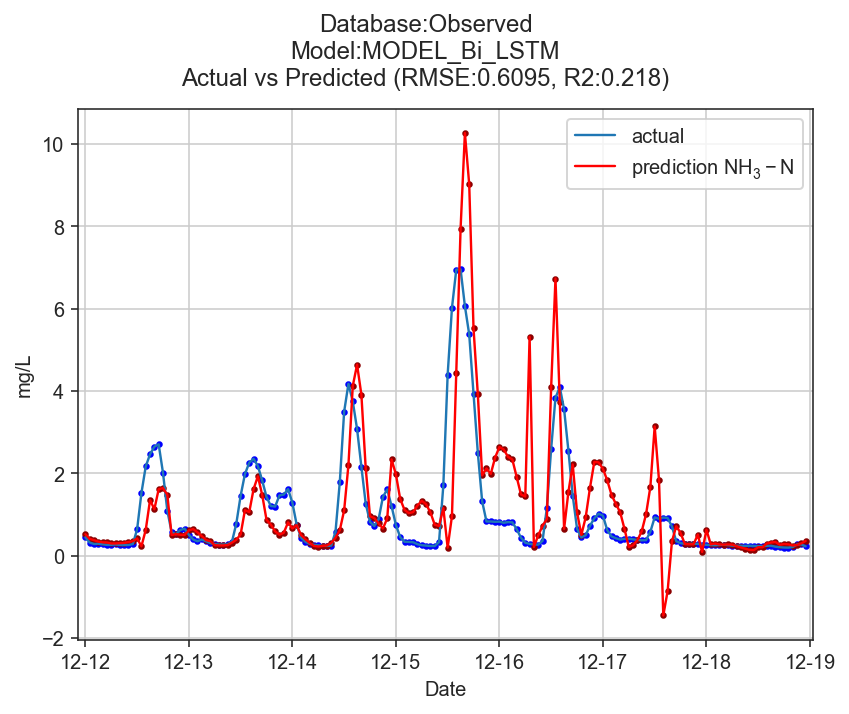

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


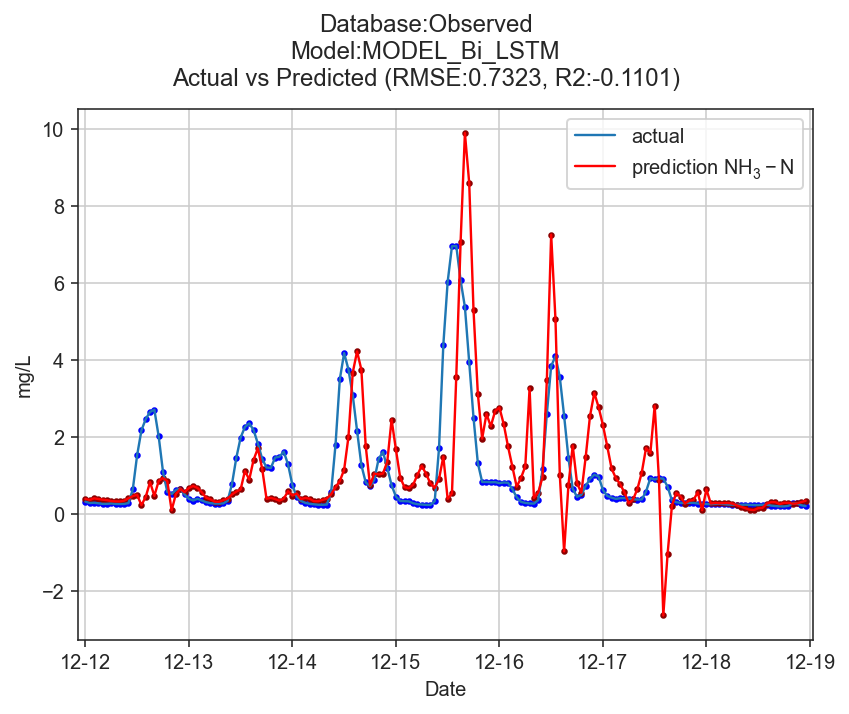

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 10)                480       
_________________________________________________________________
repeat_vector (RepeatVector) (None, 3, 10)             0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 3, 10)             840       
_________________________________________________________________
time_distributed (TimeDistri (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress


C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


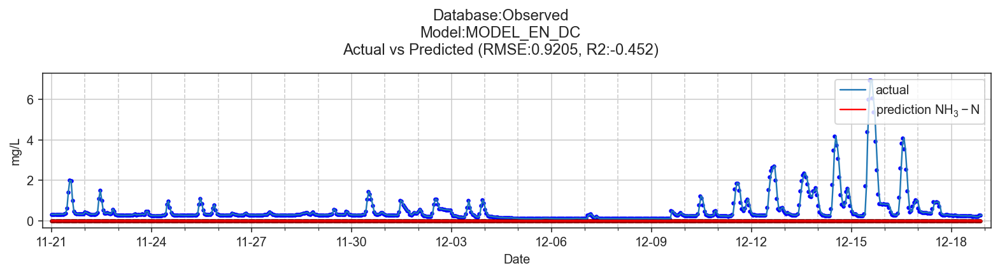

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


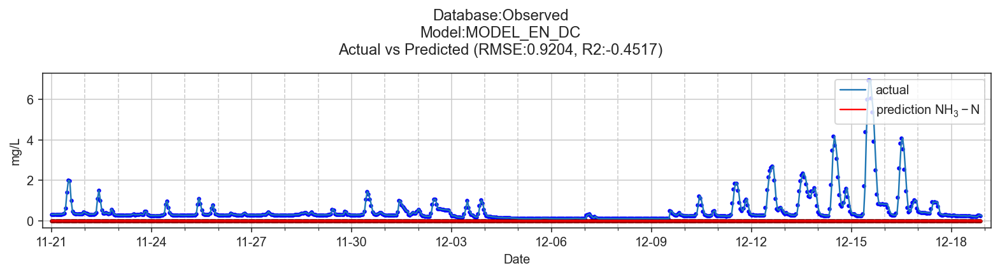

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


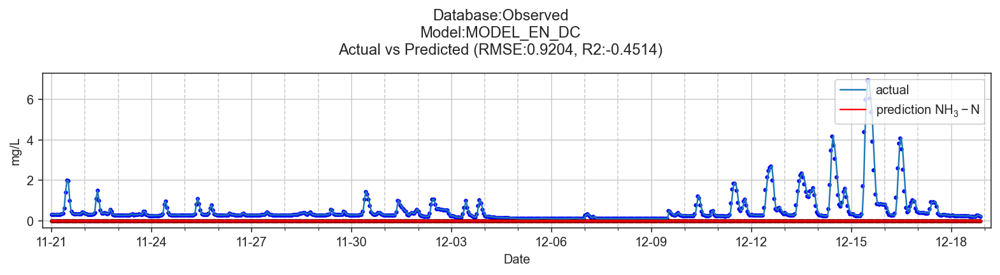

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


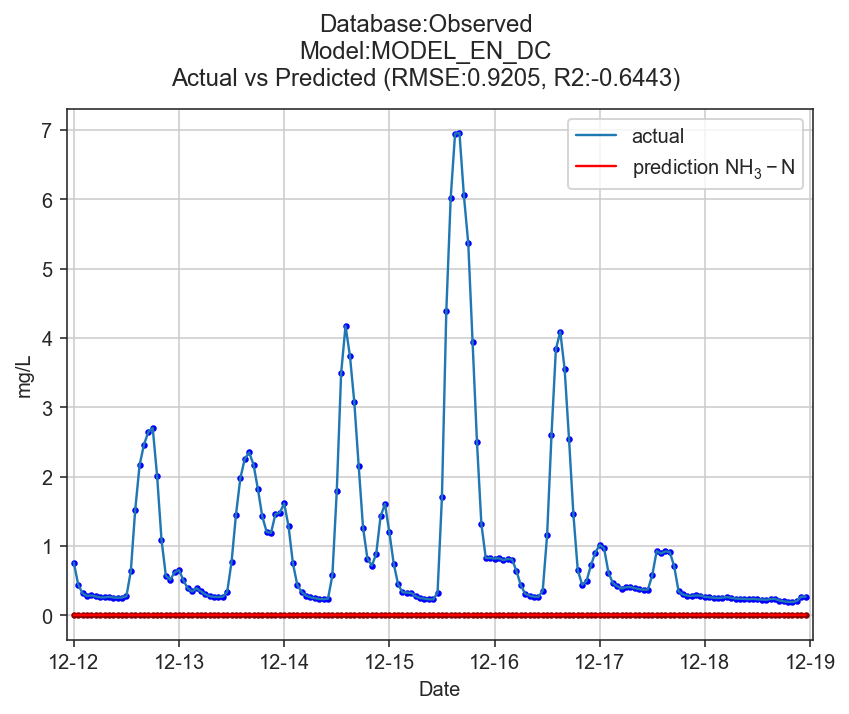

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


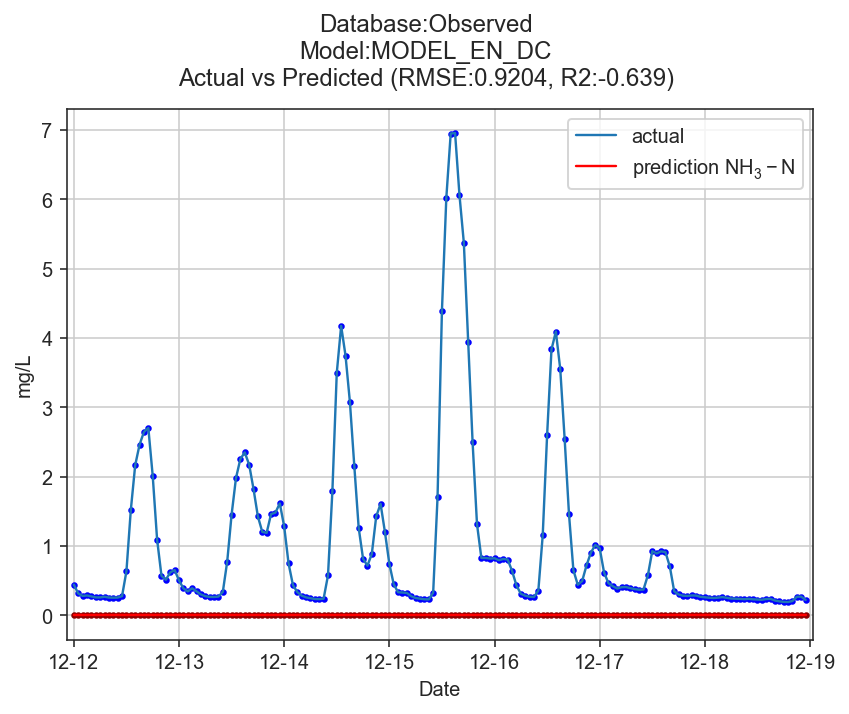

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


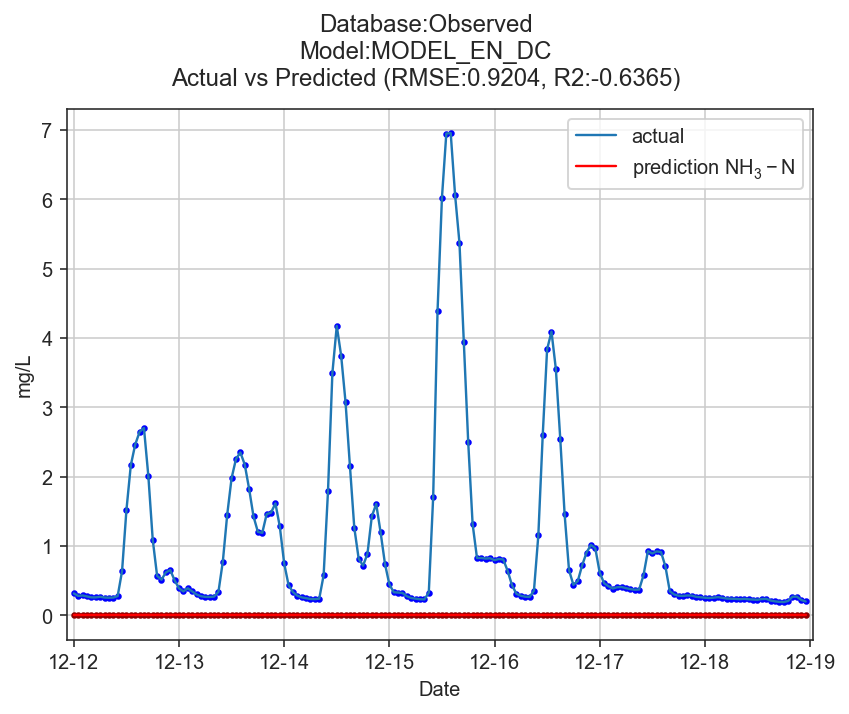

Experiment 1 in progress
TrainRMSE_Mean 0.7314820089150769
TestRMSE_Mean 1.4665370197366108
Experiment 2 in progress
TrainRMSE_Mean 0.7119988907110615
TestRMSE_Mean 1.6051330975563938
Experiment 3 in progress
TrainRMSE_Mean 0.7153175189866506
TestRMSE_Mean 1.6731290263094916
Experiment 4 in progress
TrainRMSE_Mean 0.7314520637815677
TestRMSE_Mean 1.4003295669359968
Experiment 5 in progress
TrainRMSE_Mean 0.7083342687606933
TestRMSE_Mean 1.6369377966713625
Experiment 6 in progress
TrainRMSE_Mean 0.7082637690059526
TestRMSE_Mean 1.7508006764115853
Experiment 7 in progress
TrainRMSE_Mean 0.7245836298349865
TestRMSE_Mean 1.4279946505764287
Experiment 8 in progress
TrainRMSE_Mean 0.7113739113852453
TestRMSE_Mean 1.572982691420236
Experiment 9 in progress
TrainRMSE_Mean 0.7321335461063048
TestRMSE_Mean 1.408801364540841
Experiment 10 in progress
TrainRMSE_Mean 0.7193215477311352
TestRMSE_Mean 1.5094864579891882
Total time for 10 experiments 1939.7581379413605
MODEL_RNN
       TrainRMSE  Test

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


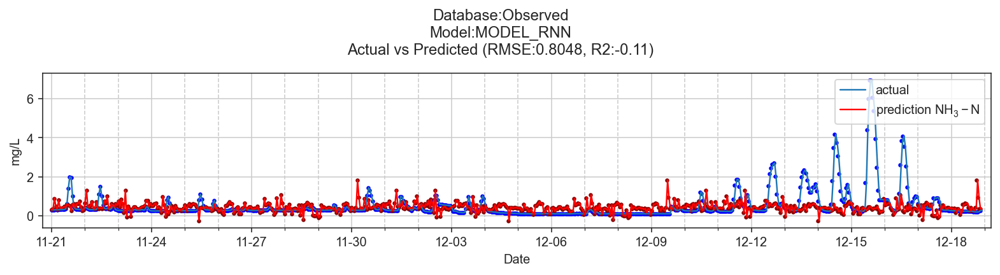

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


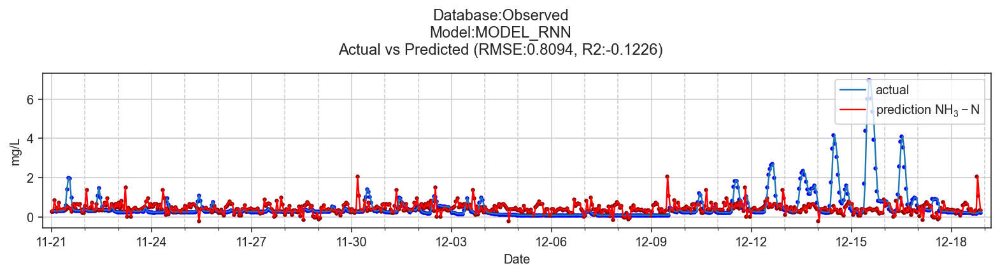

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


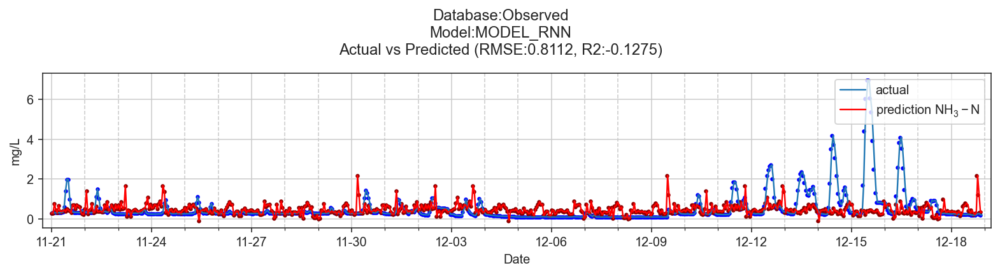

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


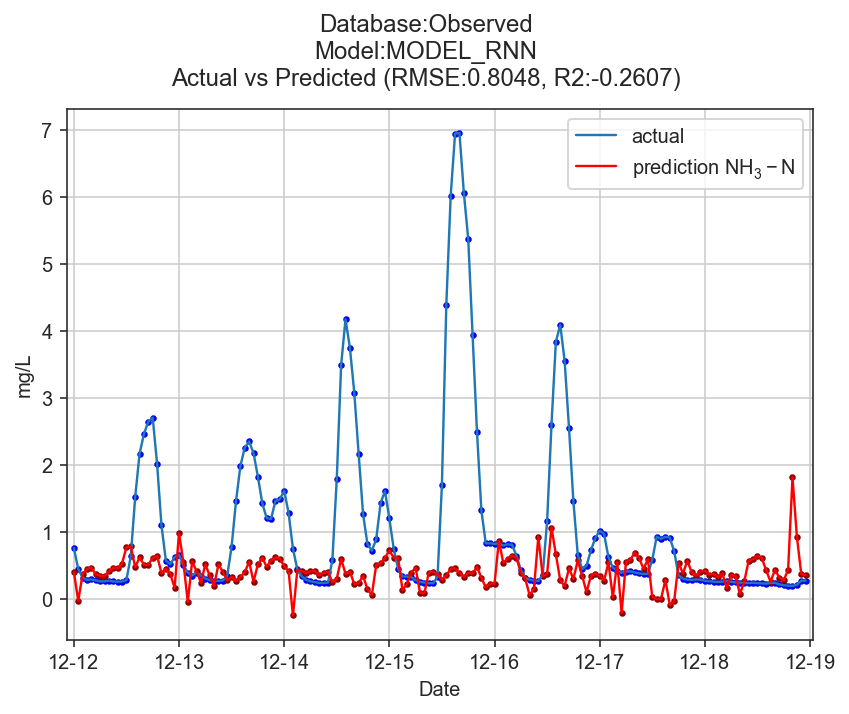

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


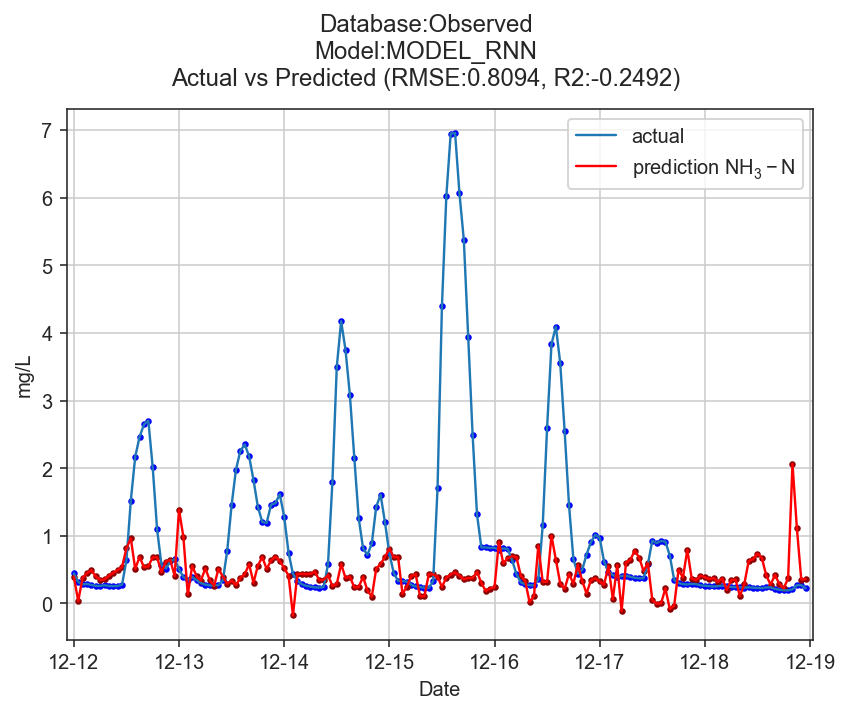

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


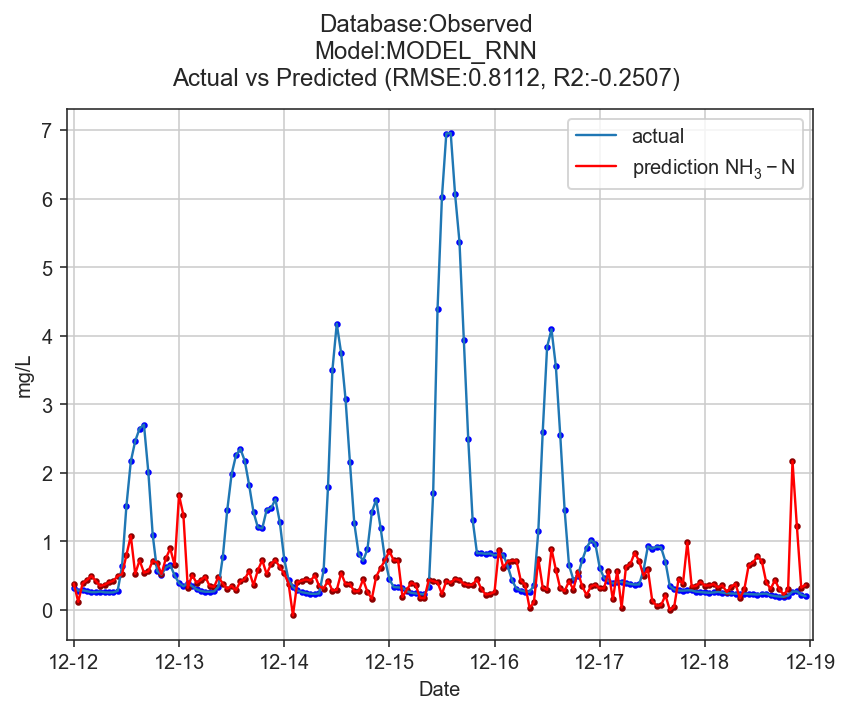

(934, 24, 1)
(670, 24, 1)
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d (MaxPooling1D) (None, 11, 64)            0         
_________________________________________________________________
flatten (Flatten)            (None, 704)               0         
_________________________________________________________________
dense_3 (Dense)              (None, 10)                7050      
_________________________________________________________________
dense_4 (Dense)              (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


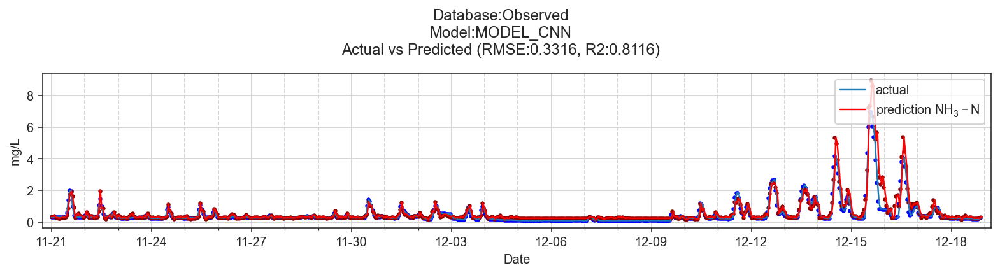

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


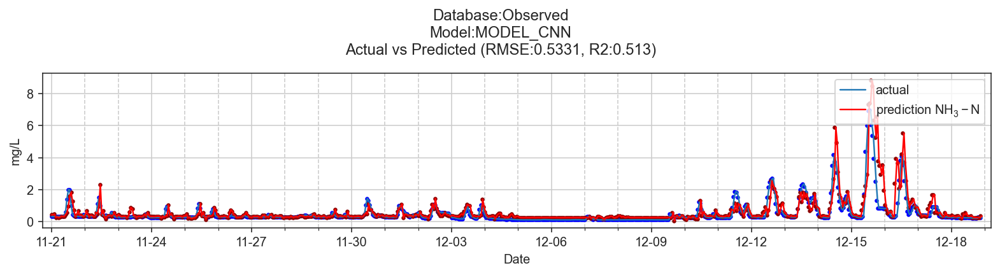

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


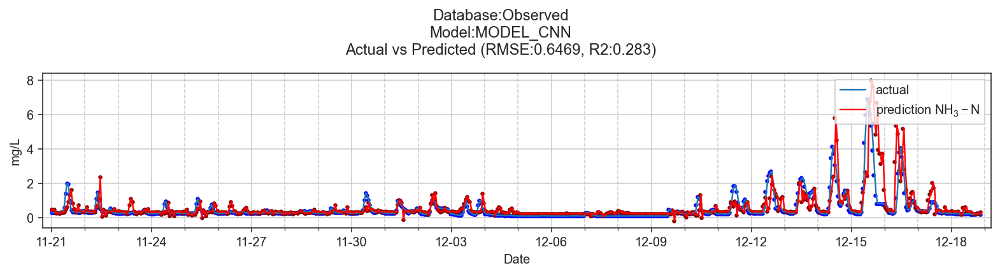

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


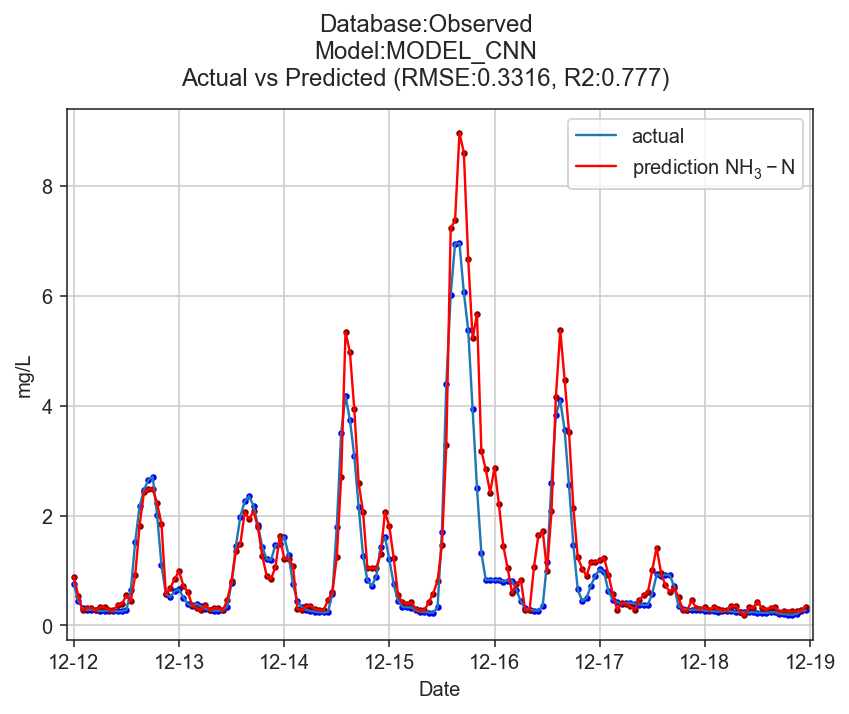

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


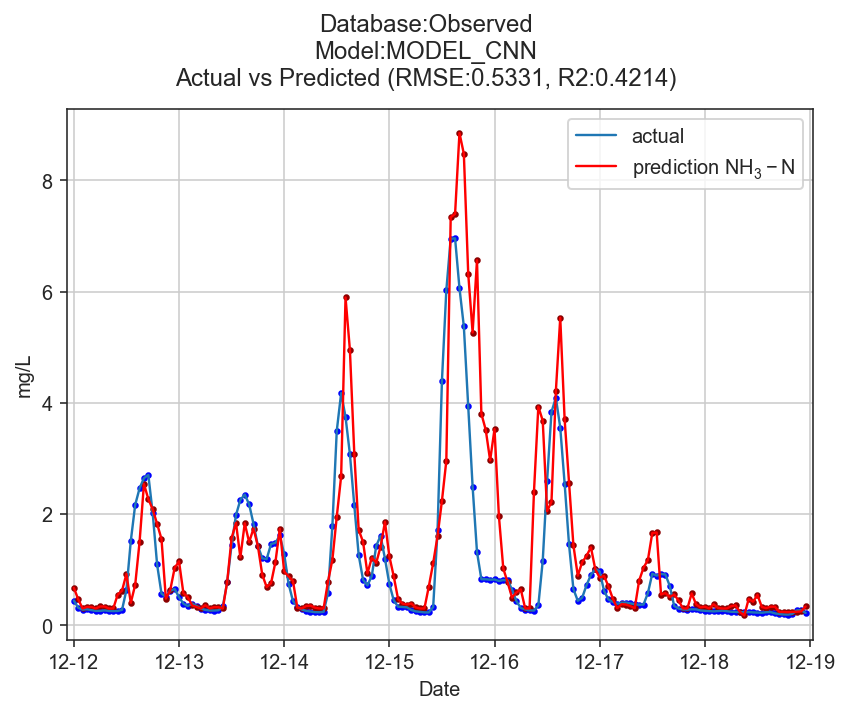

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


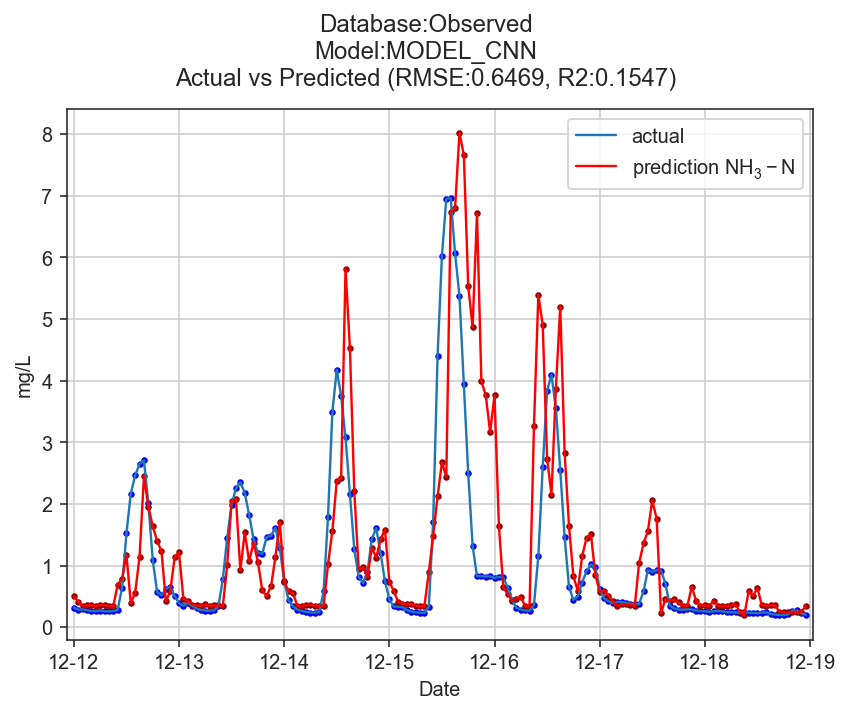

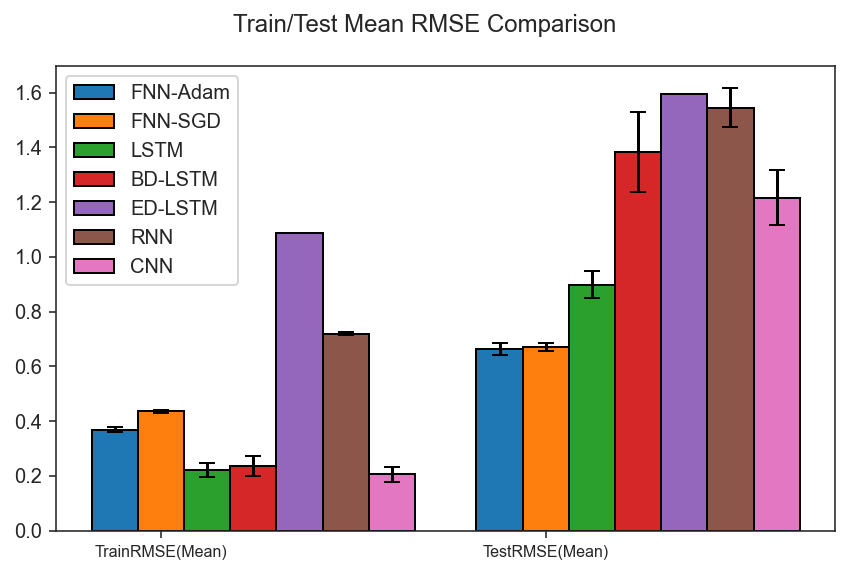

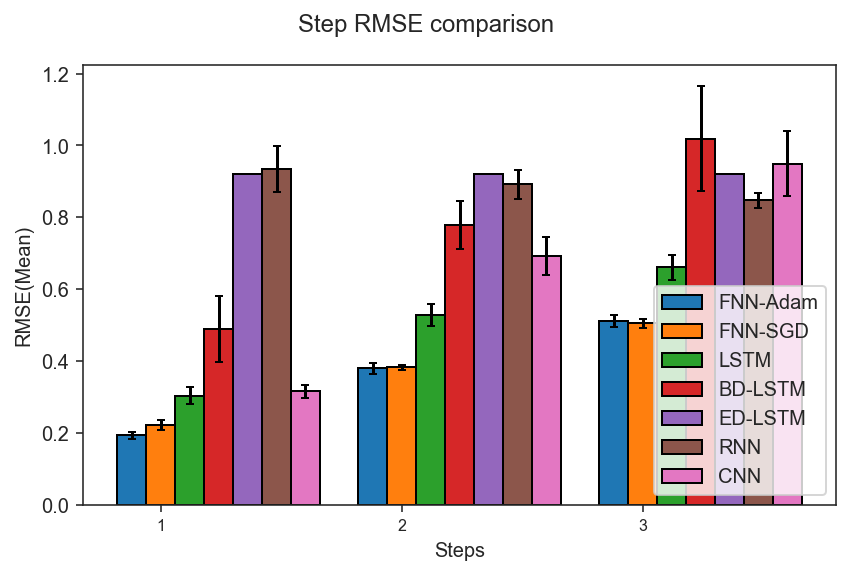

SG_1
Experiment 1 in progress
TrainRMSE_Mean 0.38910515929675565
TestRMSE_Mean 0.627815671263093
Experiment 2 in progress
TrainRMSE_Mean 0.3927853049322954
TestRMSE_Mean 0.6731092550554926
Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.3893129254101307
TestRMSE_Mean 0.6423942757215904
Experiment 4 in progress
TrainRMSE_Mean 0.42079225202812875
TestRMSE_Mean 0.6223719380883395
Experiment 5 in progress
TrainRMSE_Mean 0.3498058717373711
TestRMSE_Mean 0.6688092382661194
Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.36996395188394726
TestRMSE_Mean 0.6389657263574897
Experiment 7 in progress
TrainRMSE_Mean 0.404061125887098
TestRMSE_Mean 0.6493542777455984
Experiment 8 in progress
TrainRMSE_Mean 0.40122397786369174
TestRMSE_Mean 0.6970703819597653
Experiment 9 in progress
TrainRMSE_Mean 0.3709293371605124
TestRMSE_Mean 0.6244444519995153
Experiment 10 in progress
TrainRMSE_Mean 0.38095067151897083
TestRMSE_Mean 0.6258768089161262
Total time for 10 experiments 9.233500003814697
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.38911   0.62782  0.18151  0.35789  0.48283
Exp2     0.39279   0.67311  0.23953  0.39623  0.48857
Exp3     0.38931   0.64239  0.20832  0.37413  0.47885
Exp4     0.42079   0.62237  0.17211  0.34250  0.49032
Exp5     0.34981   0.66881  0.18490  0.38740  0.51287
Exp6     0.36996   0.63897  0.19750  0.36210  0.48801
Exp7     0.40406   0.64935  0.19950  0.38542  0.48302
Exp8     0.40122   0.69707  0.24315  0.39328  0.52165
Exp9     0.37

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


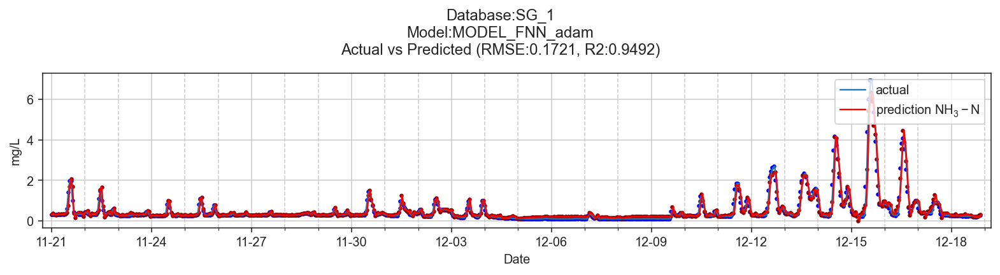

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


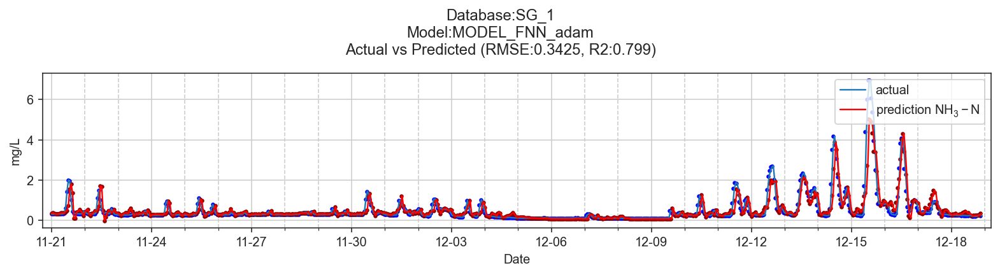

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


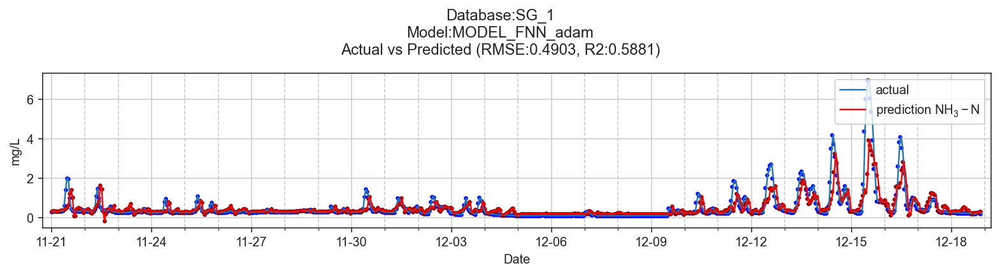

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


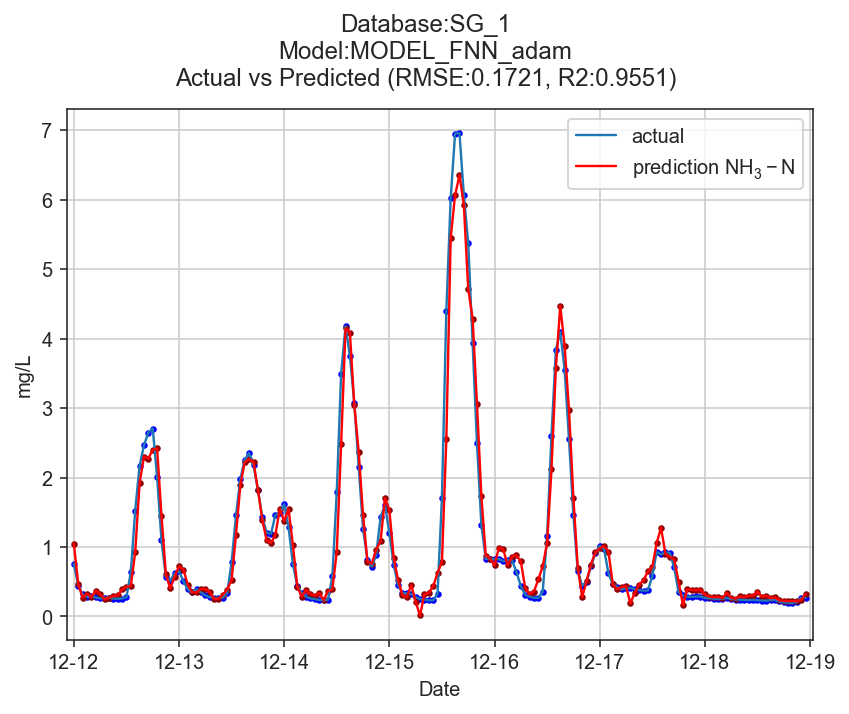

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


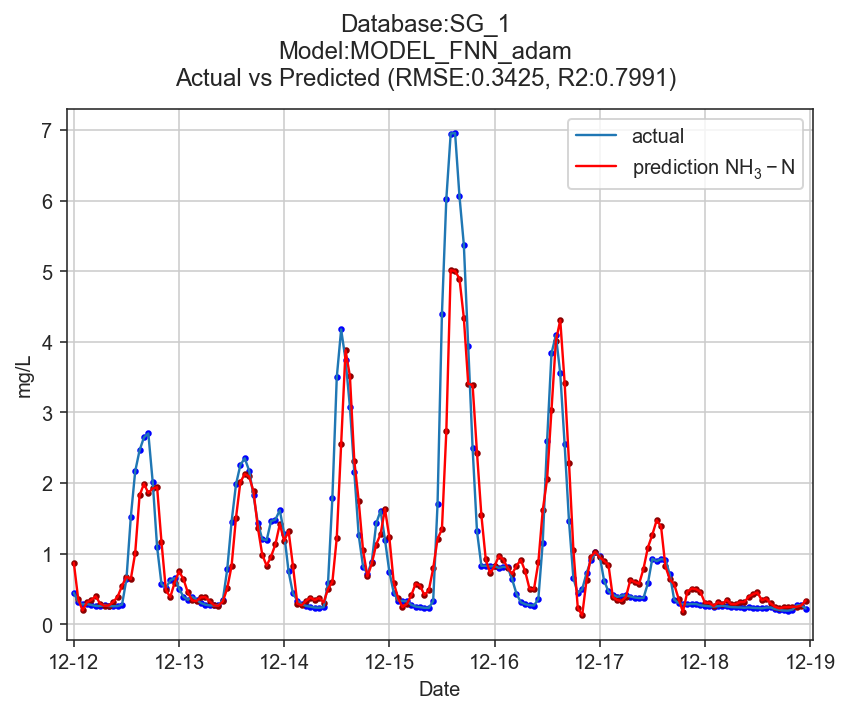

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


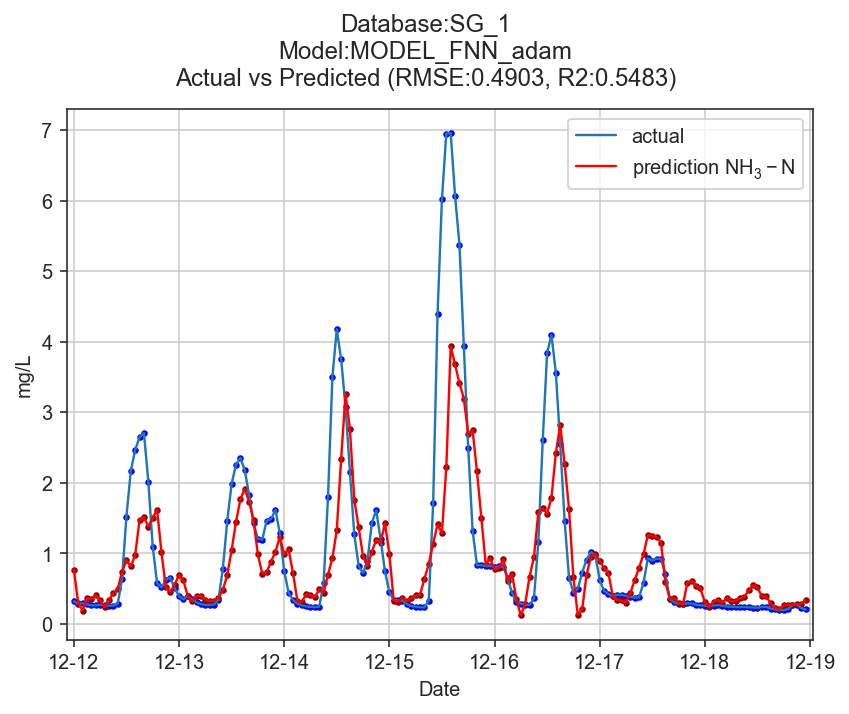

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 11.198772668838501
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.43126   0.64165  0.20206  0.37044  0.48338
Exp2     0.43320   0.66260  0.24104  0.37033  0.49375
Exp3     0.43458   0.66691  0.21551  0.38549  0.49973
Exp4     0.43952   0.66877  0.22173  0.37459  0.50772
Exp5     0.43089   0.69028  0.23300  0.39863  0.51311
Exp6     0.43198   0.64925  0.22056  0.36326  0.49084
Exp7     0.40359   0.65272  0.19884  0.36826  0.50090
Exp8     0.44218   0.68277  0.24266  0.38008  0.51267
Exp9     0.42267   0.63468  0.20104  0.37013  0.47477
Exp10    0.43553   0.64186  0.20001  0.37407  0.48171
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.43054             0.01027  0.42417  0.43691  0.40359  0.44218
TestRMSE   0.65915             0.01742  0.64835  0.66995  0.63468  0.69028
Step1      0.21764             0.01619  0.20761  0.22768  0.19884  0.24266
Step2      0.37553             0.00971  0.3

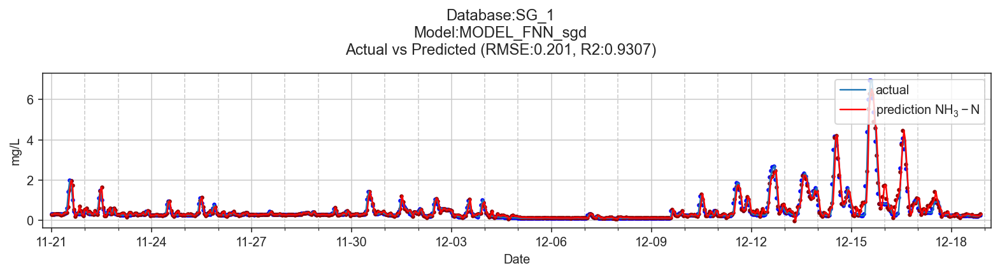

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


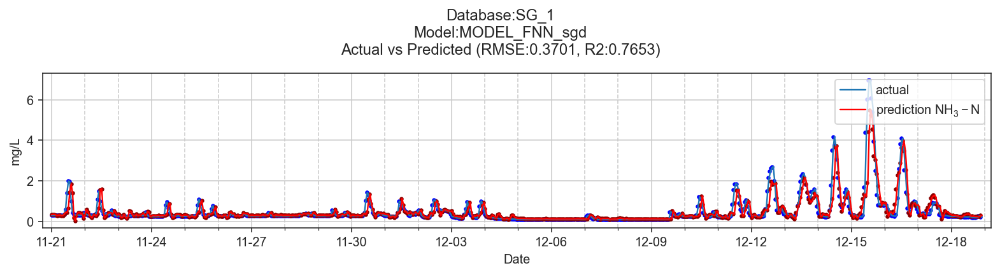

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


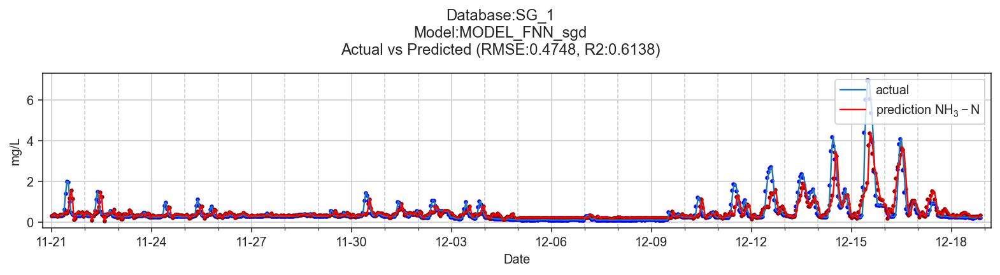

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


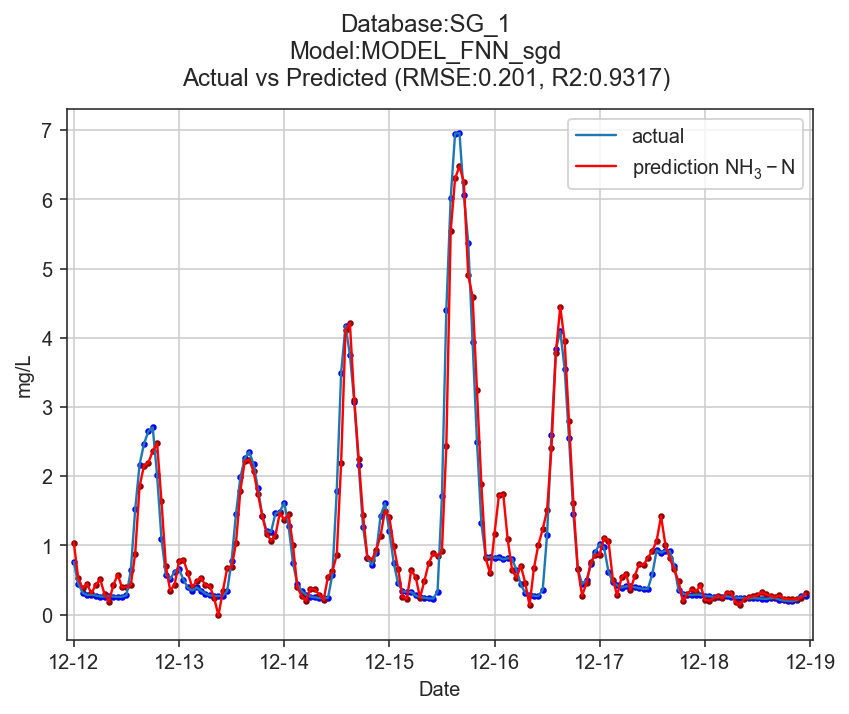

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


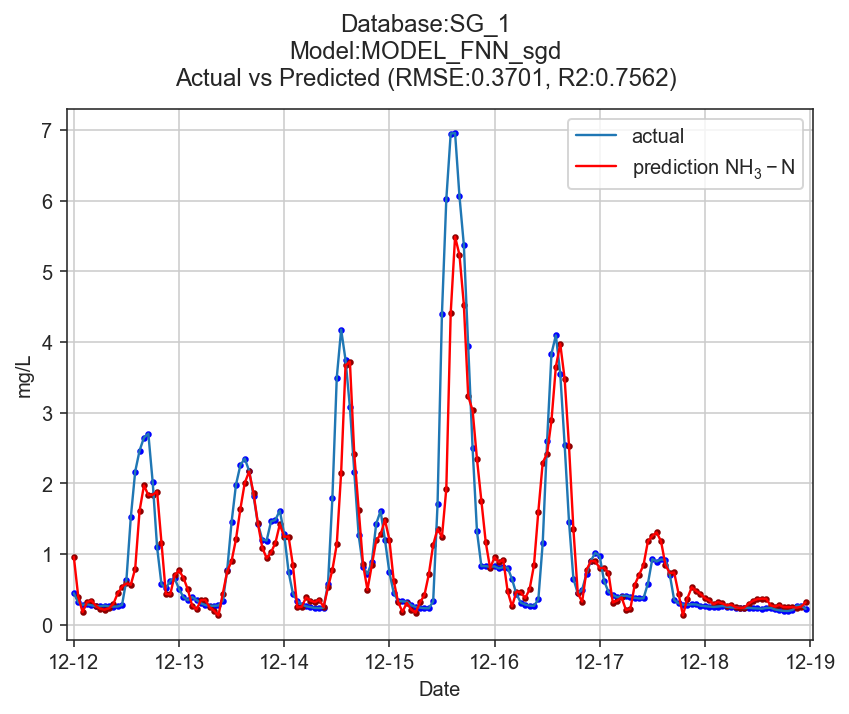

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


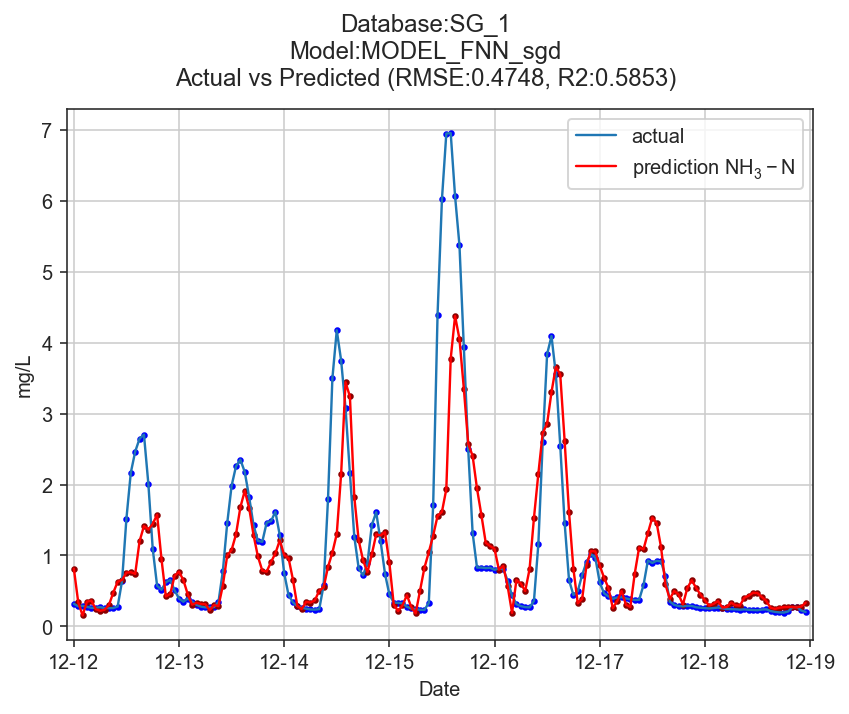

(934, 24, 1)
(670, 24, 1)
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, 10)                480       
_________________________________________________________________
dense_5 (Dense)              (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 362.11714267730713
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.37326   0.75555  0.26805  0.43803  0.55420
Exp2     0.35598   0.84229  0.31846  0.48757  0.60853
Exp3     0.29449   

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


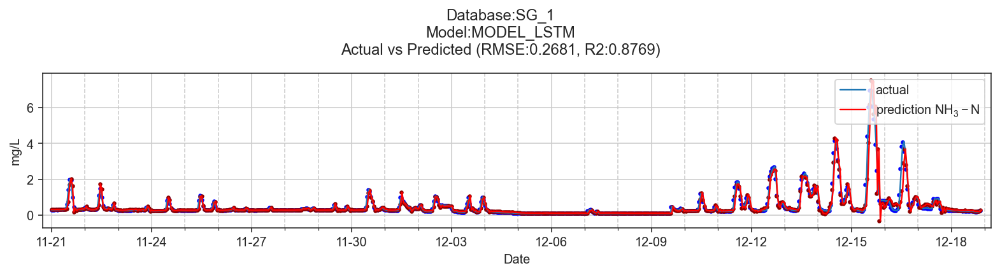

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


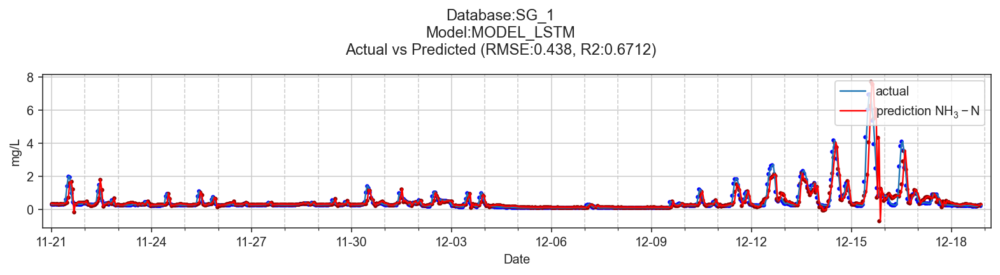

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


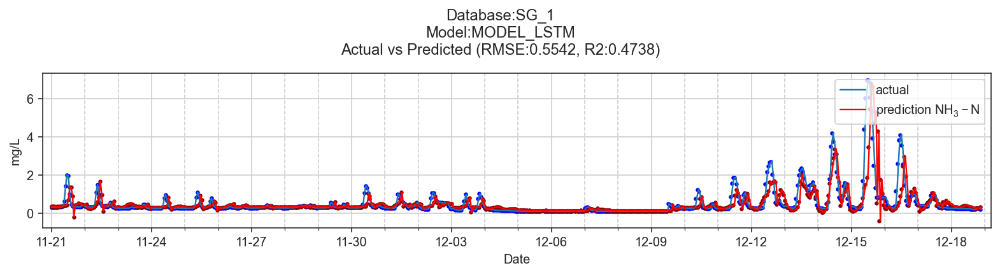

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


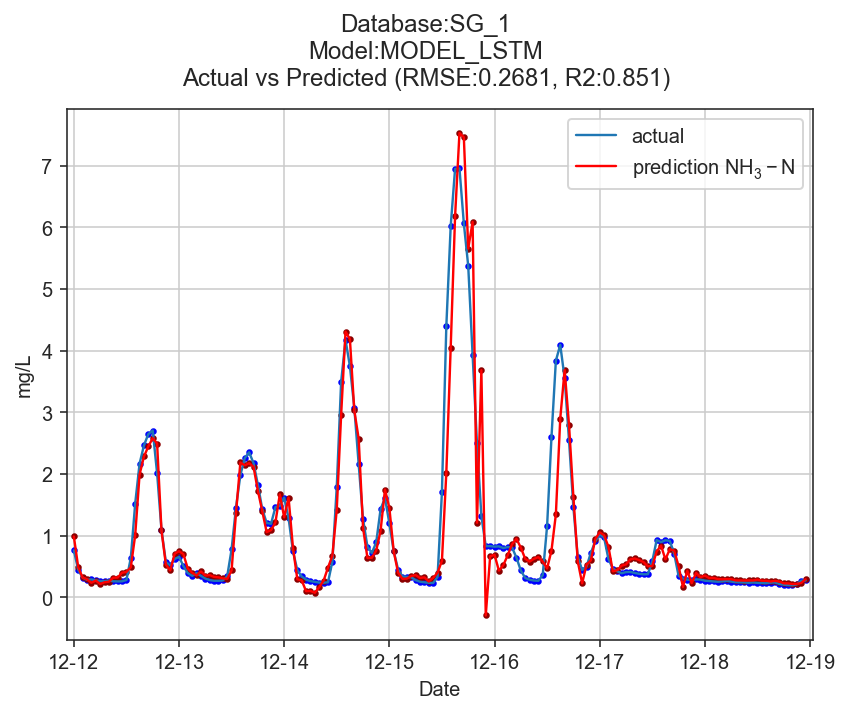

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


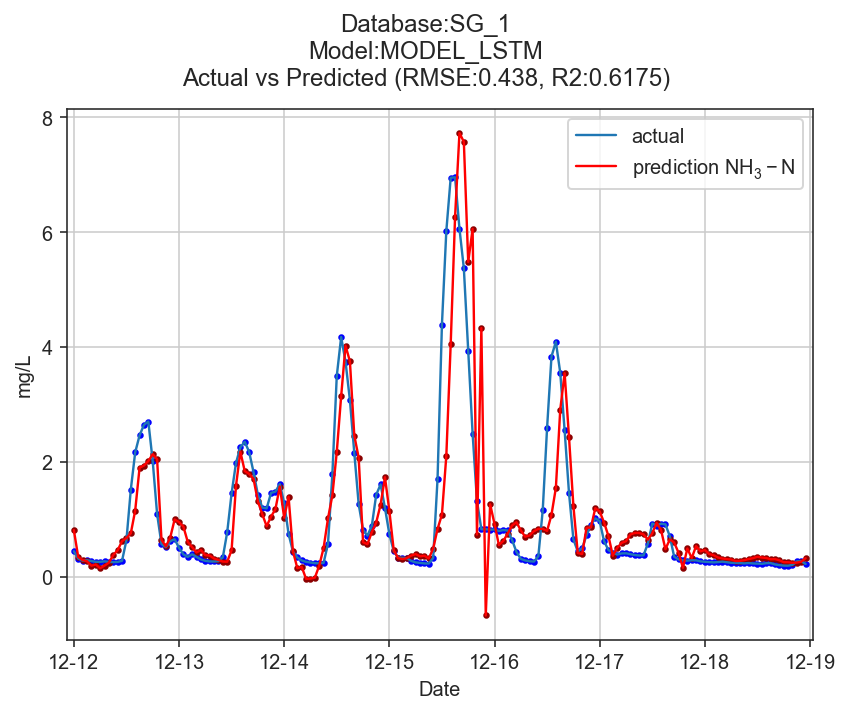

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


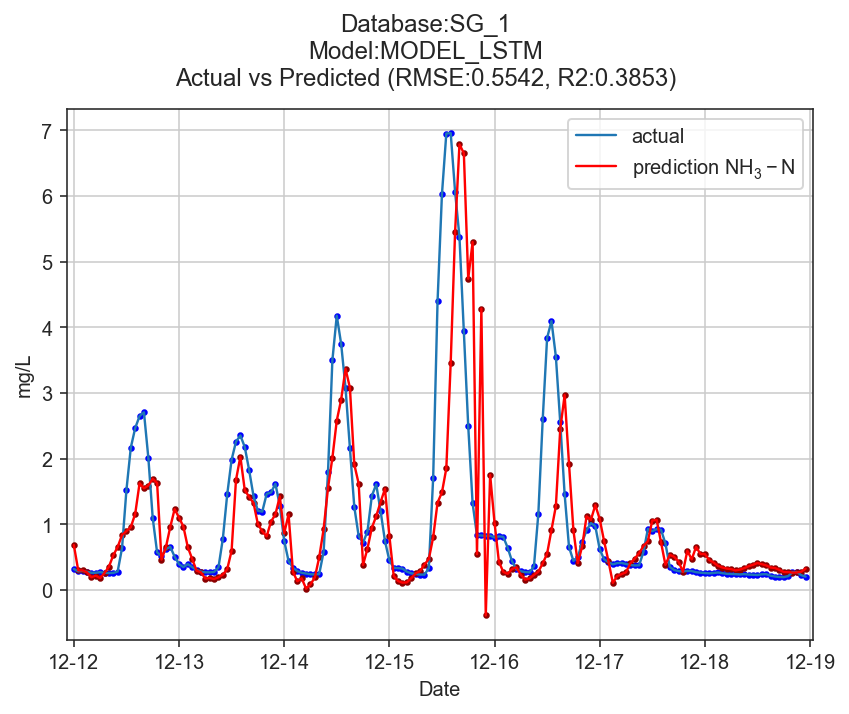

(934, 24, 1)
(670, 24, 1)
Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_1 (Bidirection (None, 20)                960       
_________________________________________________________________
dense_6 (Dense)              (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 424.2146375179291
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.39292   0.92413  0.38983  0.54898  0.63299
Exp2     0.33217   0.92811  0.39442  0.55924  0.62696
Exp3     0.26

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


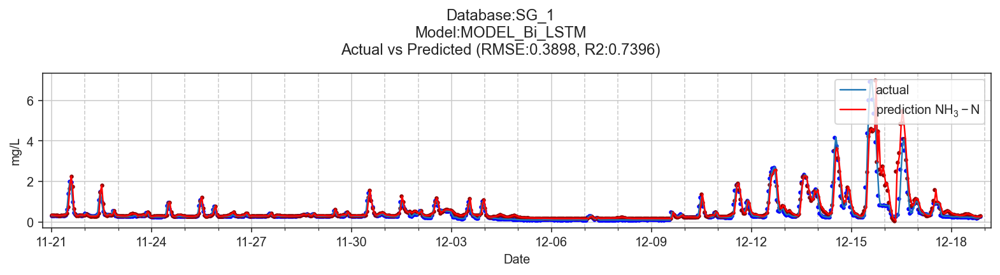

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


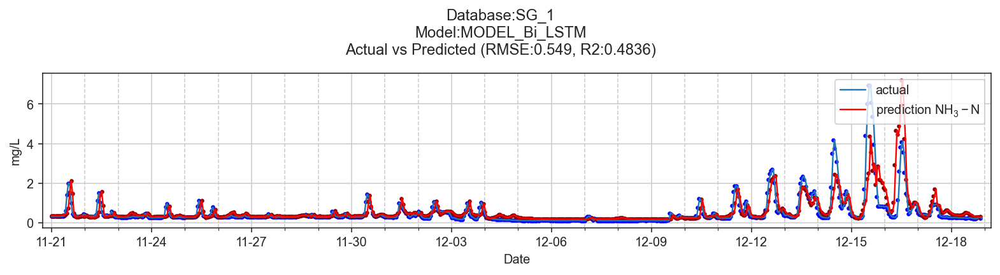

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


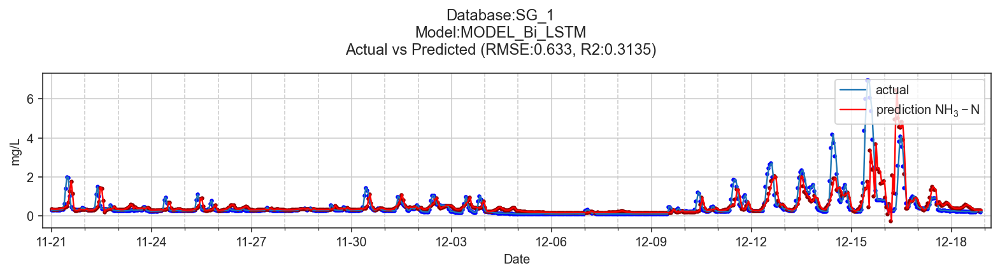

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


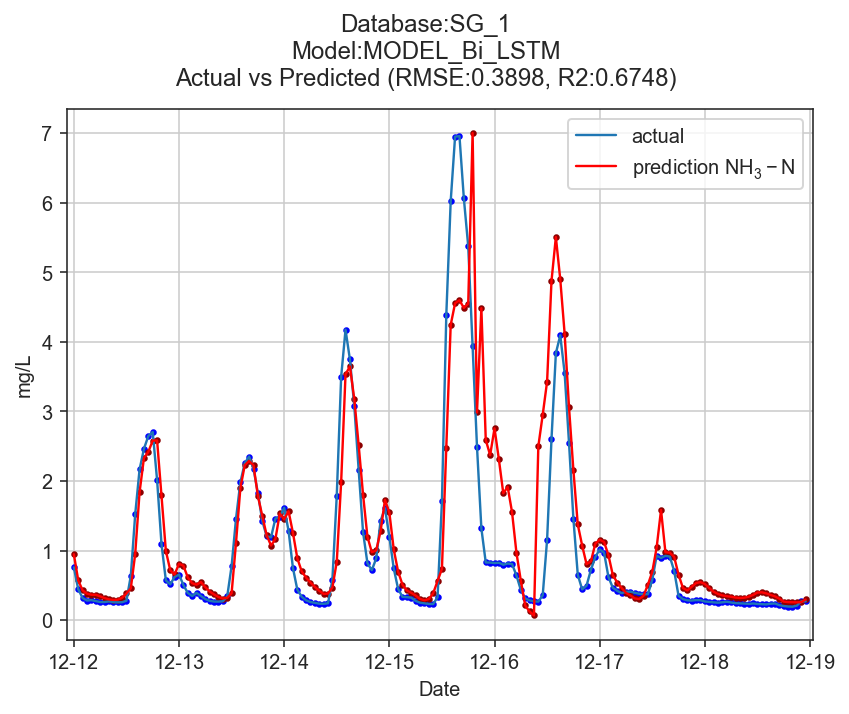

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


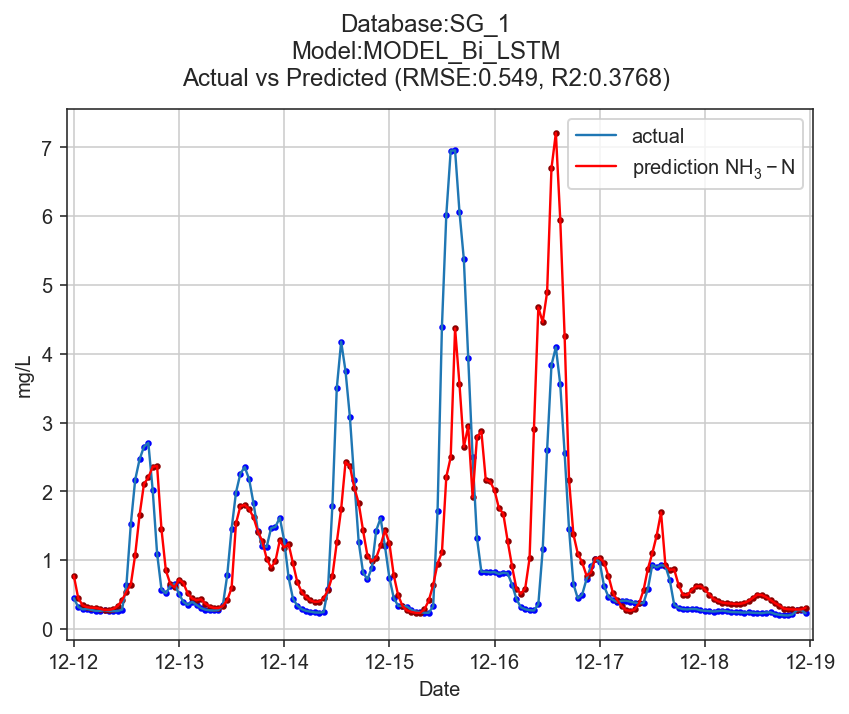

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


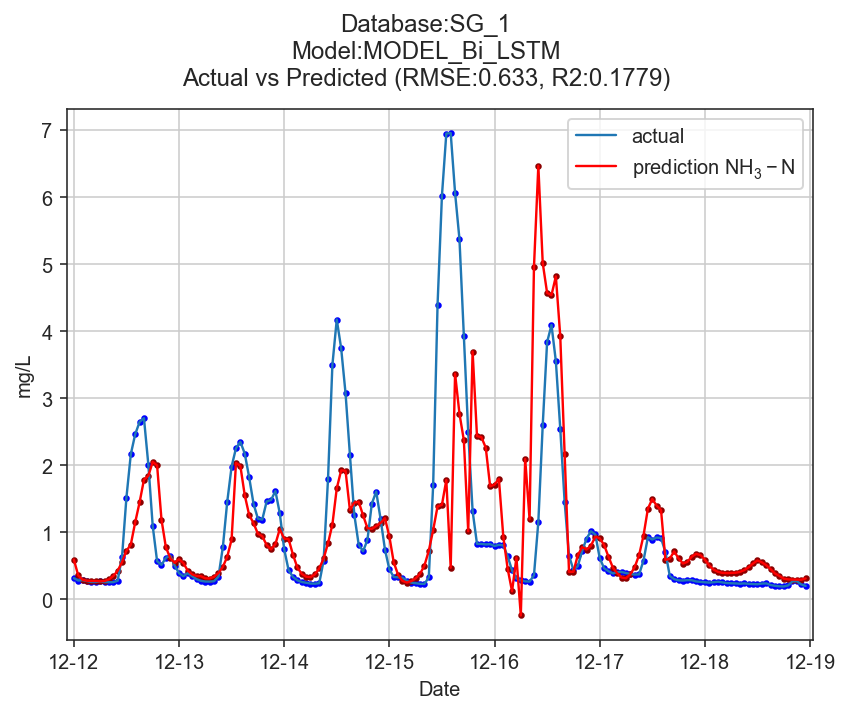

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 10)                480       
_________________________________________________________________
repeat_vector_1 (RepeatVecto (None, 3, 10)             0         
_________________________________________________________________
lstm_7 (LSTM)                (None, 3, 10)             840       
_________________________________________________________________
time_distributed_1 (TimeDist (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress


C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


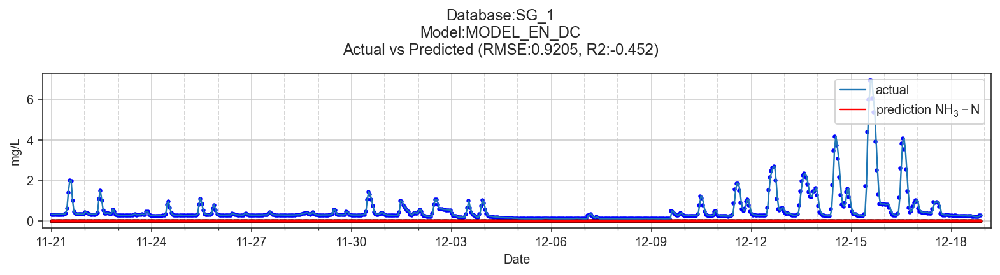

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


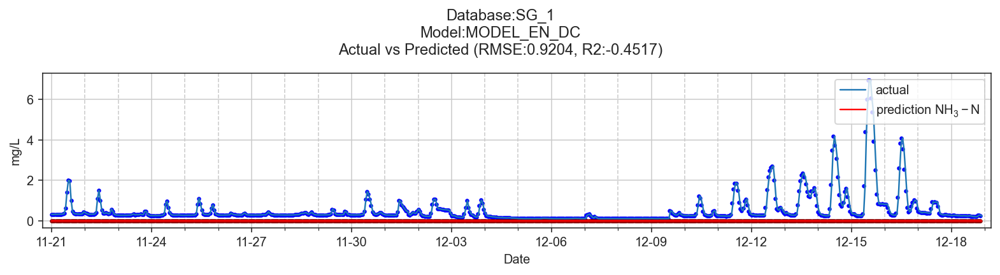

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


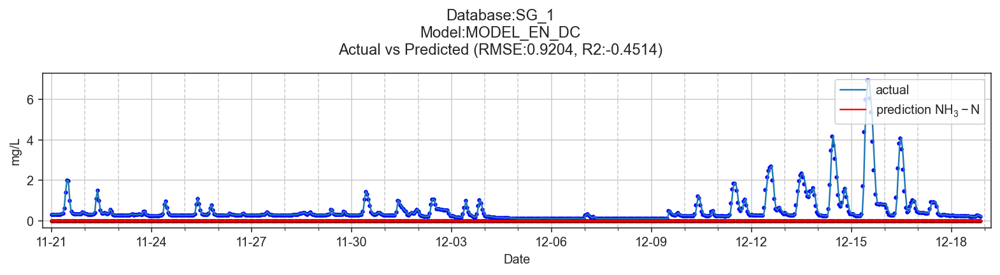

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


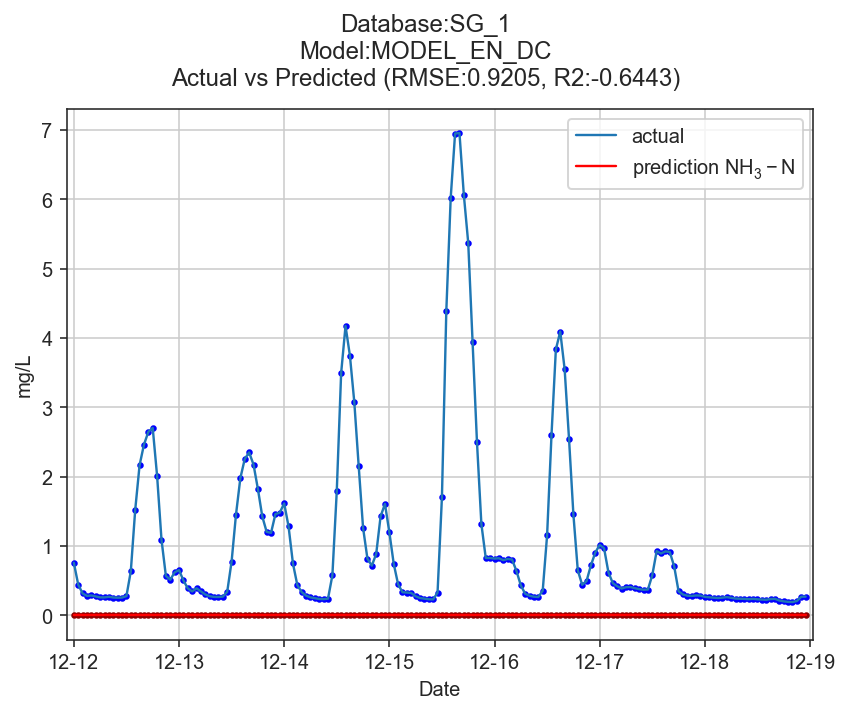

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


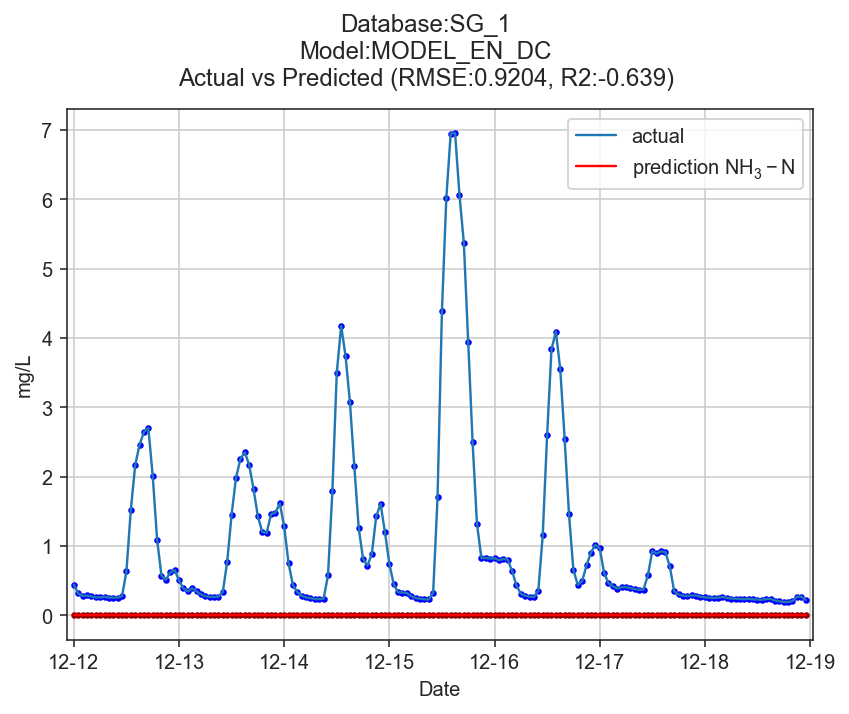

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


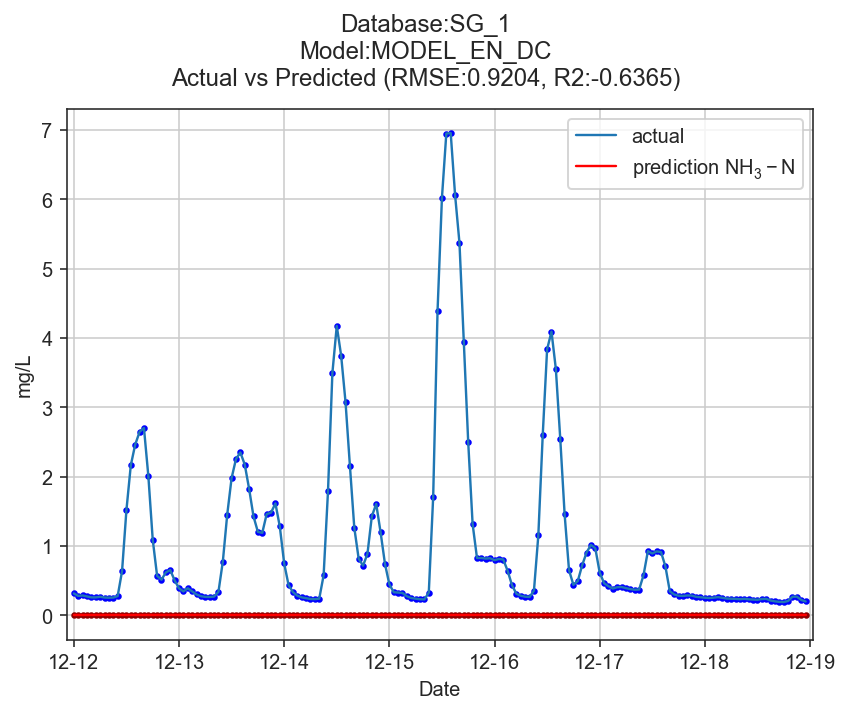

Experiment 1 in progress
TrainRMSE_Mean 0.7094289786014019
TestRMSE_Mean 2.041100403233857
Experiment 2 in progress
TrainRMSE_Mean 0.7282530978955977
TestRMSE_Mean 1.4228504726528932
Experiment 3 in progress
TrainRMSE_Mean 0.7163556545103744
TestRMSE_Mean 1.7690501778581926
Experiment 4 in progress
TrainRMSE_Mean 0.7253972390484142
TestRMSE_Mean 1.508326033947025
Experiment 5 in progress
TrainRMSE_Mean 0.7160725312349262
TestRMSE_Mean 1.6148630680618647
Experiment 6 in progress
TrainRMSE_Mean 0.7043652346296501
TestRMSE_Mean 1.789750383071413
Experiment 7 in progress
TrainRMSE_Mean 0.7437392225028706
TestRMSE_Mean 1.4694834192930208
Experiment 8 in progress
TrainRMSE_Mean 0.7242766856775023
TestRMSE_Mean 1.4347606525516676
Experiment 9 in progress
TrainRMSE_Mean 0.7138711854209792
TestRMSE_Mean 1.6326577078278206
Experiment 10 in progress
TrainRMSE_Mean 0.7206907740335998
TestRMSE_Mean 1.5787320919033443
Total time for 10 experiments 1898.7108764648438
MODEL_RNN
       TrainRMSE  TestR

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


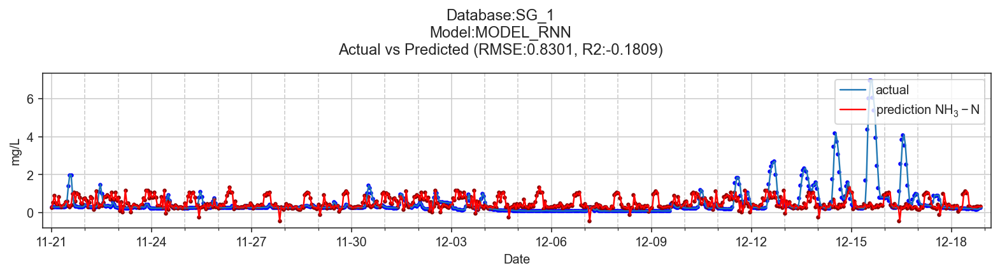

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


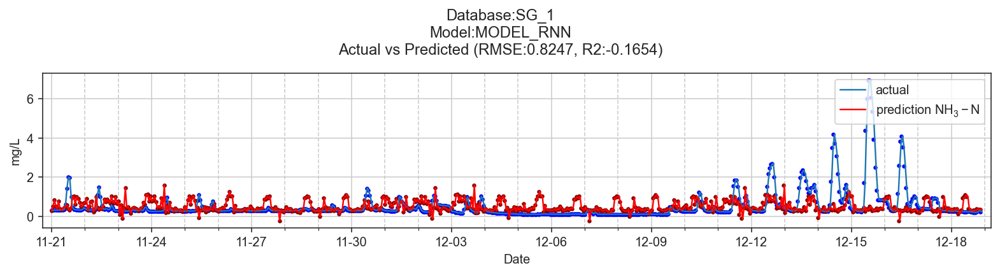

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


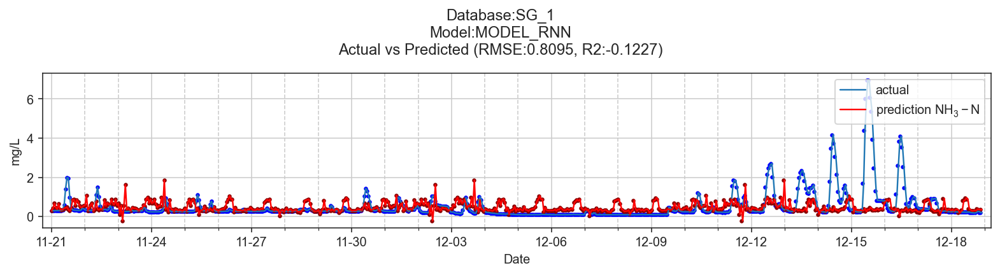

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


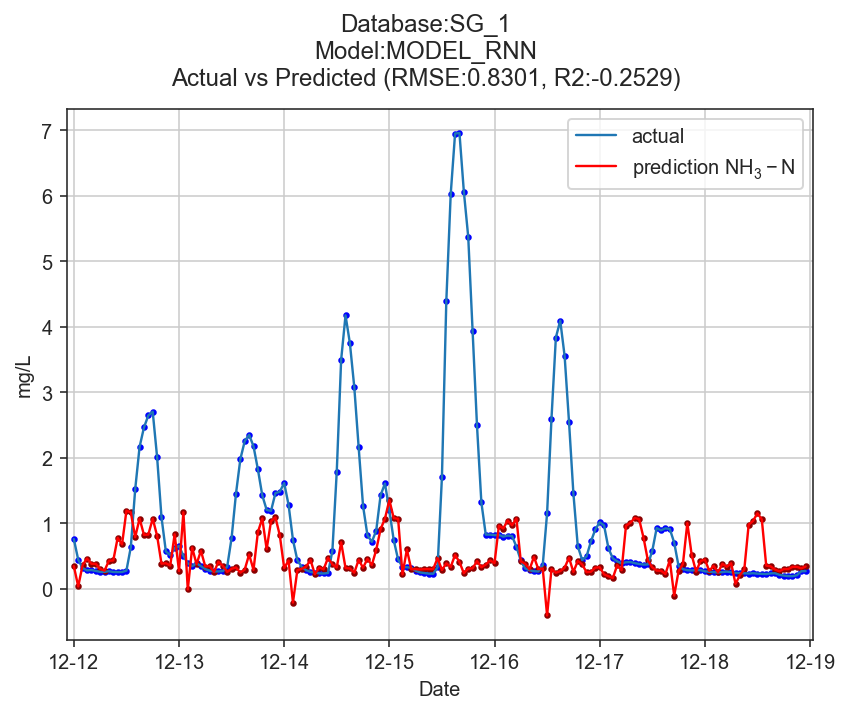

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


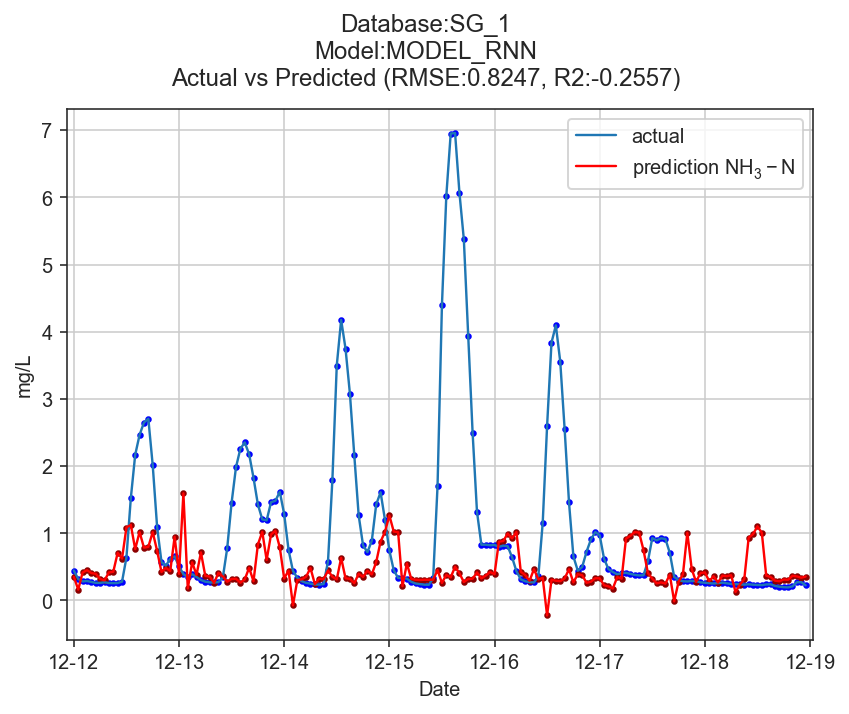

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


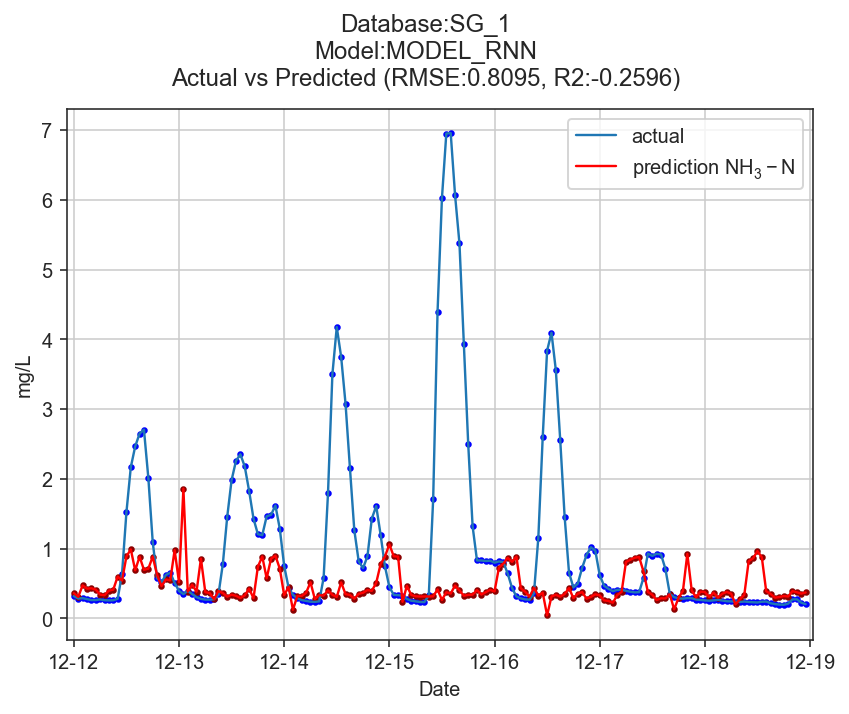

(934, 24, 1)
(670, 24, 1)
Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_1 (Conv1D)            (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d_1 (MaxPooling1 (None, 11, 64)            0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 704)               0         
_________________________________________________________________
dense_8 (Dense)              (None, 10)                7050      
_________________________________________________________________
dense_9 (Dense)              (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


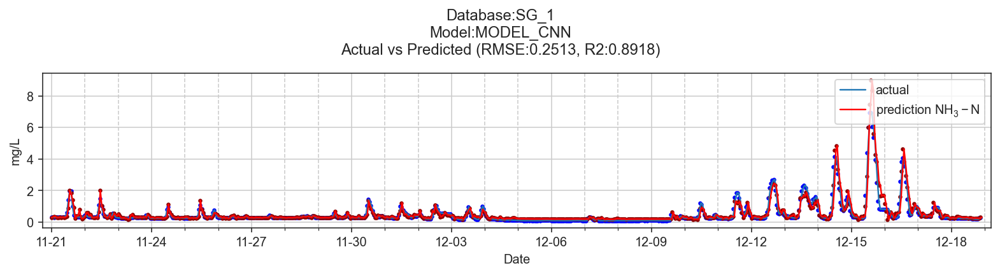

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


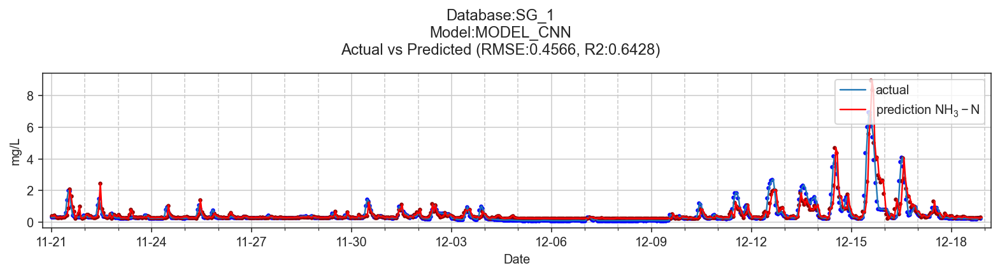

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


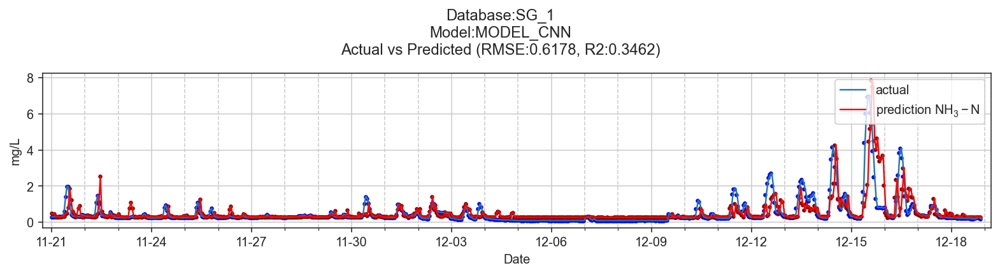

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


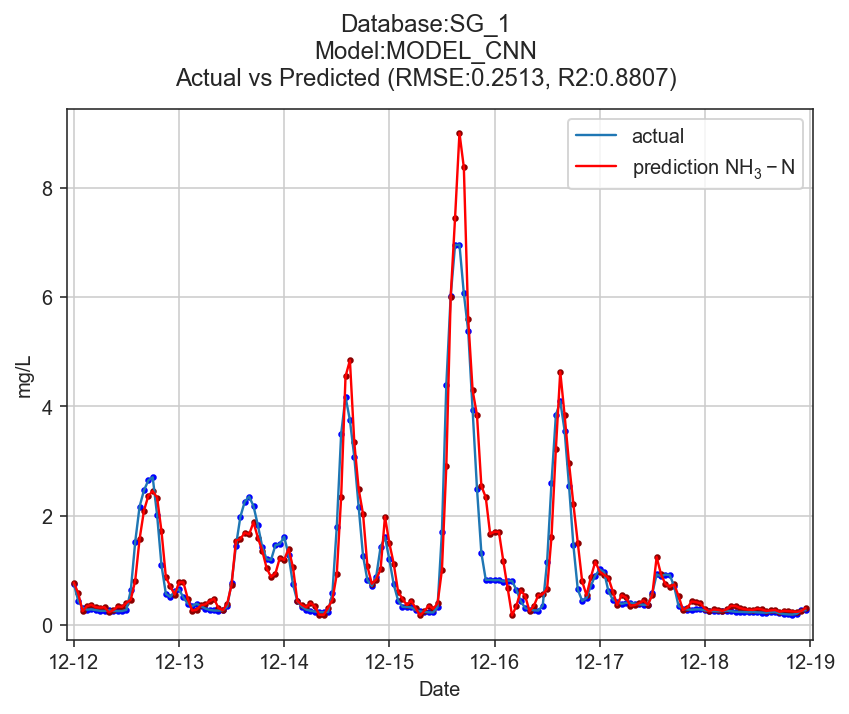

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


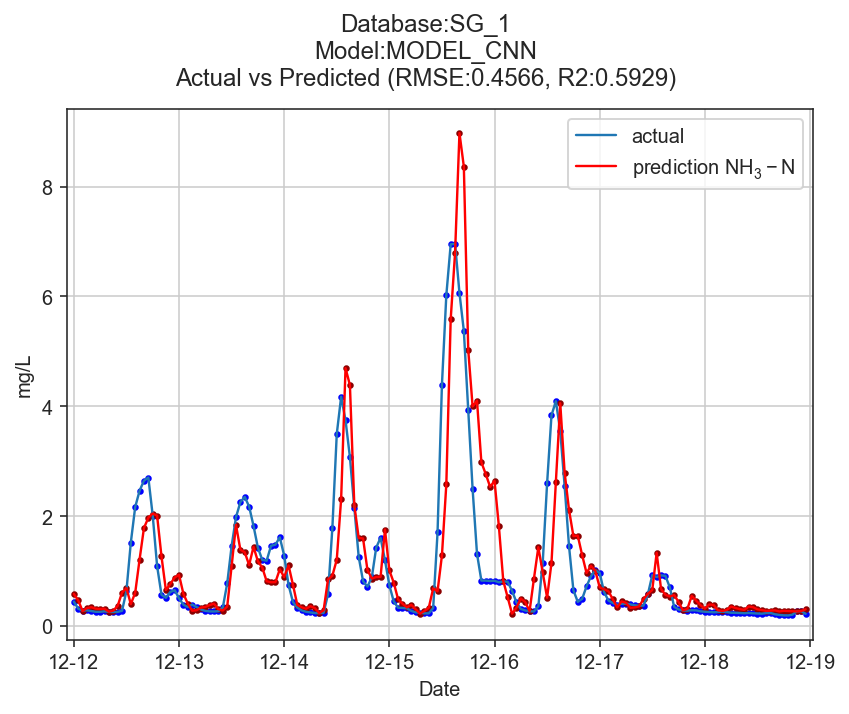

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


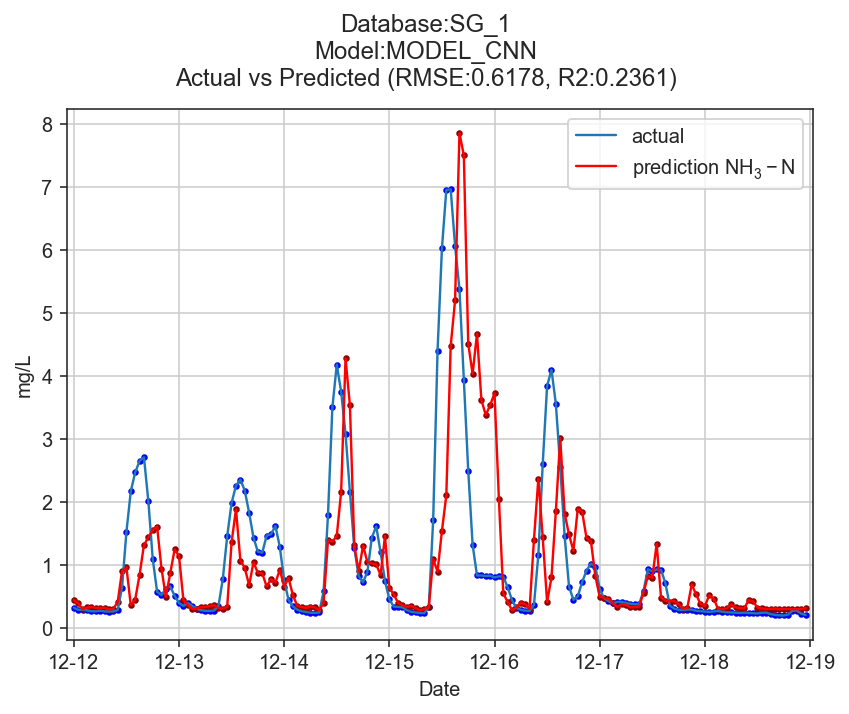

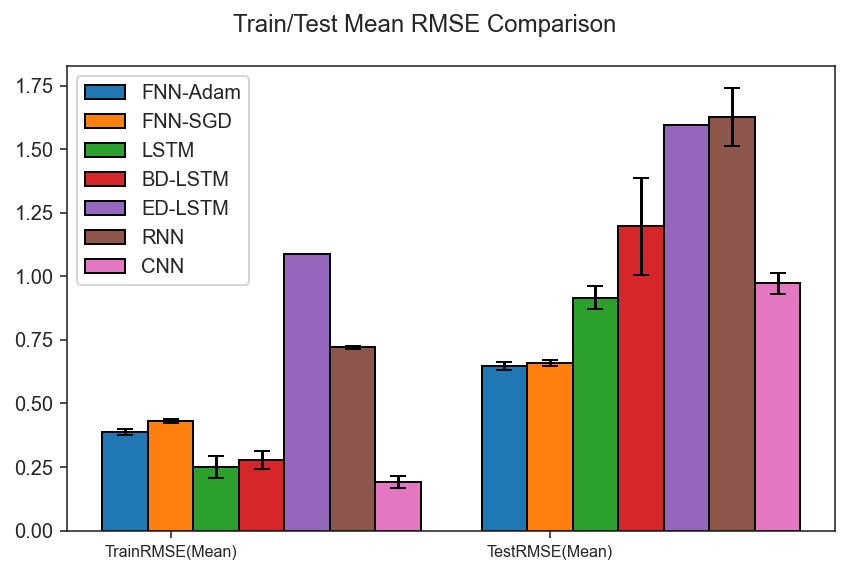

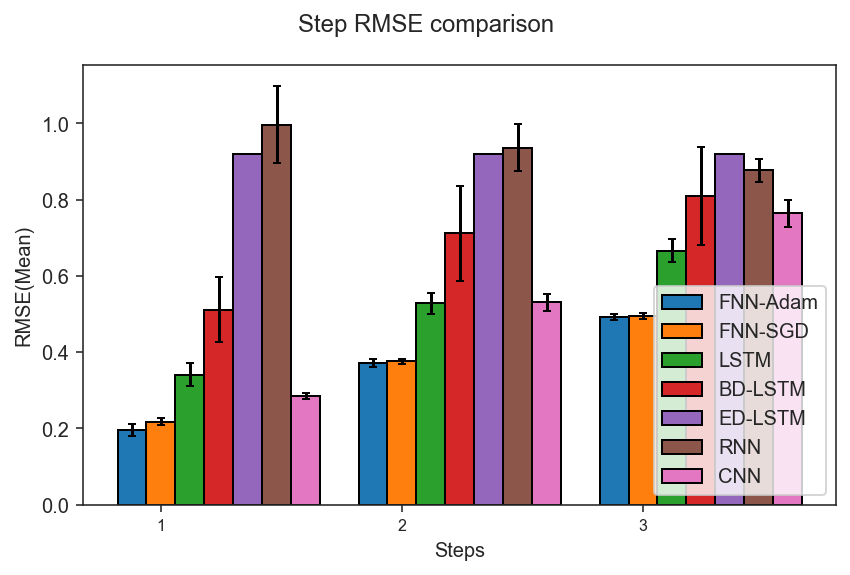

SG_2
Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.3418570211014276
TestRMSE_Mean 0.6144679469313212
Experiment 2 in progress
TrainRMSE_Mean 0.346817067501985
TestRMSE_Mean 0.685180455635178
Experiment 3 in progress
TrainRMSE_Mean 0.3690713753366829
TestRMSE_Mean 0.6105241474715387
Experiment 4 in progress
TrainRMSE_Mean 0.352017218166355
TestRMSE_Mean 0.6176395904790429
Experiment 5 in progress
TrainRMSE_Mean 0.3552035744527586
TestRMSE_Mean 0.5958522815979845
Experiment 6 in progress
TrainRMSE_Mean 0.37551742406744265
TestRMSE_Mean 0.6359986391012539
Experiment 7 in progress
TrainRMSE_Mean 0.329950732697459
TestRMSE_Mean 0.703479682693994
Experiment 8 in progress
TrainRMSE_Mean 0.38113059247462655
TestRMSE_Mean 0.6147756527294367
Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.3339990785101002
TestRMSE_Mean 0.6257784241934763
Experiment 10 in progress
TrainRMSE_Mean 0.3542153991219648
TestRMSE_Mean 0.6155442382476805
Total time for 10 experiments 11.071433305740356
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.34186   0.61447  0.20237  0.34040  0.46983
Exp2     0.34682   0.68518  0.19503  0.39253  0.52665
Exp3     0.36907   0.61052  0.16102  0.35628  0.46891
Exp4     0.35202   0.61764  0.20129  0.35910  0.46044
Exp5     0.35520   0.59585  0.17537  0.34047  0.45647
Exp6     0.37552   0.63600  0.20993  0.35204  0.48630
Exp7     0.32995   0.70348  0.18151  0.41156  0.54089
Exp8     0.38113   0.61478  0.17465  0.33666  0.48384
Exp9     0.33400   0.62578  0.19306  0.35900  0.47481
Exp10    0.35422   0.61554  0.19892  0.35248  0.46377
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.35398             0.01615  0.34397  0.36399  0.32995  0.38113
TestRMSE   0.63192             0

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


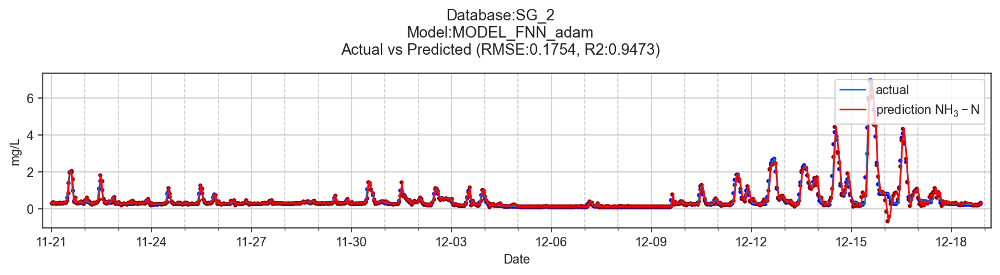

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


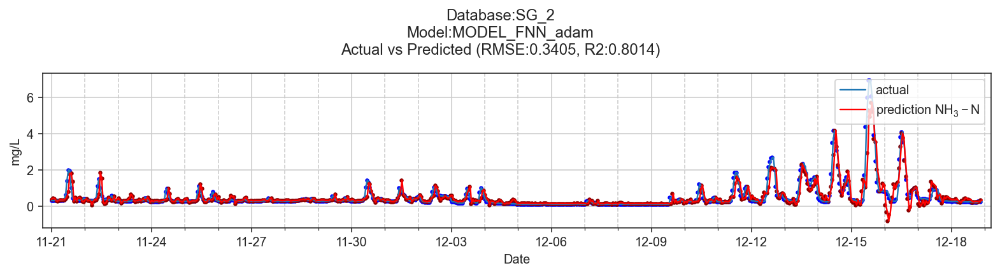

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


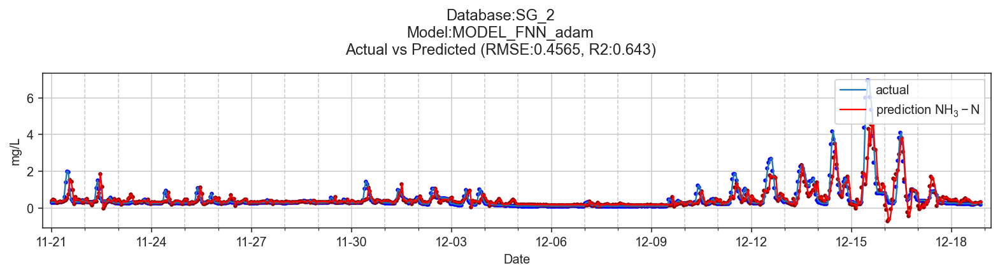

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


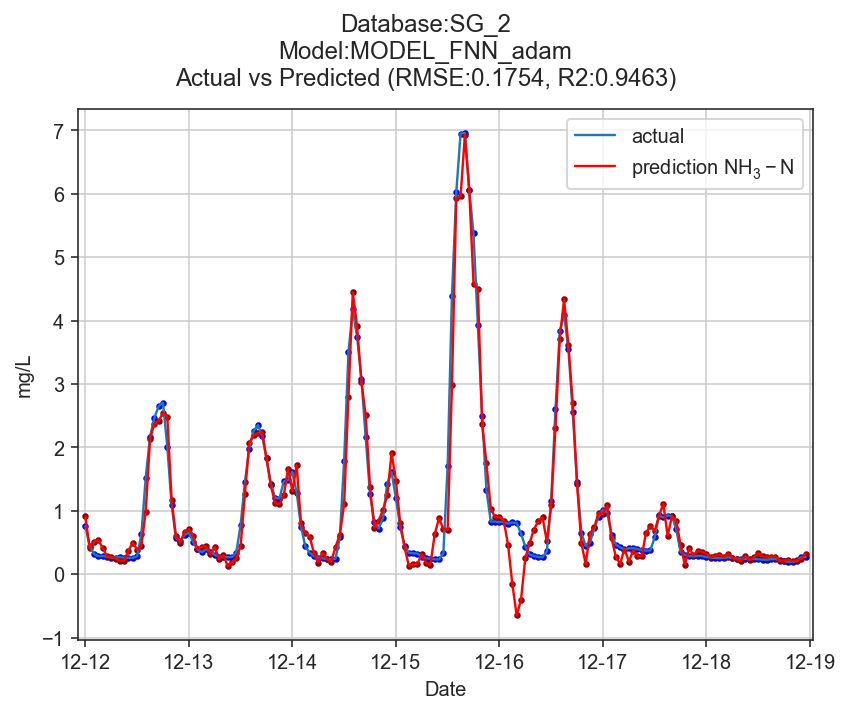

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


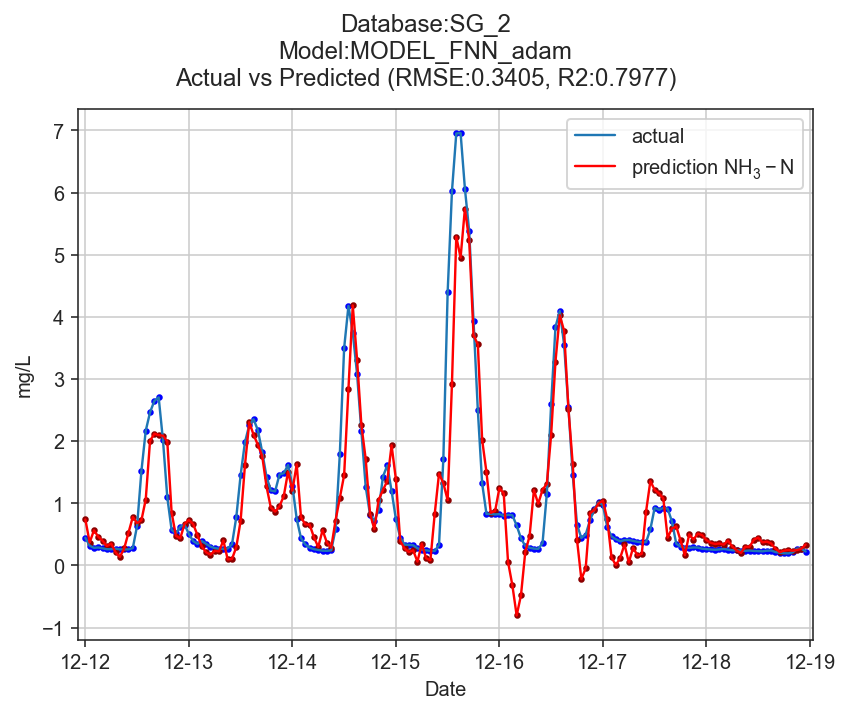

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


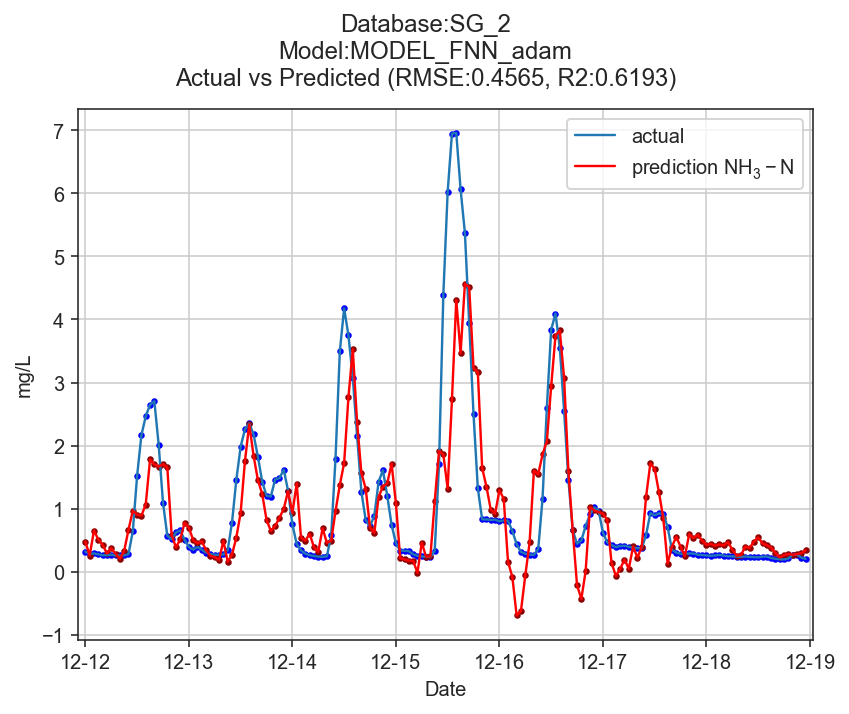

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 11.354704141616821
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.43744   0.67874  0.24049  0.38782  0.50244
Exp2     0.40740   0.65060  0.23143  0.35972  0.49023
Exp3     0.40063   0.65178  0.24732  0.37569  0.47171
Exp4     0.42372   0.63365  0.18719  0.35601  0.48962
Exp5     0.42453   0.68591  0.24489  0.40077  0.49989
Exp6     0.41931   0.68619  0.24736  0.39091  0.50681
Exp7     0.42919   0.64449  0.20051  0.37630  0.48328
Exp8     0.41675   0.64437  0.21729  0.37077  0.48012
Exp9     0.41921   0.63117  0.22041  0.35933  0.46976
Exp10    0.40792   0.65956  0.21710  0.38111  0.49258
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.41861             0.01046  0.41212  0.42510  0.40063  0.43744
TestRMSE   0.65665             0.01940  0.64462  0.66867  0.63117  0.68619
Step1      0.22540             0.01961  0.21324  0.23755  0.18719  0.24736
Step2      0.37584             0.01404  0.3

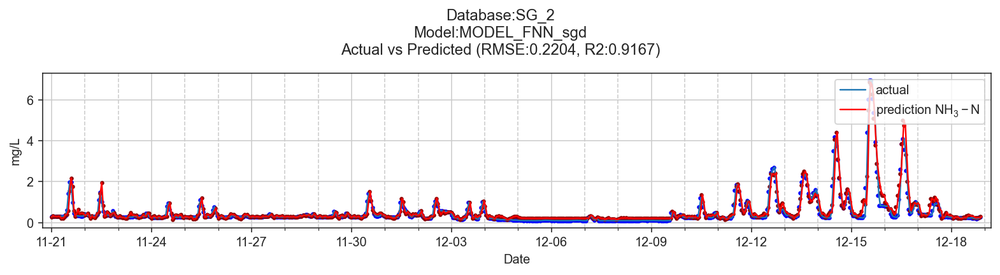

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


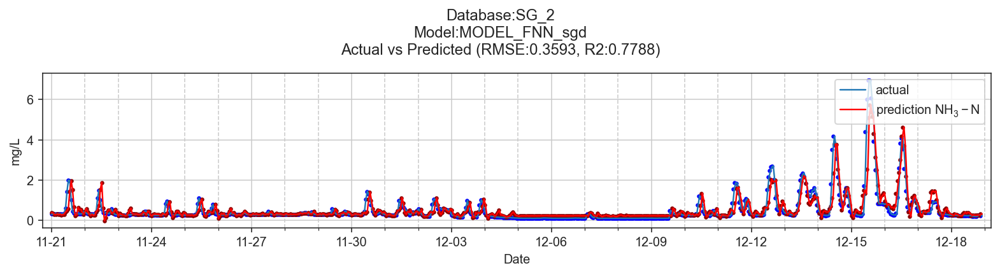

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


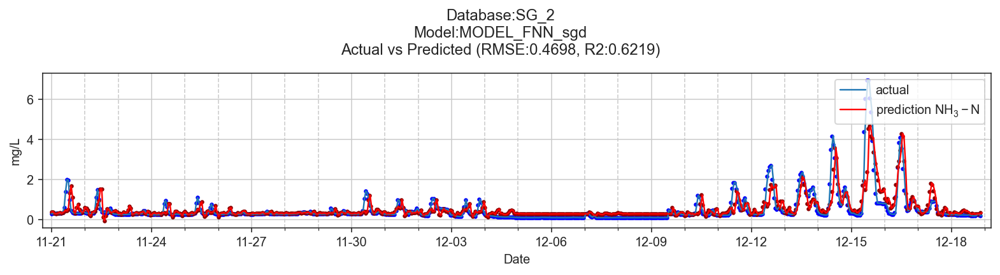

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


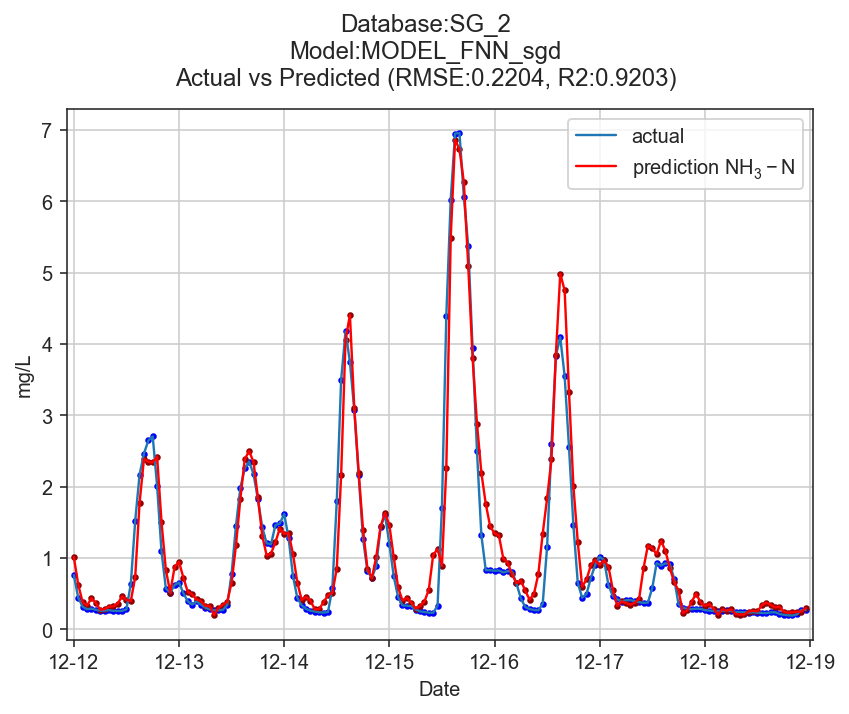

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


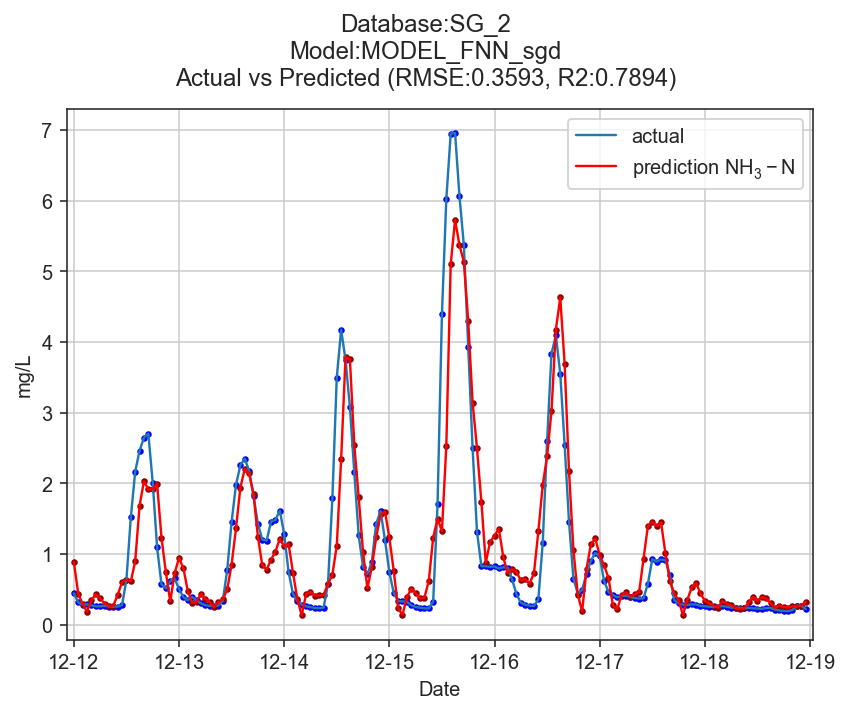

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


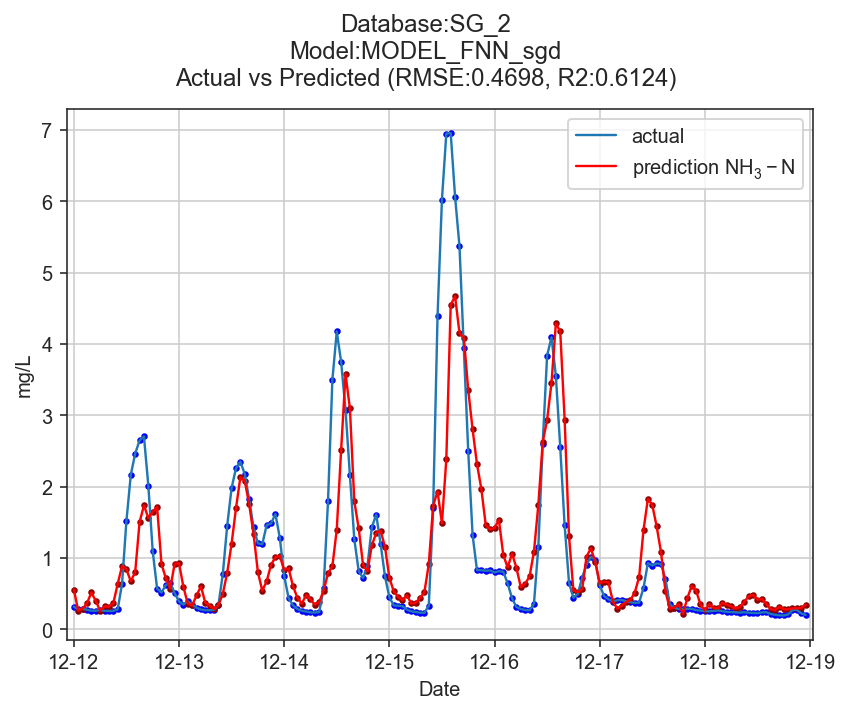

(934, 24, 1)
(670, 24, 1)
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_8 (LSTM)                (None, 10)                480       
_________________________________________________________________
dense_10 (Dense)             (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 361.55040645599365
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.32926   0.94518  0.24514  0.61122  0.67800
Exp2     0.31123   1.73239  1.00831  1.21699  0.70950
Exp3     0.30580   

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


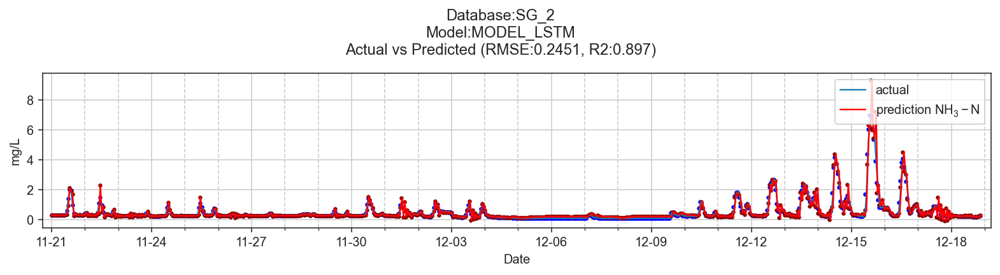

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


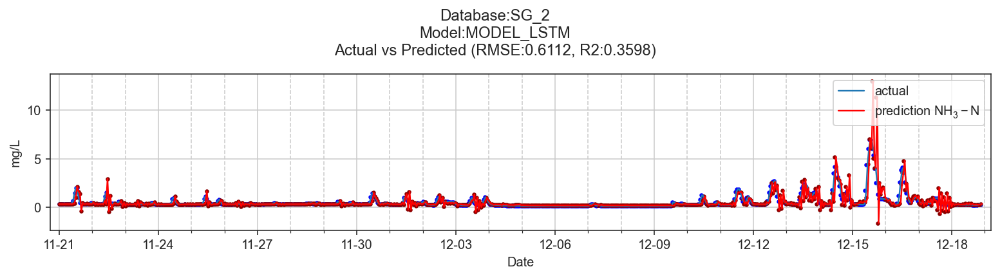

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


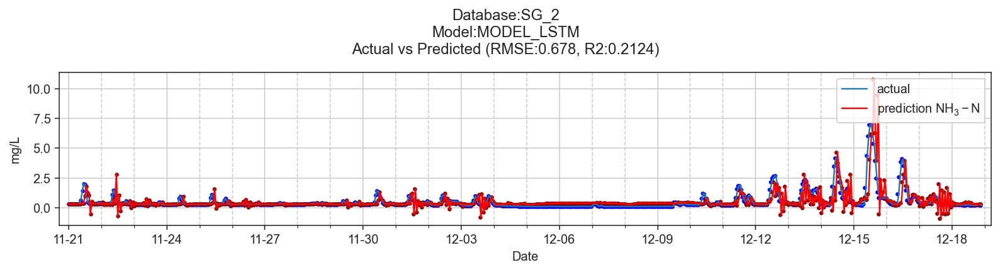

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


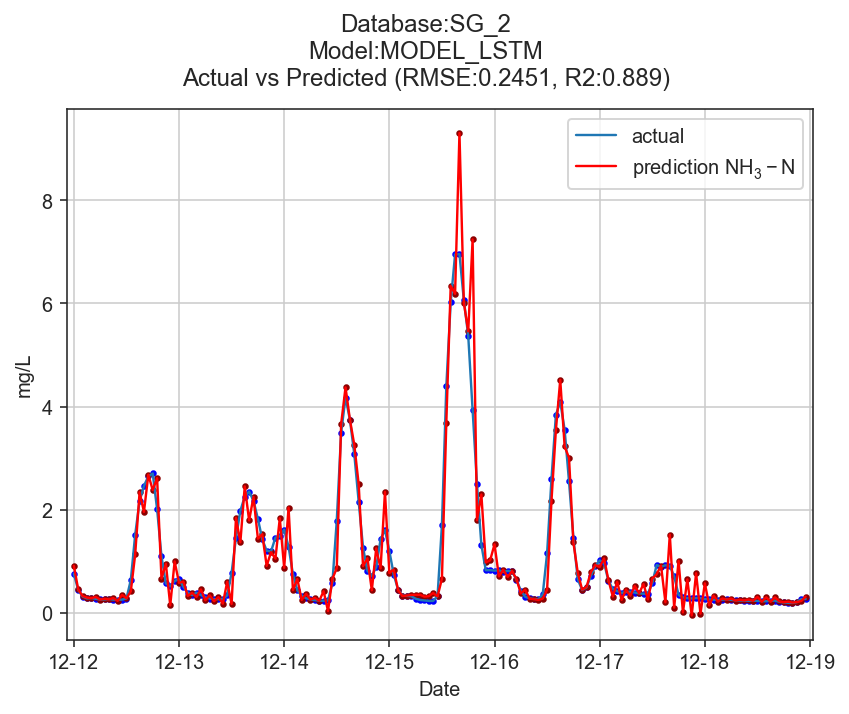

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


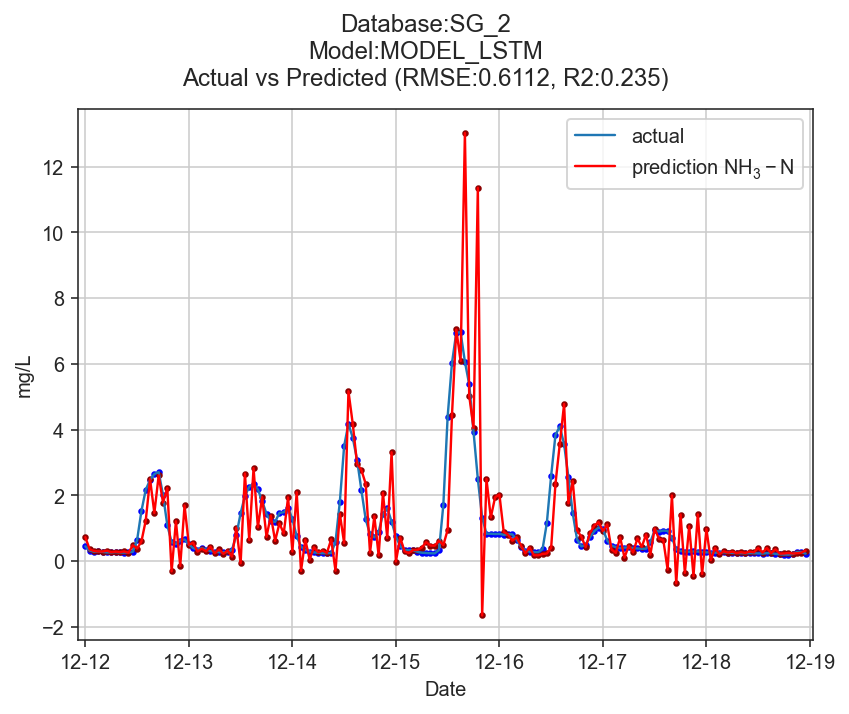

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


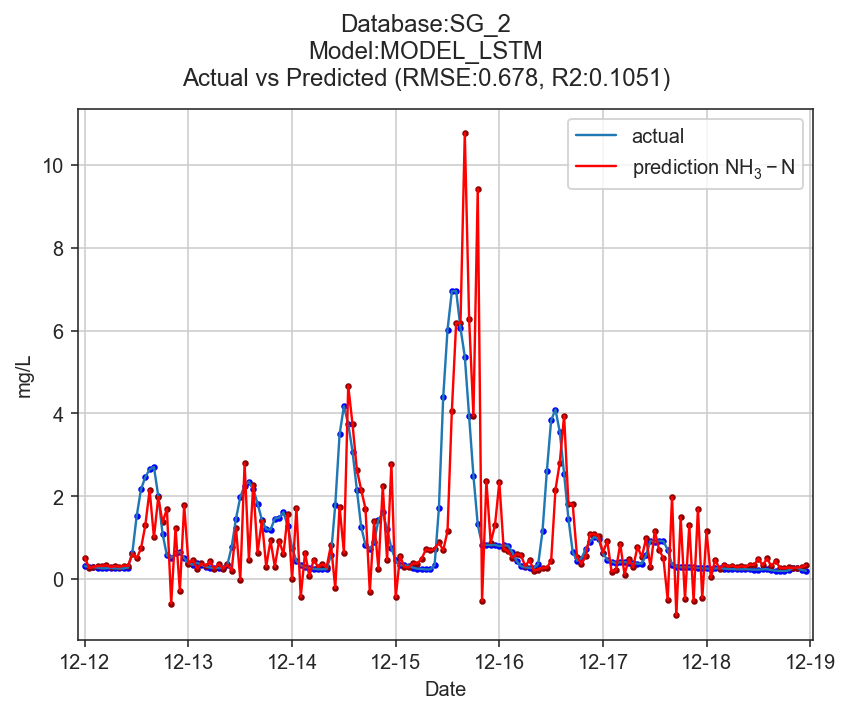

(934, 24, 1)
(670, 24, 1)
Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_2 (Bidirection (None, 20)                960       
_________________________________________________________________
dense_11 (Dense)             (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 427.67015862464905
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.34006   3.44503  0.35152  1.79794  2.91754
Exp2     0.30163   6.36211  4.74351  2.99658  2.99933
Exp3     0.2

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


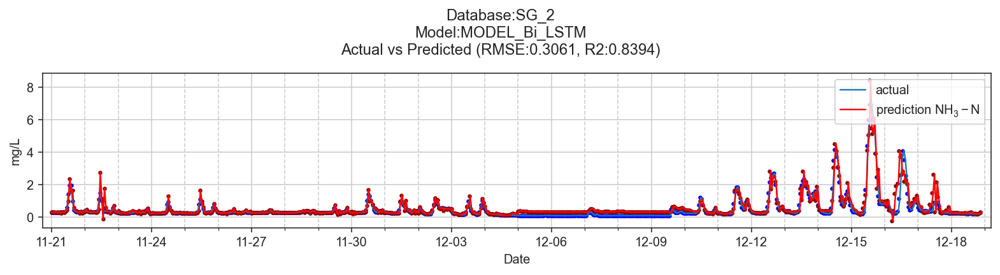

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


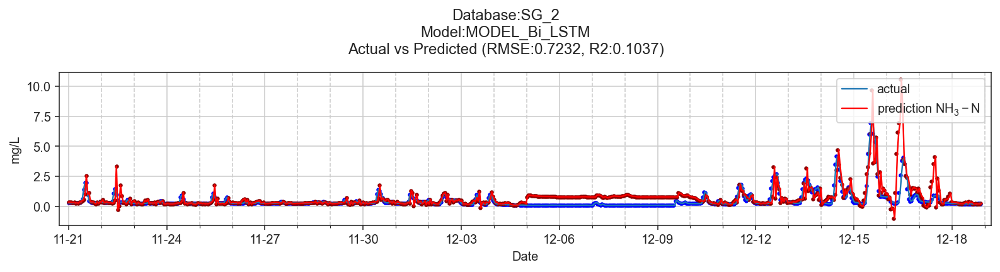

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


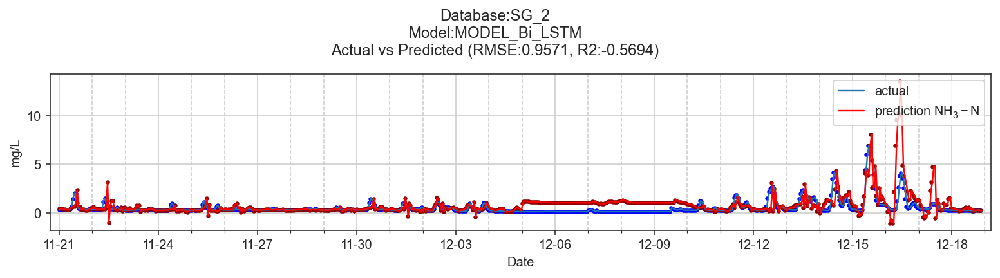

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


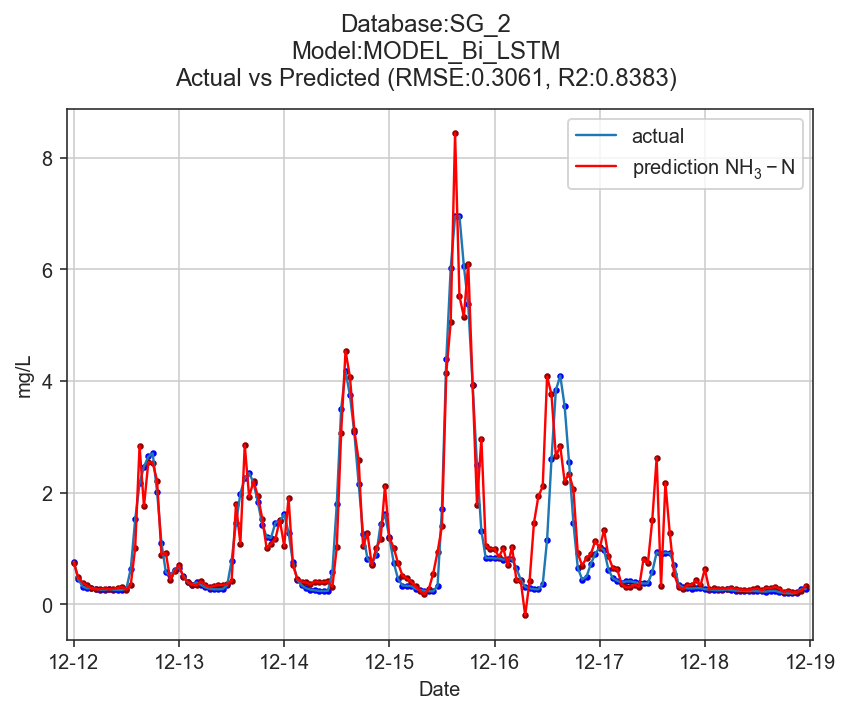

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


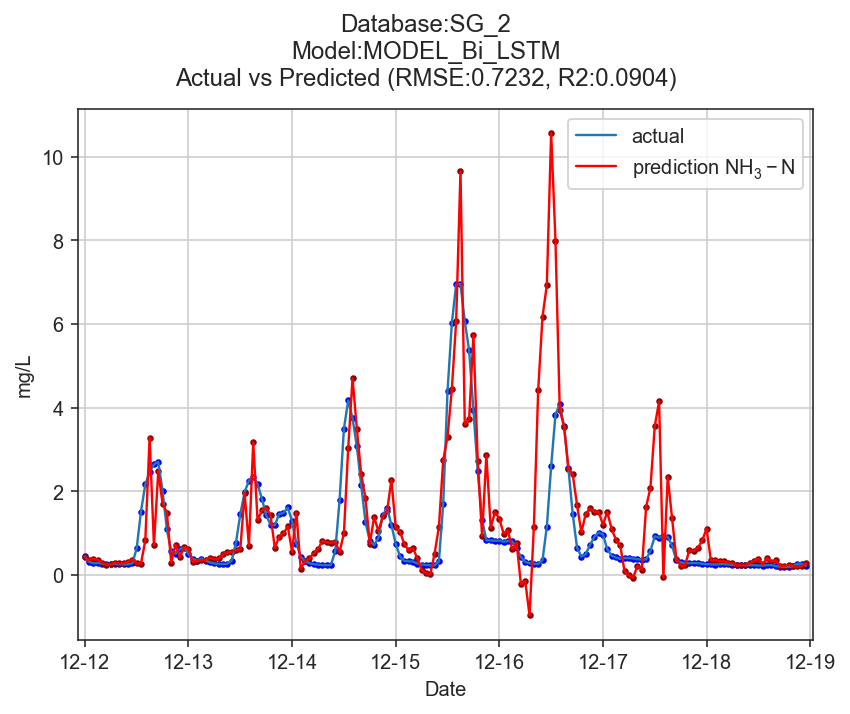

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


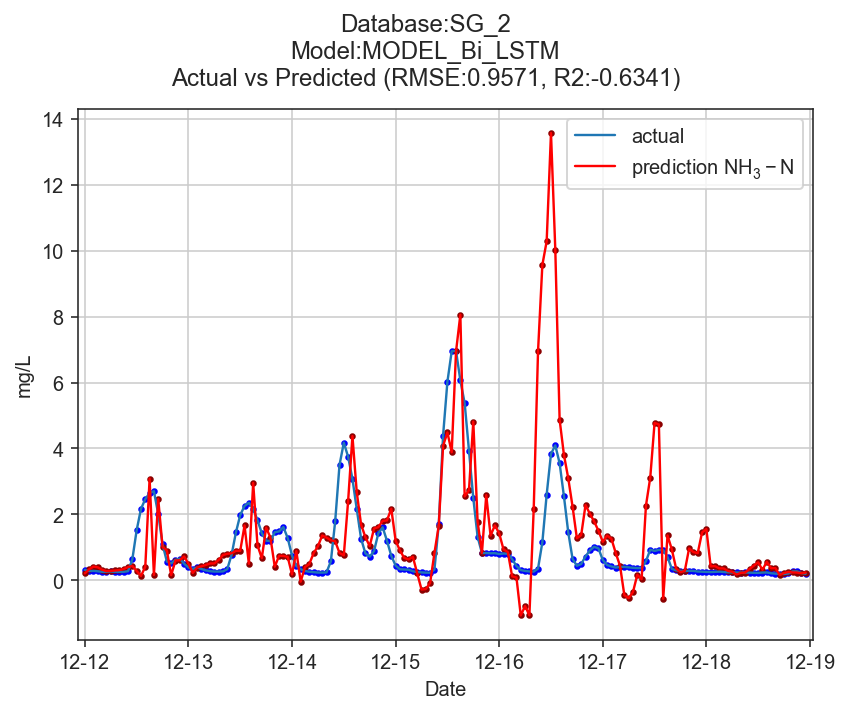

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_10 (LSTM)               (None, 10)                480       
_________________________________________________________________
repeat_vector_2 (RepeatVecto (None, 3, 10)             0         
_________________________________________________________________
lstm_11 (LSTM)               (None, 3, 10)             840       
_________________________________________________________________
time_distributed_2 (TimeDist (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


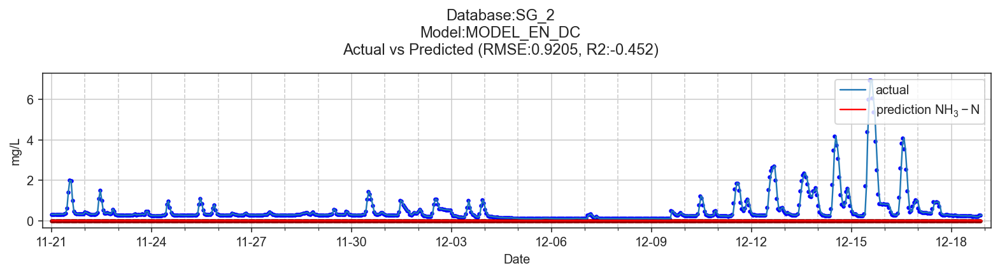

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


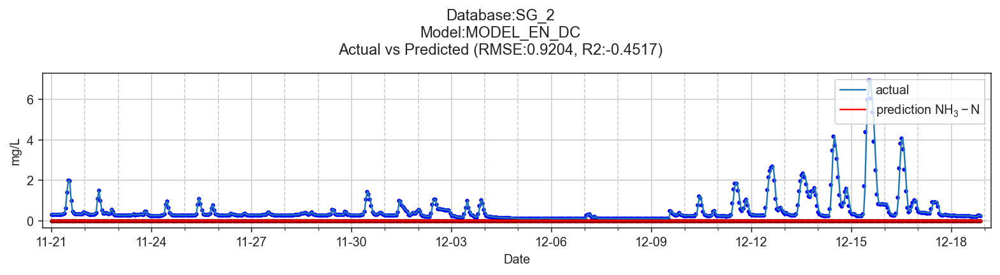

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


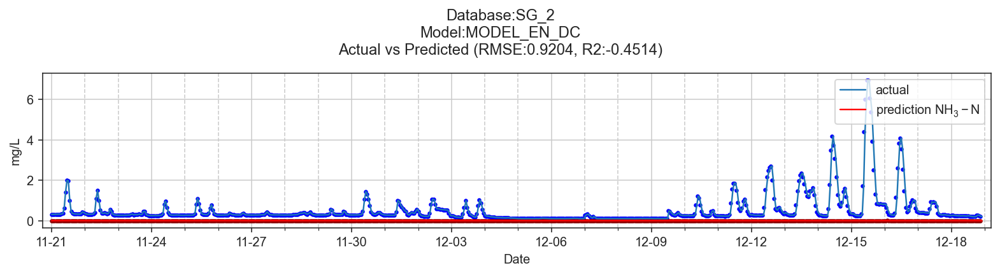

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


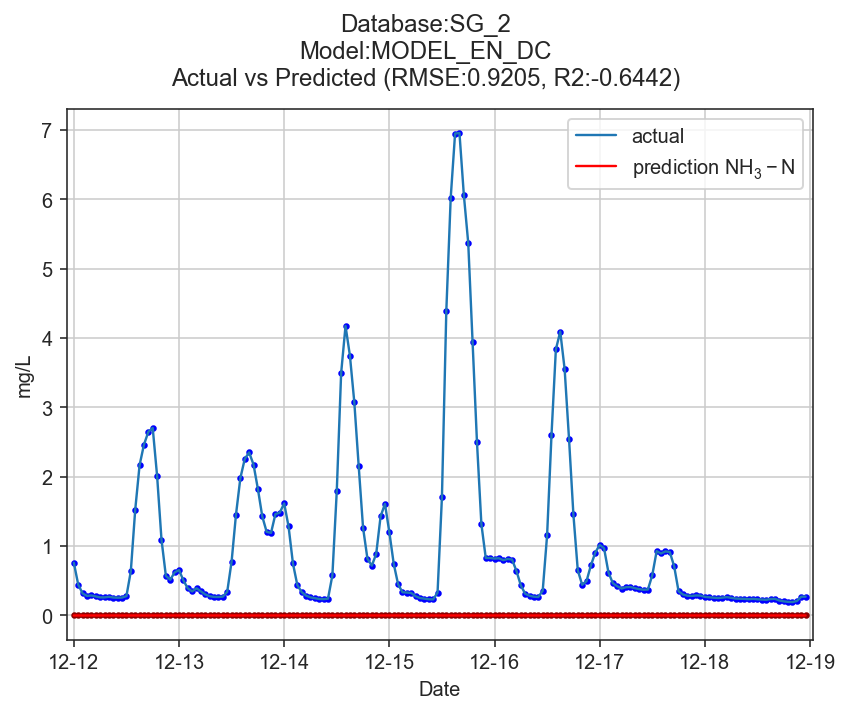

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


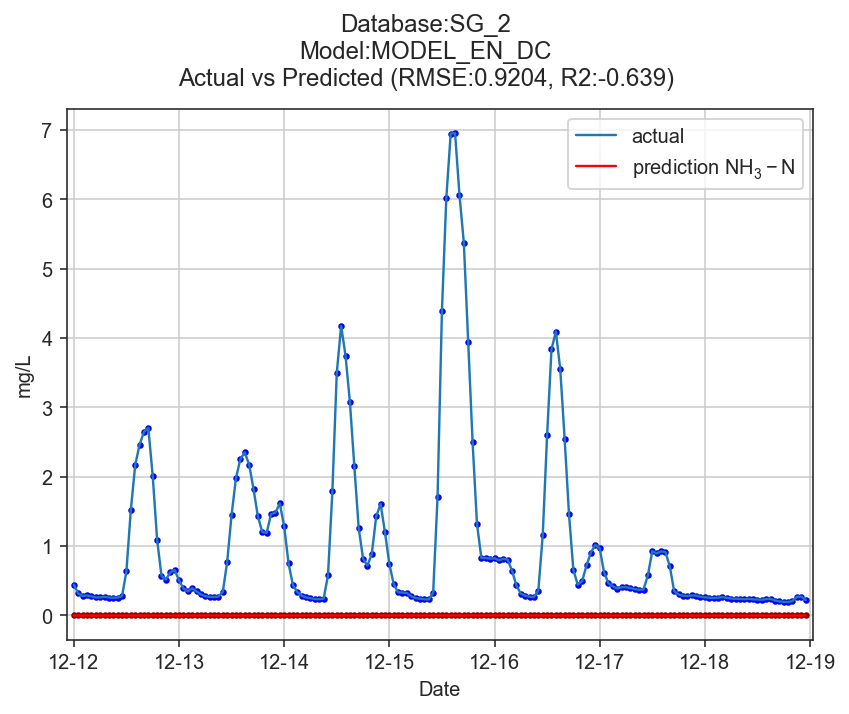

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


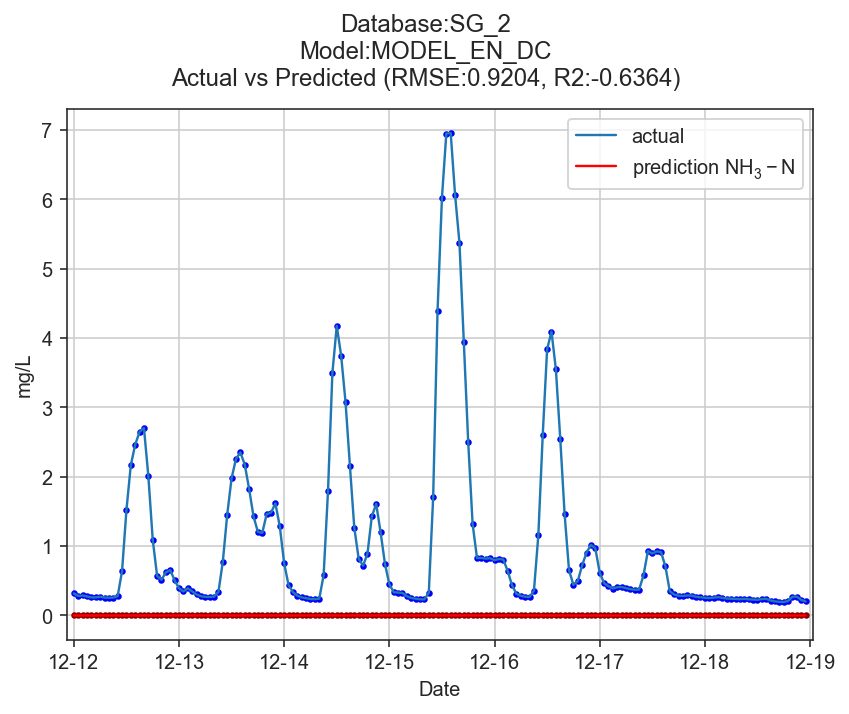

Experiment 1 in progress
TrainRMSE_Mean 0.7130141095543958
TestRMSE_Mean 1.5955422374547432
Experiment 2 in progress
TrainRMSE_Mean 0.711649508543393
TestRMSE_Mean 1.6611870000365698
Experiment 3 in progress
TrainRMSE_Mean 0.7039755424420636
TestRMSE_Mean 2.0808476375851606
Experiment 4 in progress
TrainRMSE_Mean 0.7188579119926327
TestRMSE_Mean 1.4192921344660447
Experiment 5 in progress
TrainRMSE_Mean 0.7208227399401776
TestRMSE_Mean 1.6108691195094116
Experiment 6 in progress
TrainRMSE_Mean 0.7093210059757824
TestRMSE_Mean 1.8271288879045713
Experiment 7 in progress
TrainRMSE_Mean 0.7180530572404623
TestRMSE_Mean 1.7646986361733006
Experiment 8 in progress
TrainRMSE_Mean 0.7194227374515968
TestRMSE_Mean 1.9518995057058464
Experiment 9 in progress
TrainRMSE_Mean 0.7227300502764392
TestRMSE_Mean 1.4850434565794273
Experiment 10 in progress
TrainRMSE_Mean 0.7235627866486299
TestRMSE_Mean 1.5089487923551856
Total time for 10 experiments 1903.52352643013
MODEL_RNN
       TrainRMSE  TestR

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


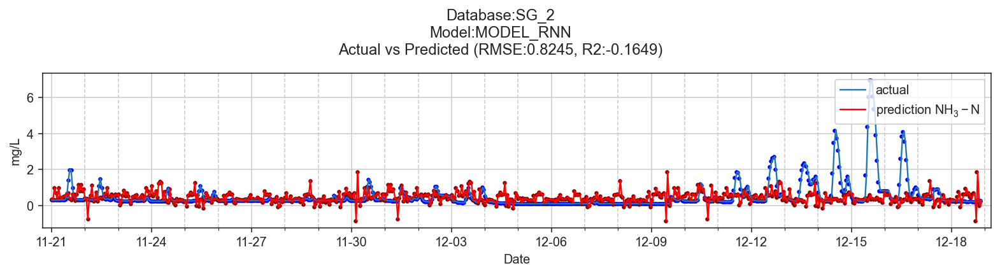

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


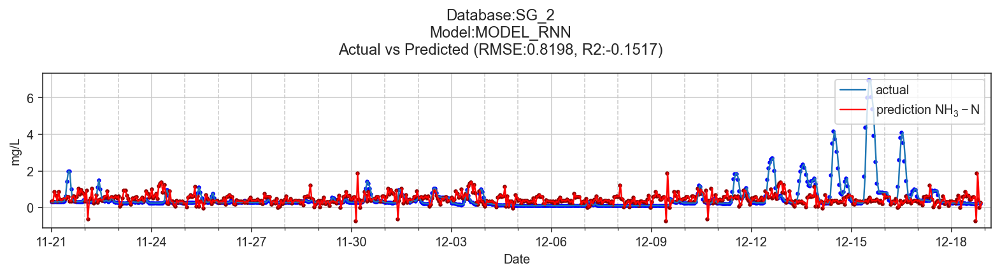

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


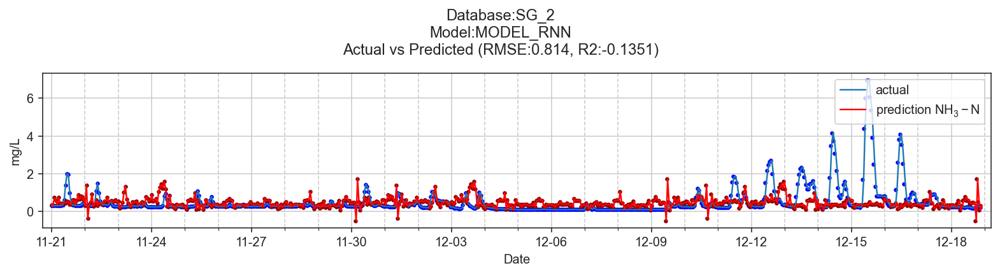

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


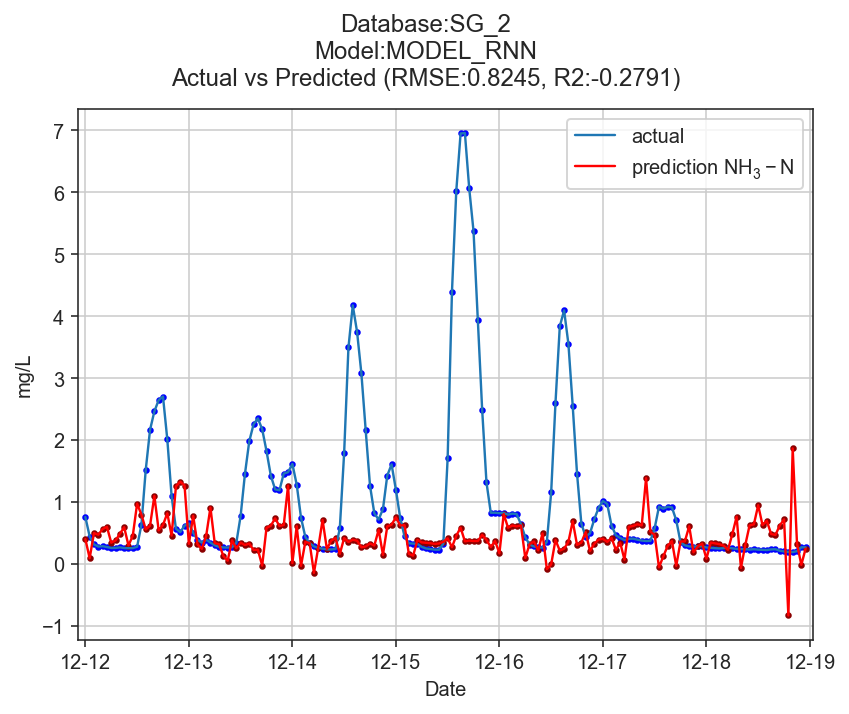

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


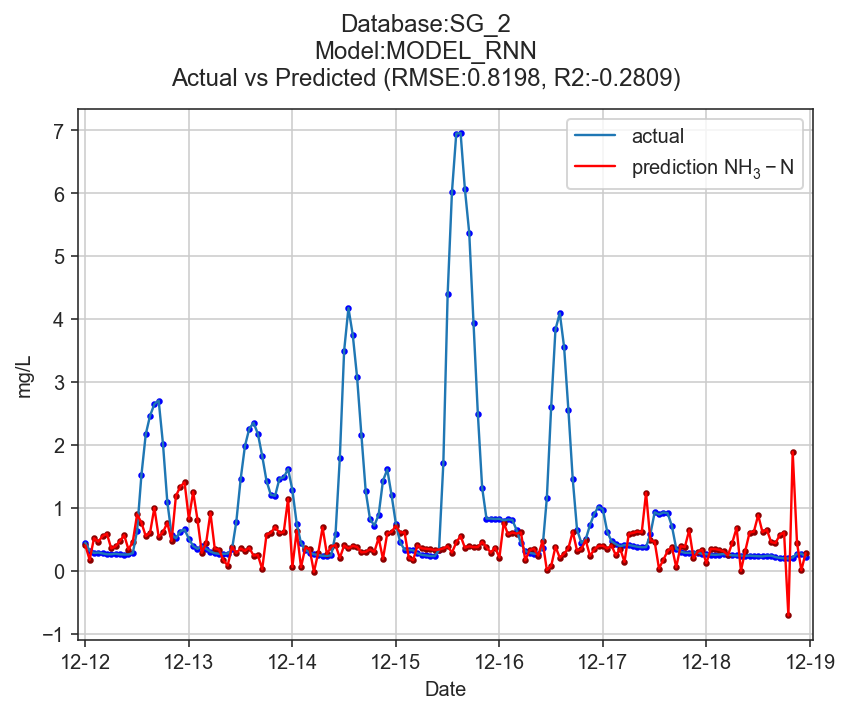

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


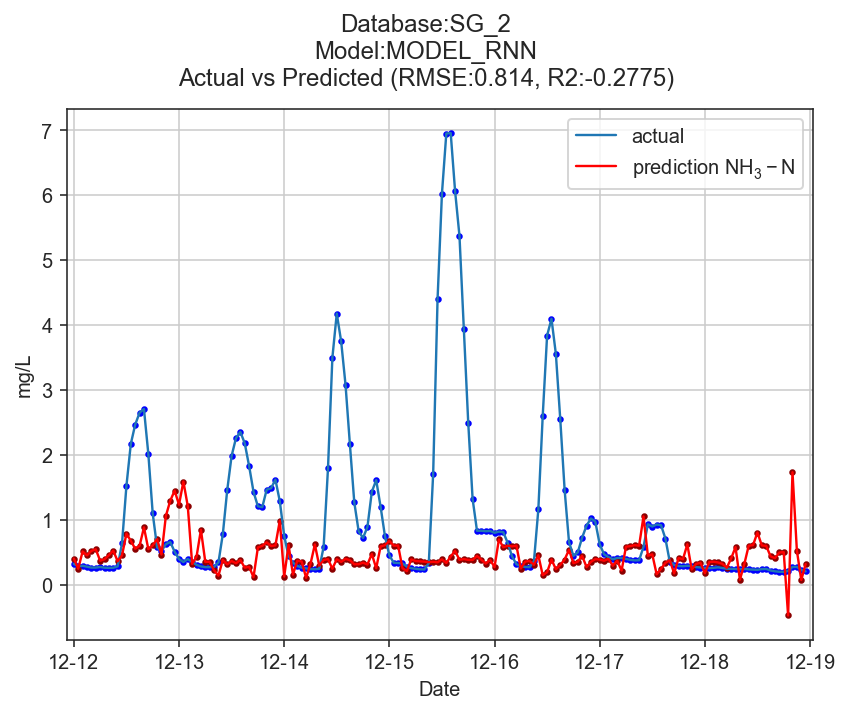

(934, 24, 1)
(670, 24, 1)
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_2 (Conv1D)            (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d_2 (MaxPooling1 (None, 11, 64)            0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 704)               0         
_________________________________________________________________
dense_13 (Dense)             (None, 10)                7050      
_________________________________________________________________
dense_14 (Dense)             (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


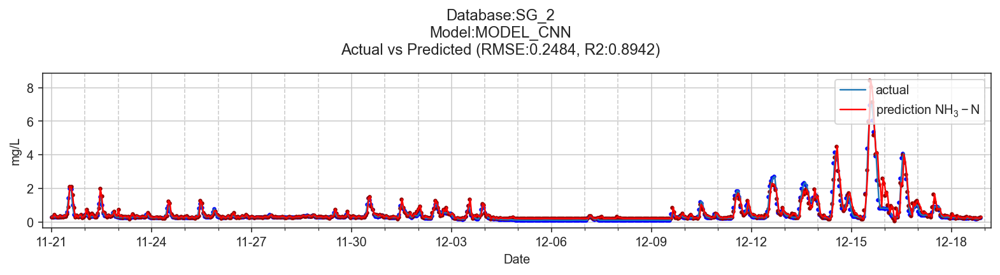

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


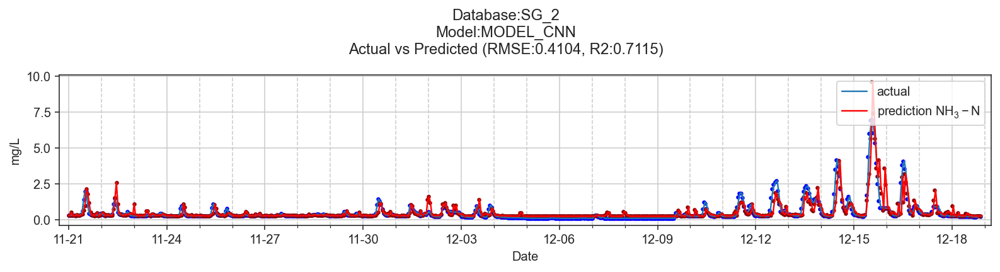

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


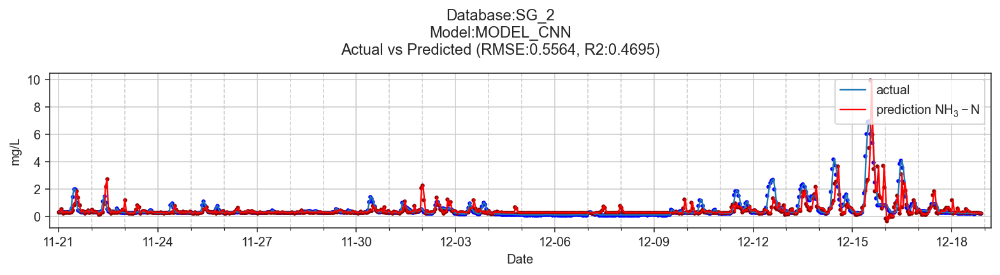

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


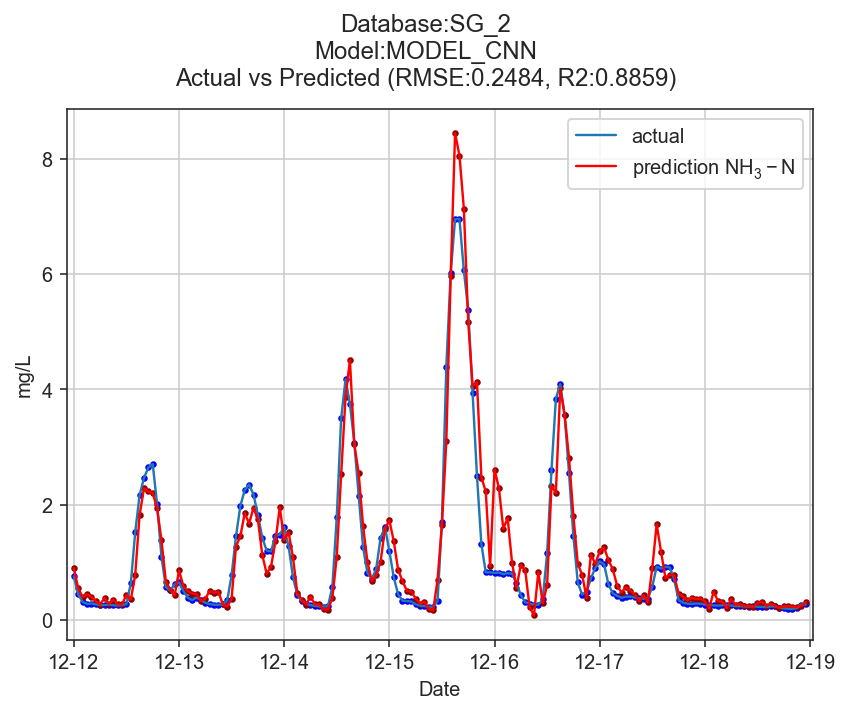

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


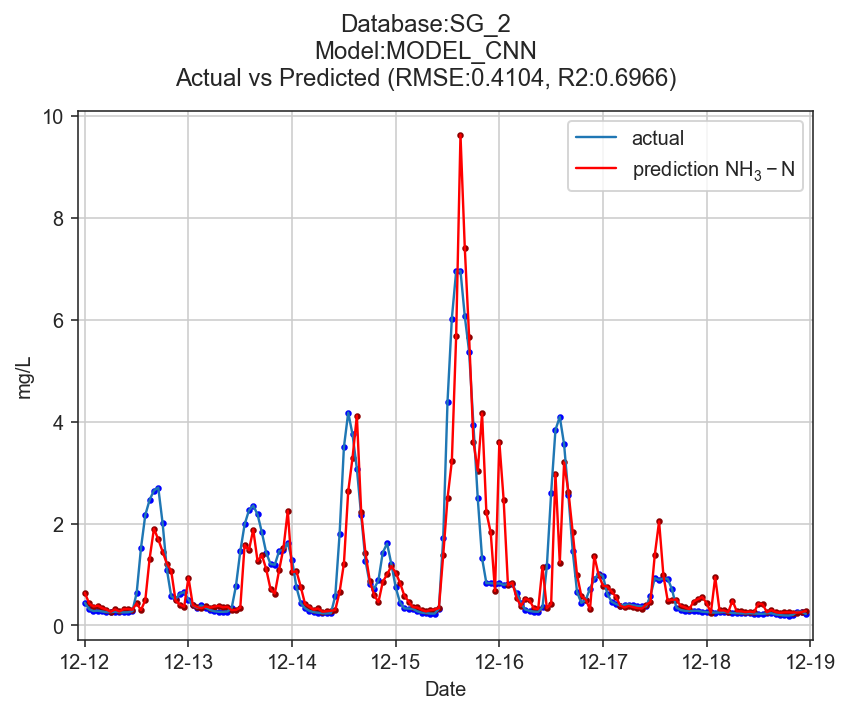

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


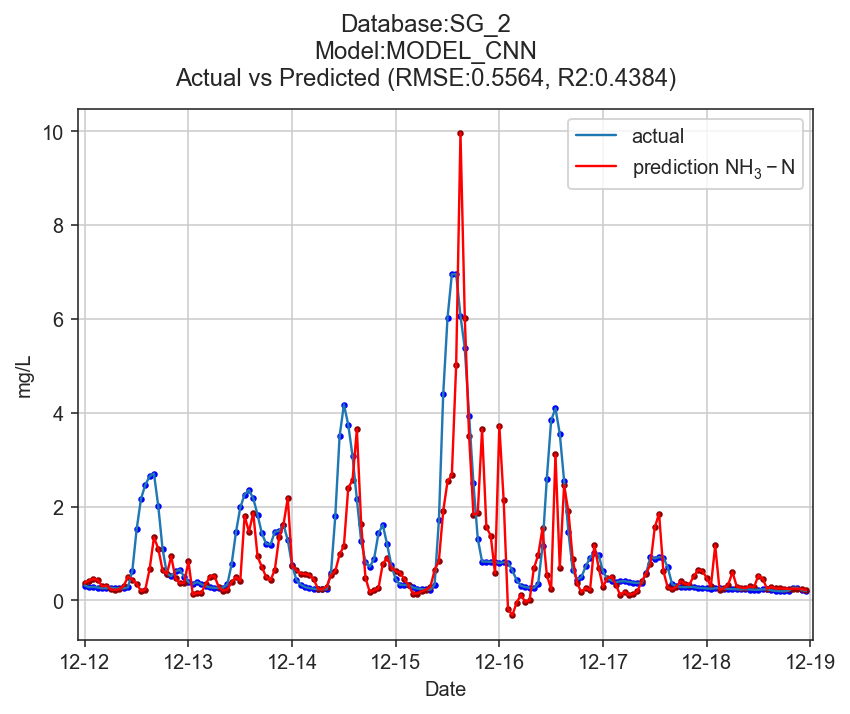

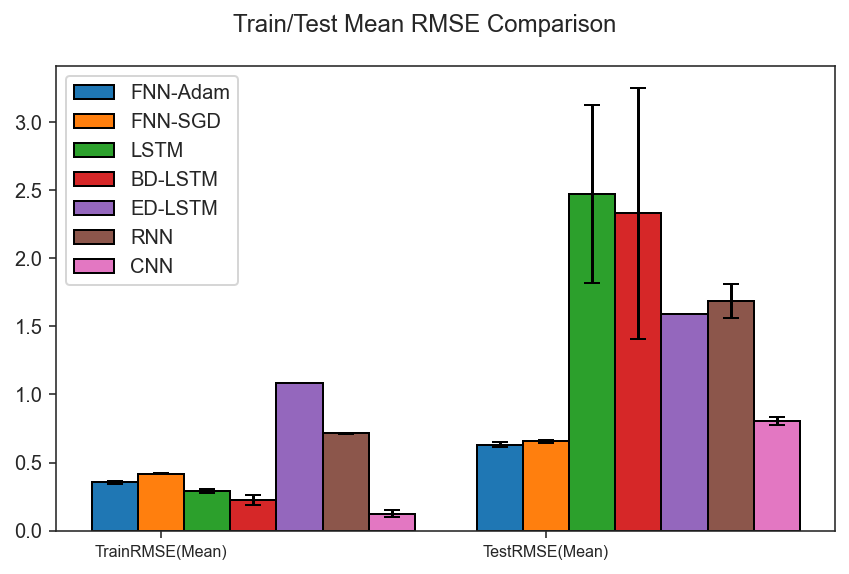

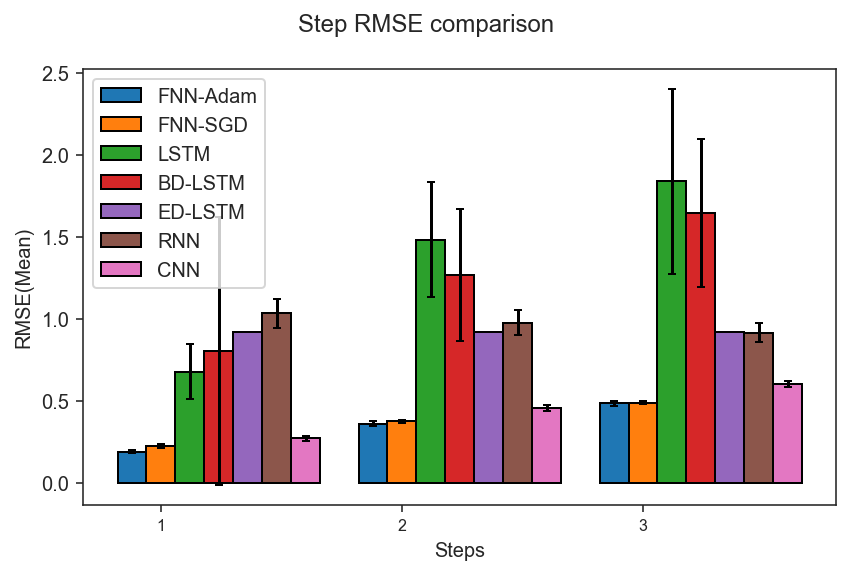

EWMA_1
Experiment 1 in progress
TrainRMSE_Mean 0.320151984984557
TestRMSE_Mean 0.6146705961494399
Experiment 2 in progress
TrainRMSE_Mean 0.32699491183980123
TestRMSE_Mean 0.6100842347346258
Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.33195313847908703
TestRMSE_Mean 0.6528719740534945
Experiment 4 in progress
TrainRMSE_Mean 0.3446047440544093
TestRMSE_Mean 0.6320666794966829
Experiment 5 in progress
TrainRMSE_Mean 0.34045197234229785
TestRMSE_Mean 0.6198902493665929
Experiment 6 in progress
TrainRMSE_Mean 0.32363901753329627
TestRMSE_Mean 0.6020953362600167
Experiment 7 in progress
TrainRMSE_Mean 0.3354208745637583
TestRMSE_Mean 0.6055316275611148
Experiment 8 in progress
TrainRMSE_Mean 0.3374622922823462
TestRMSE_Mean 0.658940984619907
Experiment 9 in progress
TrainRMSE_Mean 0.34218061170012215
TestRMSE_Mean 0.597923931815054
Experiment 10 in progress
TrainRMSE_Mean 0.3287169462982794
TestRMSE_Mean 0.6461986849729418
Total time for 10 experiments 9.2364342212677
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.32015   0.61467  0.18509  0.35487  0.46651
Exp2     0.32699   0.61008  0.19571  0.33963  0.46750
Exp3     0.33195   0.65287  0.19321  0.36937  0.50247
Exp4     

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


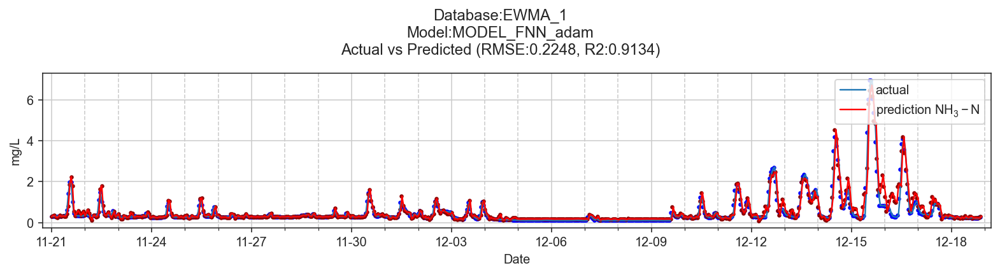

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


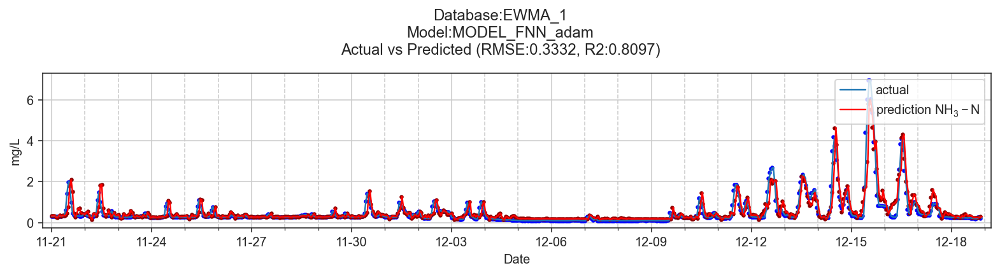

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


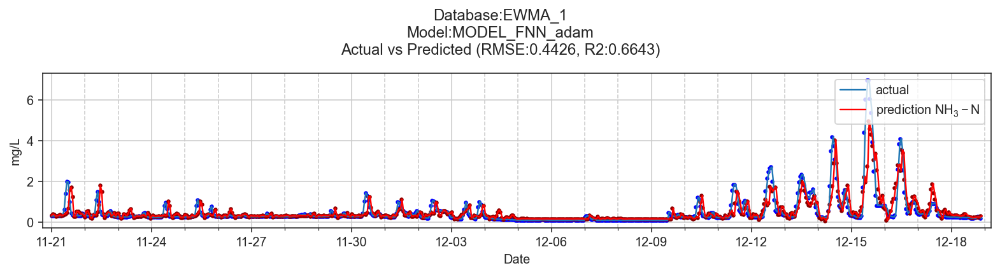

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


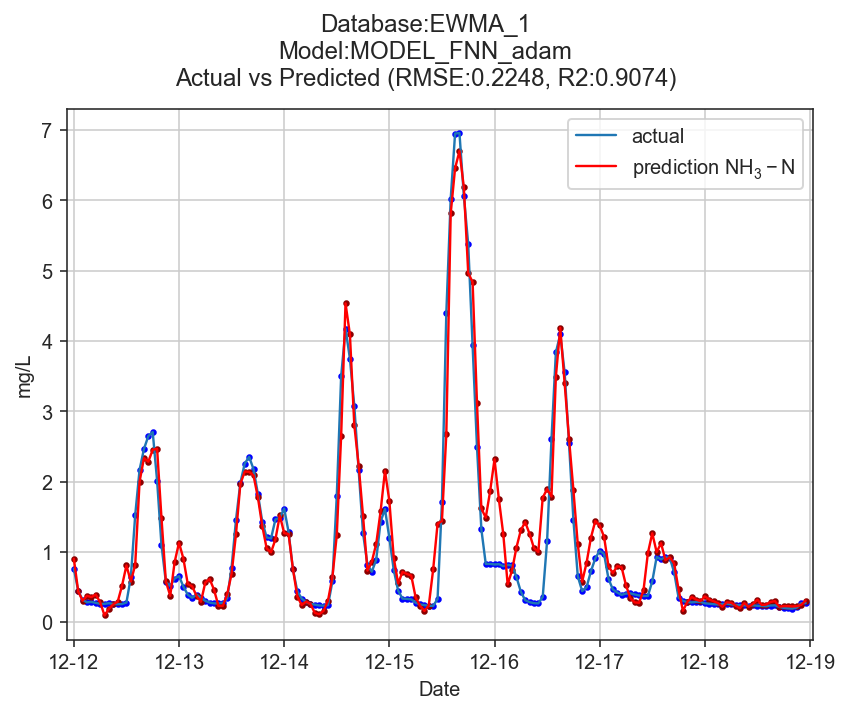

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


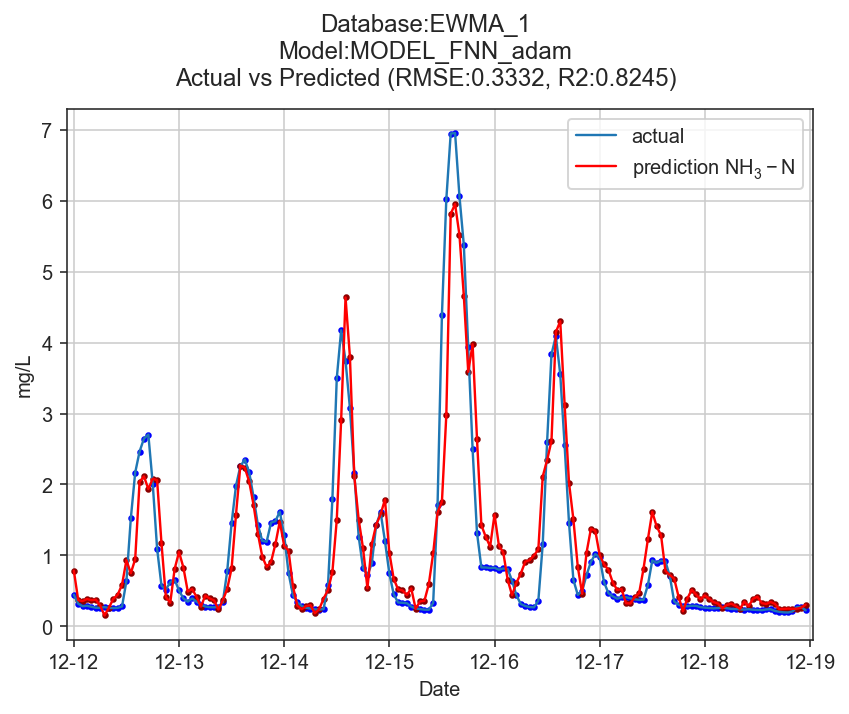

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


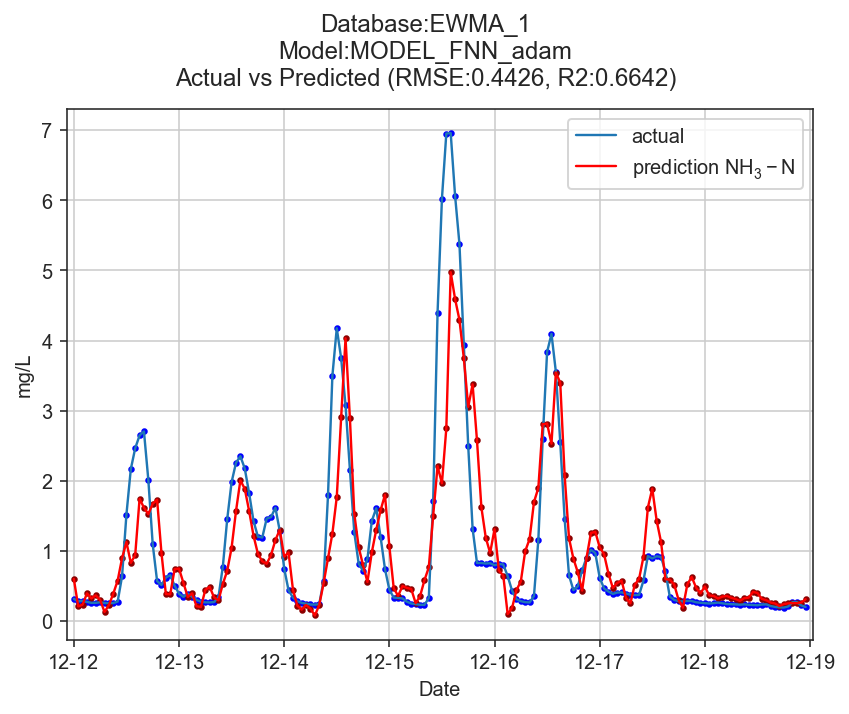

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 21.89267373085022
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.37756   0.65306  0.22870  0.38123  0.47838
Exp2     0.39640   0.65922  0.21002  0.36858  0.50458
Exp3     0.38354   0.66432  0.20127  0.38694  0.50109
Exp4     0.38049   0.64159  0.22257  0.36834  0.47585
Exp5     0.37978   0.64298  0.18879  0.36092  0.49751
Exp6     0.38149   0.68267  0.22314  0.39254  0.51201
Exp7     0.40111   0.69314  0.23245  0.39087  0.52309
Exp8     0.37309   0.65866  0.20135  0.38311  0.49651
Exp9     0.37823   0.65271  0.21288  0.36937  0.49424
Exp10    0.37488   0.63593  0.19843  0.35653  0.48777
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.38266             0.00861  0.37732  0.38800  0.37309  0.40111
TestRMSE   0.65843             0.01708  0.64784  0.66901  0.63593  0.69314
Step1      0.21196             0.01374  0.20344  0.22048  0.18879  0.23245
Step2      0.37584             0.01207  0.36

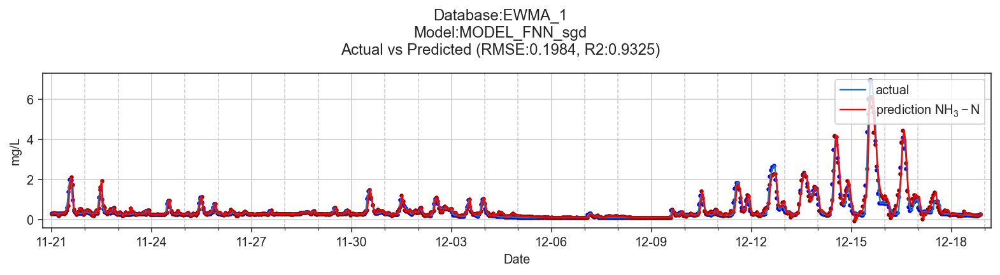

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


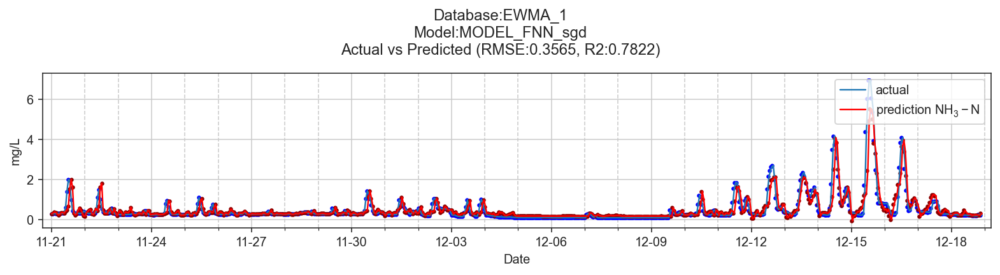

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


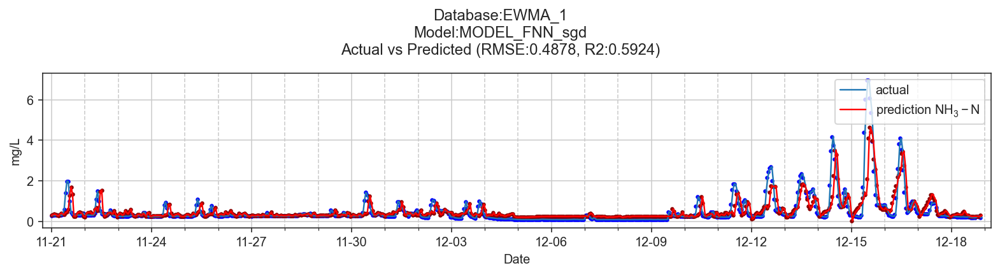

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


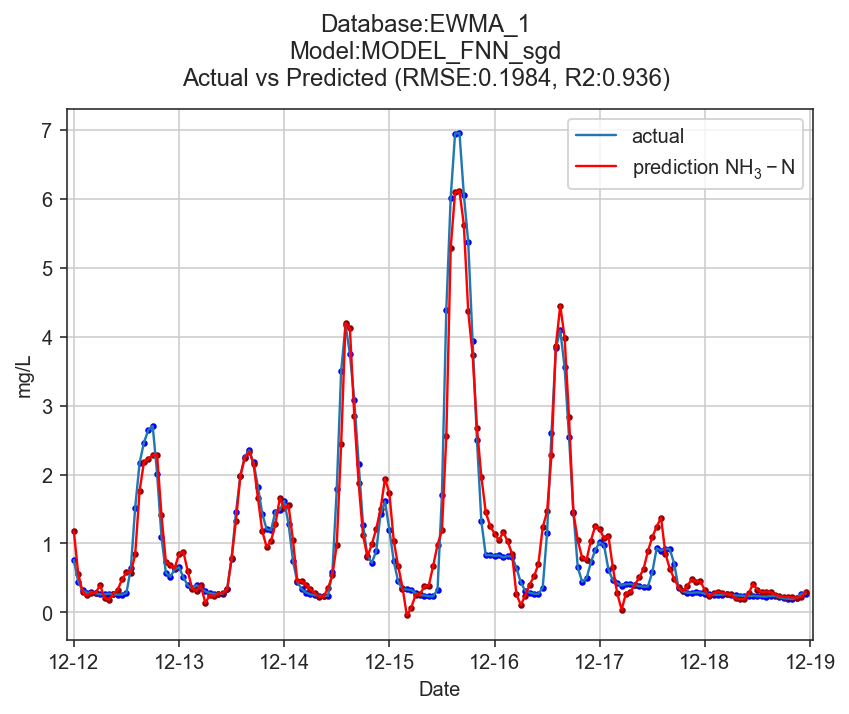

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


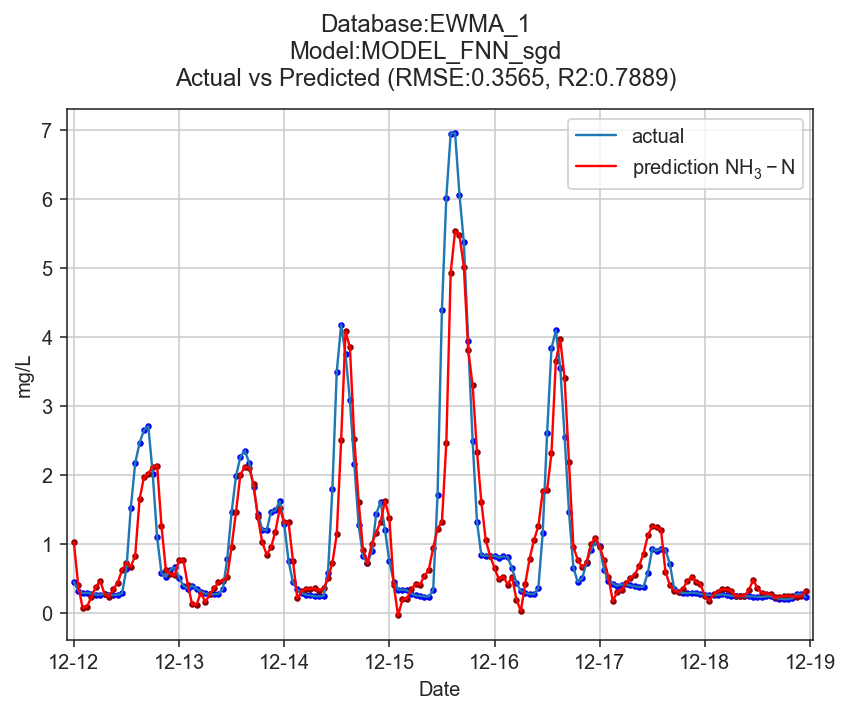

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


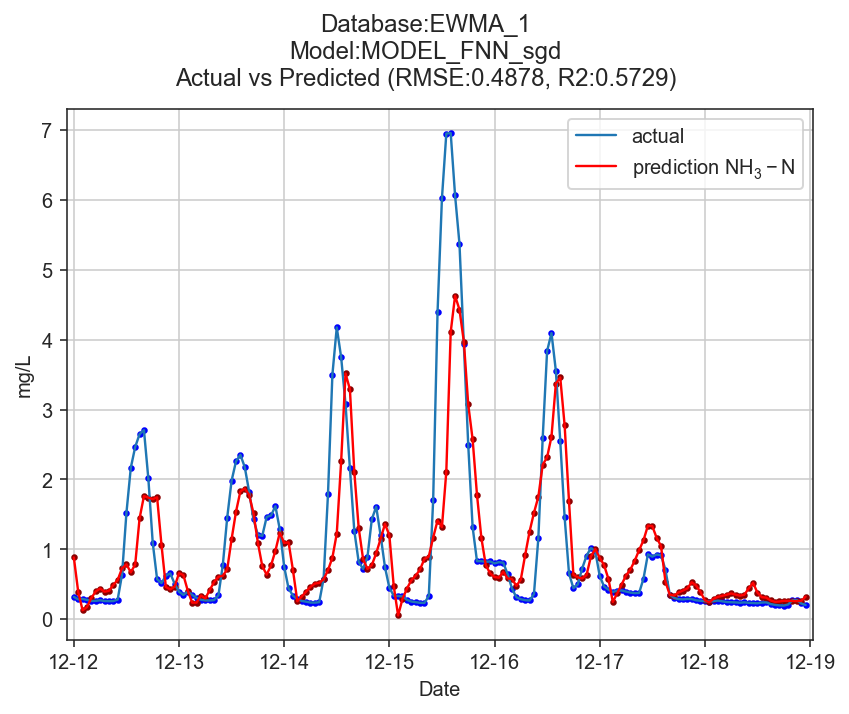

(934, 24, 1)
(670, 24, 1)
Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_12 (LSTM)               (None, 10)                480       
_________________________________________________________________
dense_15 (Dense)             (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 389.78625082969666
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.32733   0.80510  0.29310  0.41806  0.62249
Exp2     0.30738   0.92428  0.31227  0.54339  0.67935
Exp3     0.29915  

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


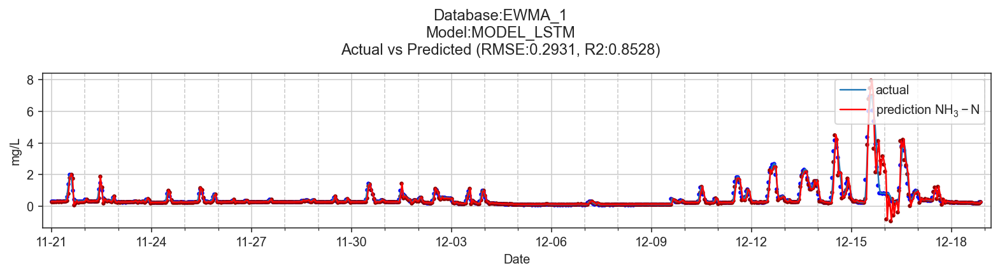

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


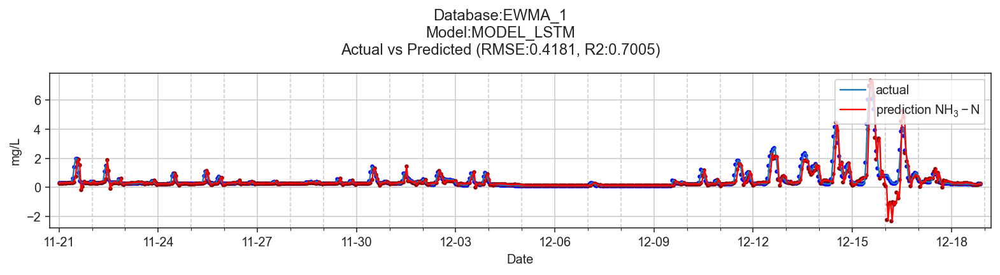

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


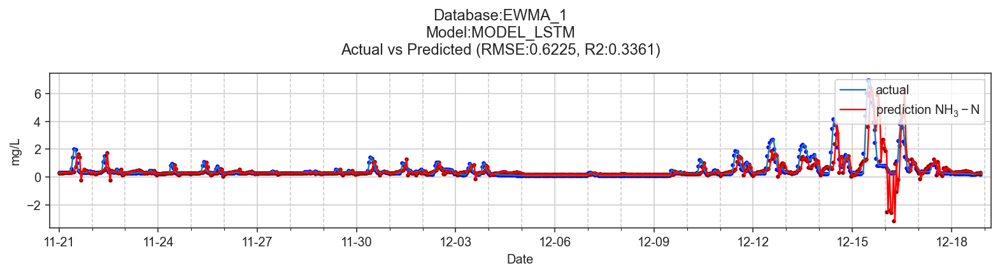

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


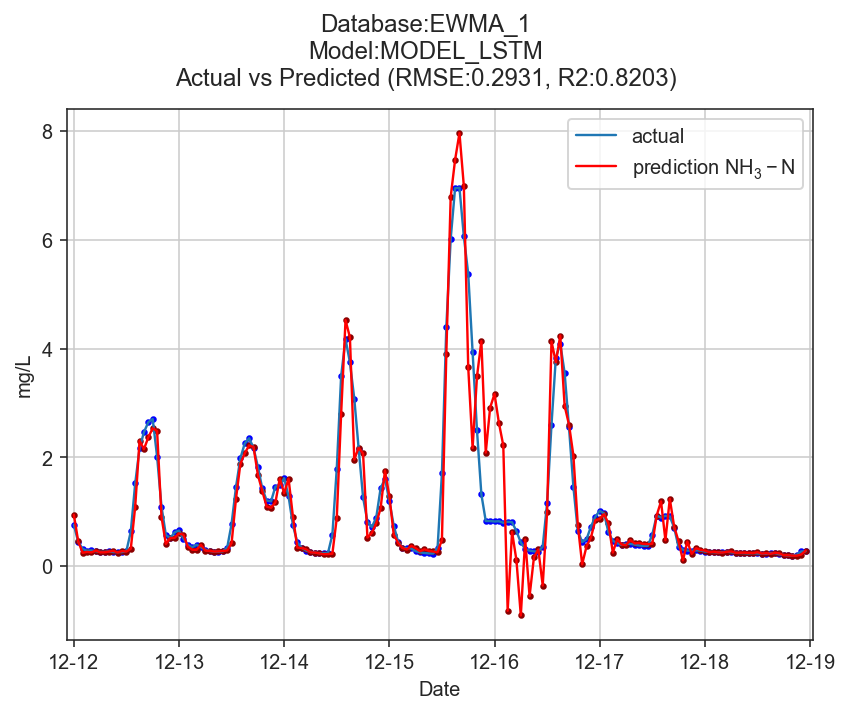

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


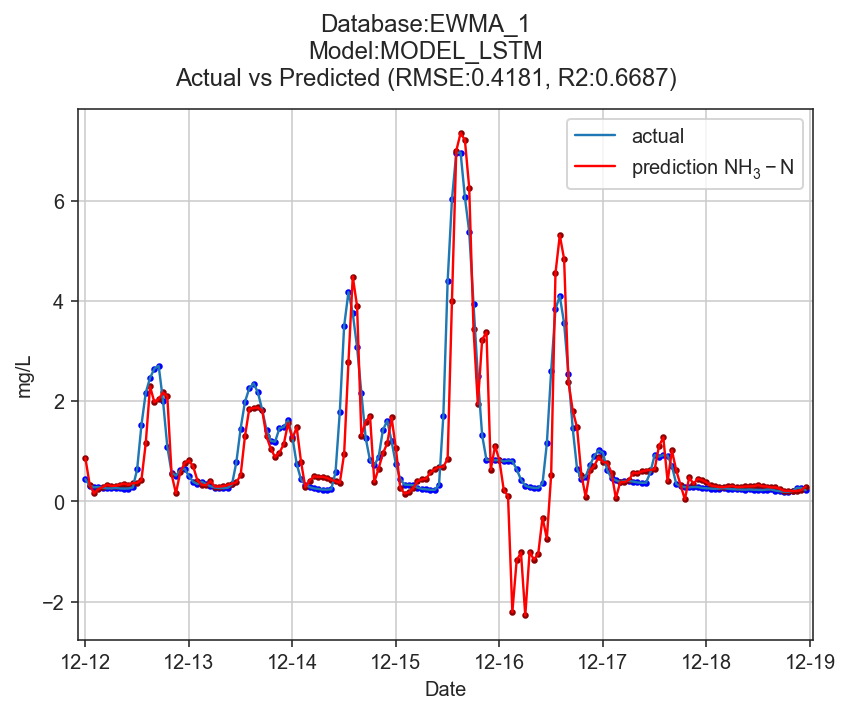

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


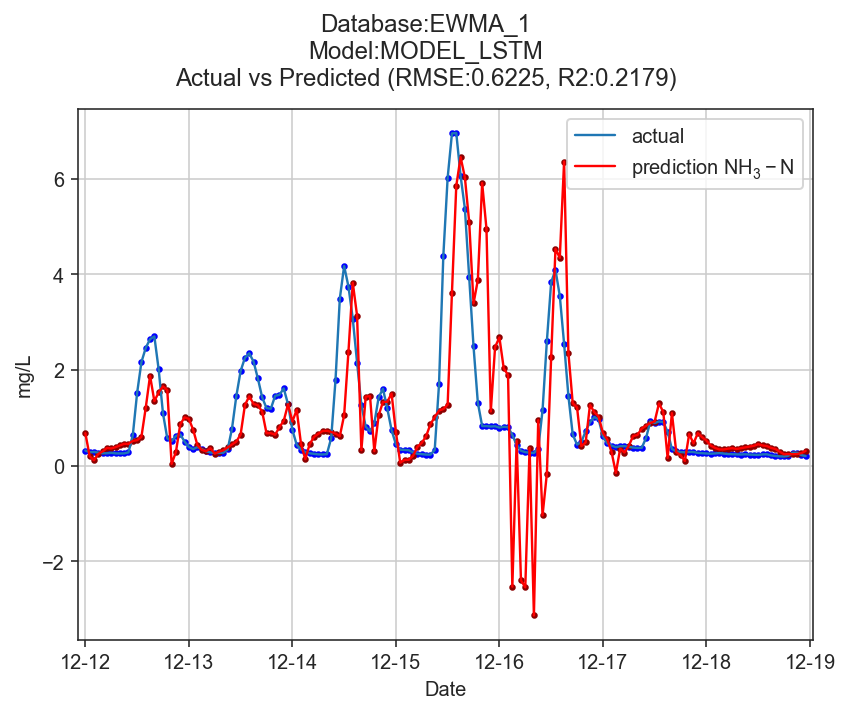

(934, 24, 1)
(670, 24, 1)
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_3 (Bidirection (None, 20)                960       
_________________________________________________________________
dense_16 (Dense)             (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 421.7665092945099
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.27188   1.26583  0.31304  0.48754  1.12545
Exp2     0.29132   0.69051  0.19199  0.38910  0.53717
Exp3     0.1

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


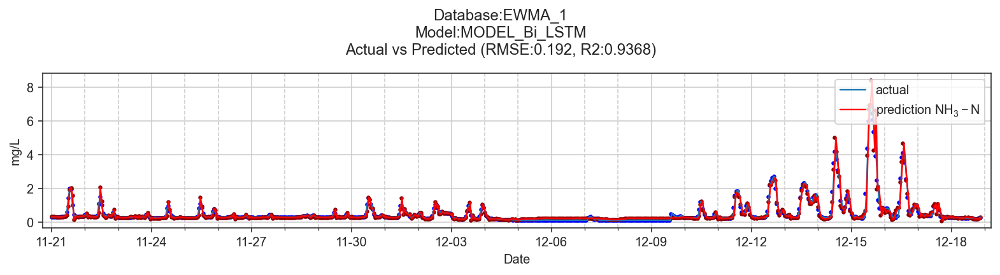

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


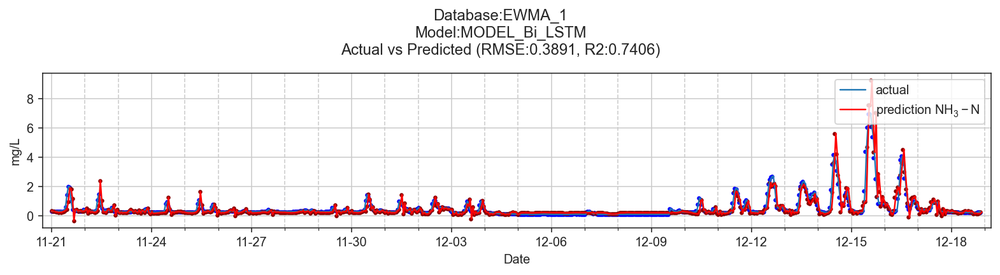

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


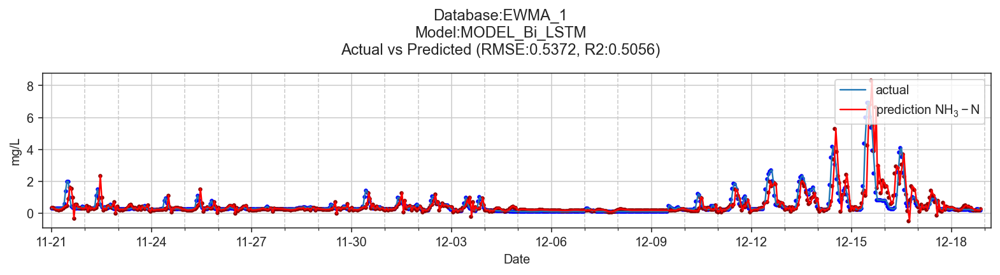

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


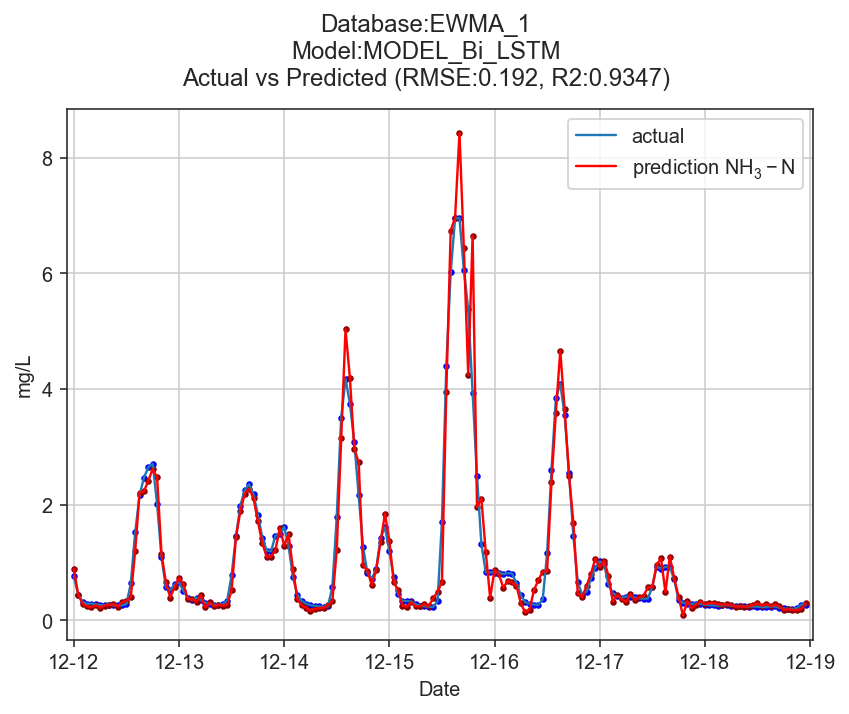

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


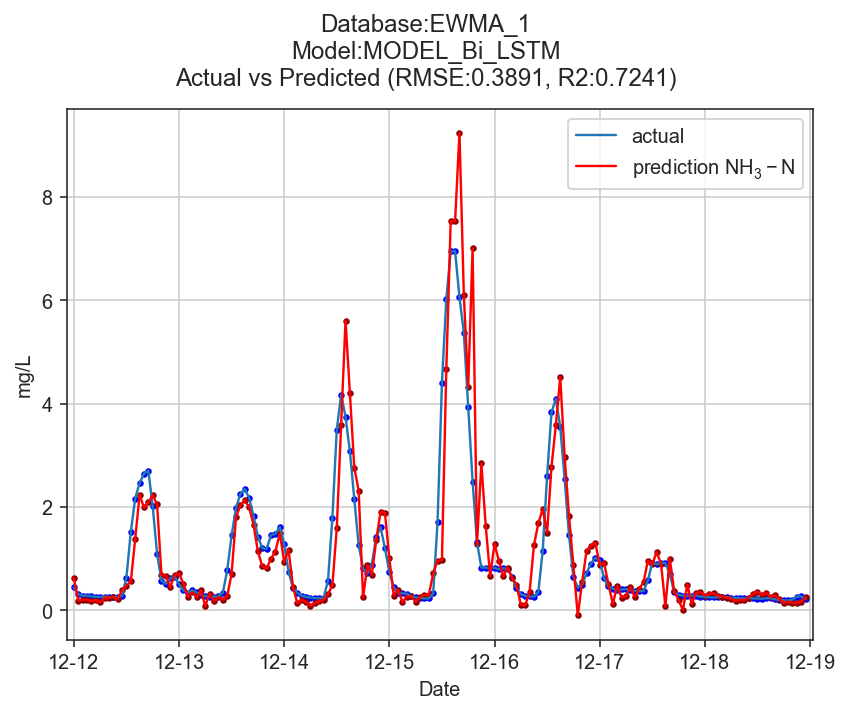

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


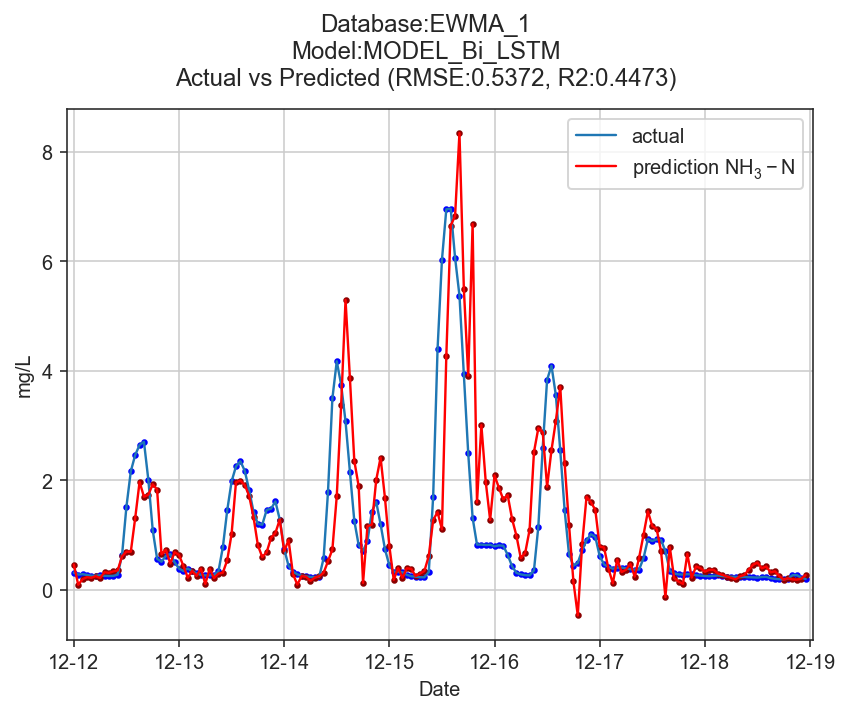

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_14 (LSTM)               (None, 10)                480       
_________________________________________________________________
repeat_vector_3 (RepeatVecto (None, 3, 10)             0         
_________________________________________________________________
lstm_15 (LSTM)               (None, 3, 10)             840       
_________________________________________________________________
time_distributed_3 (TimeDist (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


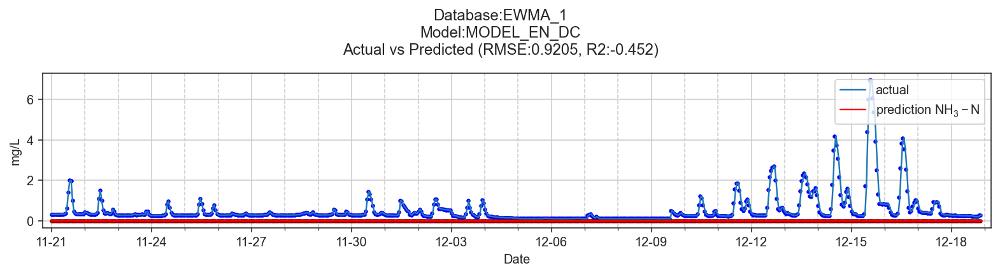

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


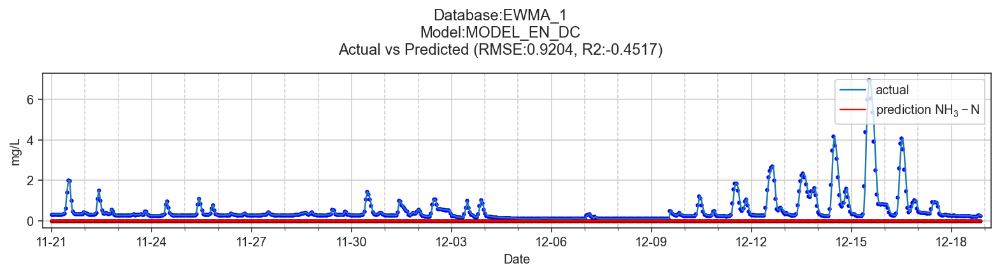

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


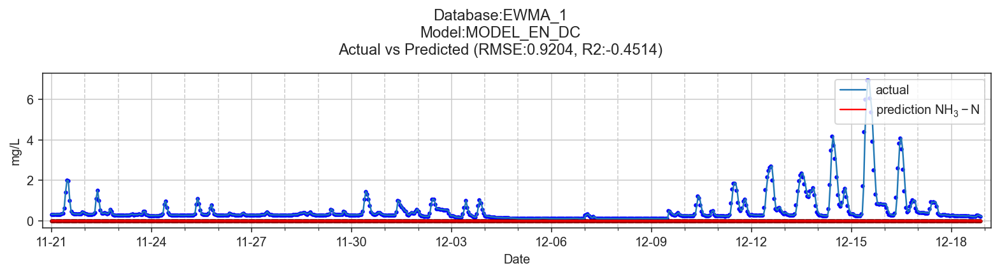

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


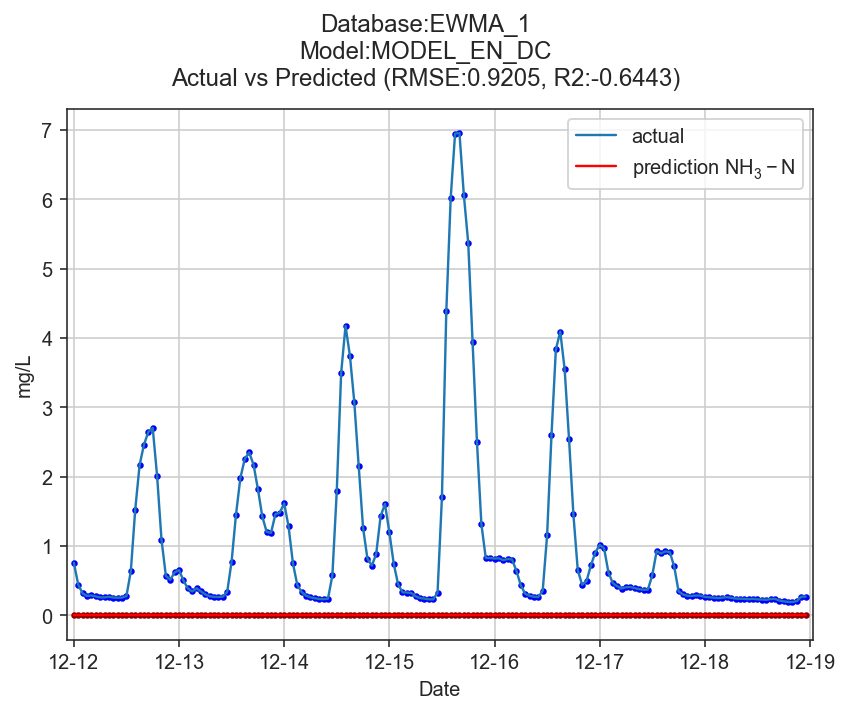

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


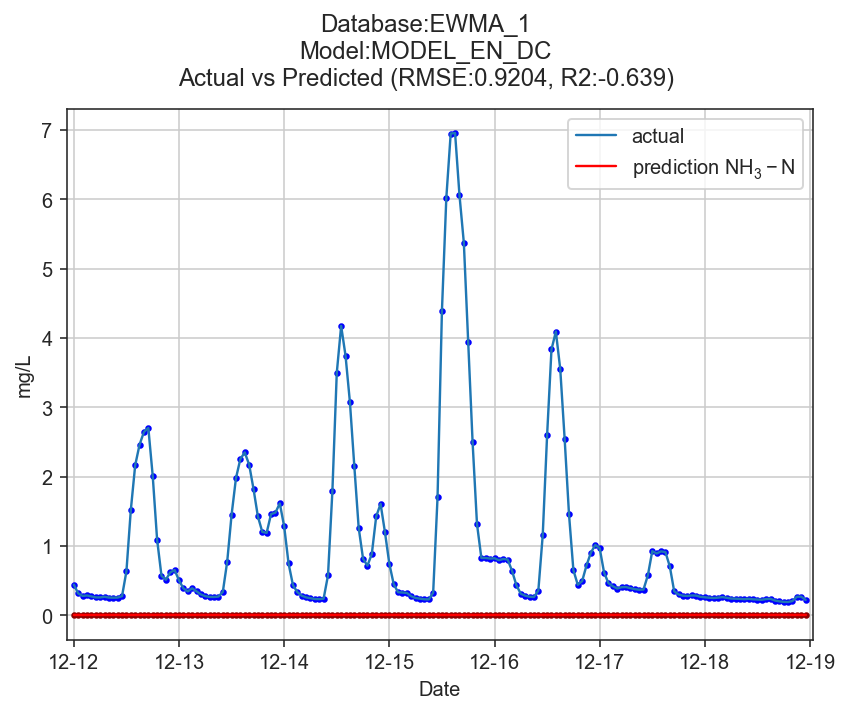

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


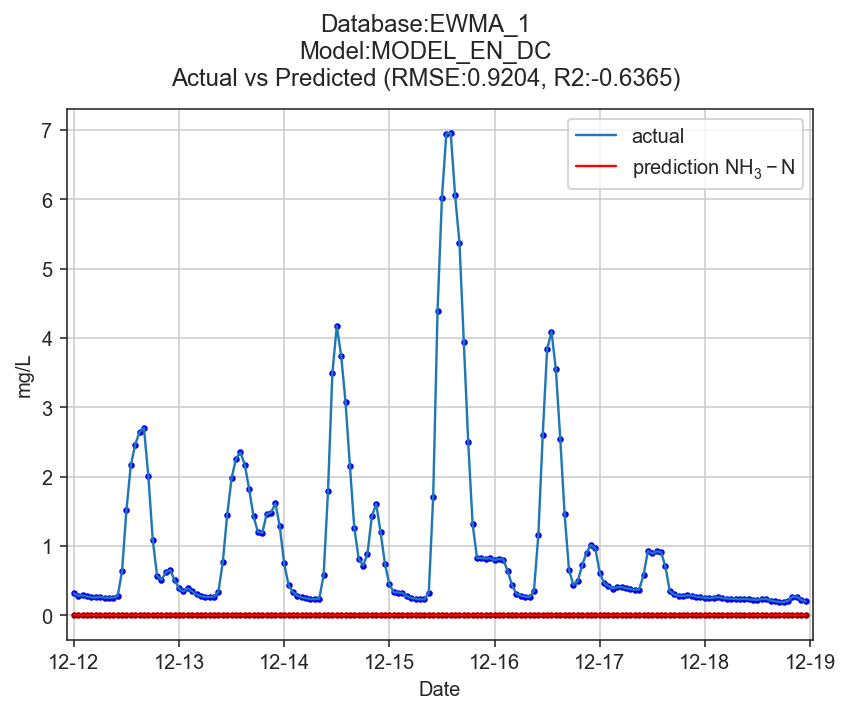

Experiment 1 in progress
TrainRMSE_Mean 0.6821284225352654
TestRMSE_Mean 1.532350862011505
Experiment 2 in progress
TrainRMSE_Mean 0.6984324070101698
TestRMSE_Mean 1.5756124193512835
Experiment 3 in progress
TrainRMSE_Mean 0.6975577914085221
TestRMSE_Mean 1.7905001613823104
Experiment 4 in progress
TrainRMSE_Mean 0.6851912176448942
TestRMSE_Mean 1.6136886358259053
Experiment 5 in progress
TrainRMSE_Mean 0.6889766115560196
TestRMSE_Mean 1.442985573965091
Experiment 6 in progress
TrainRMSE_Mean 0.6968011345981849
TestRMSE_Mean 1.6670414298580956
Experiment 7 in progress
TrainRMSE_Mean 0.6953092386213745
TestRMSE_Mean 1.6710286843505395
Experiment 8 in progress
TrainRMSE_Mean 0.6845067658255988
TestRMSE_Mean 1.5850891976218644
Experiment 9 in progress
TrainRMSE_Mean 0.7004057516706903
TestRMSE_Mean 1.6271957121483622
Experiment 10 in progress
TrainRMSE_Mean 0.6973541548091978
TestRMSE_Mean 1.57939838389268
Total time for 10 experiments 1904.43656873703
MODEL_RNN
       TrainRMSE  TestRMSE

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


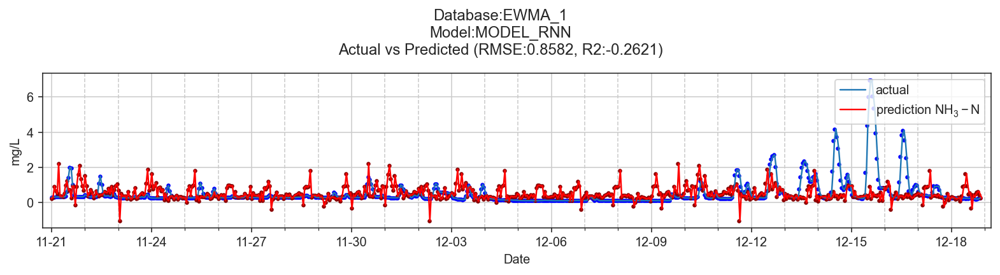

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


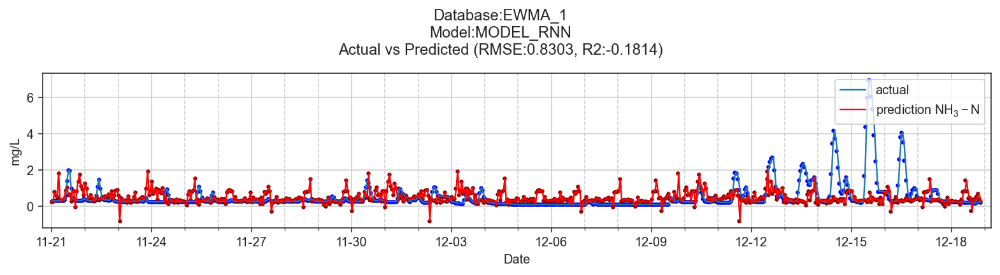

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


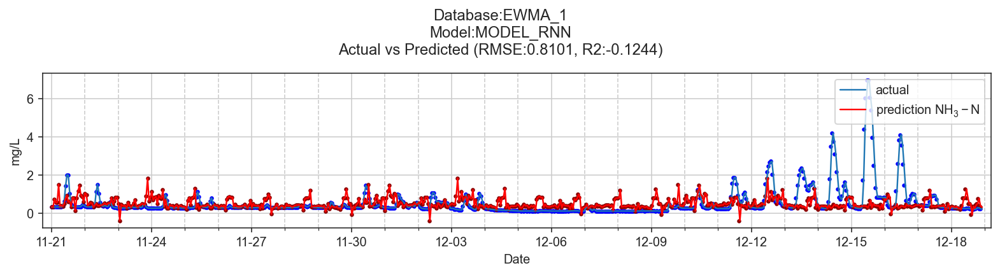

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


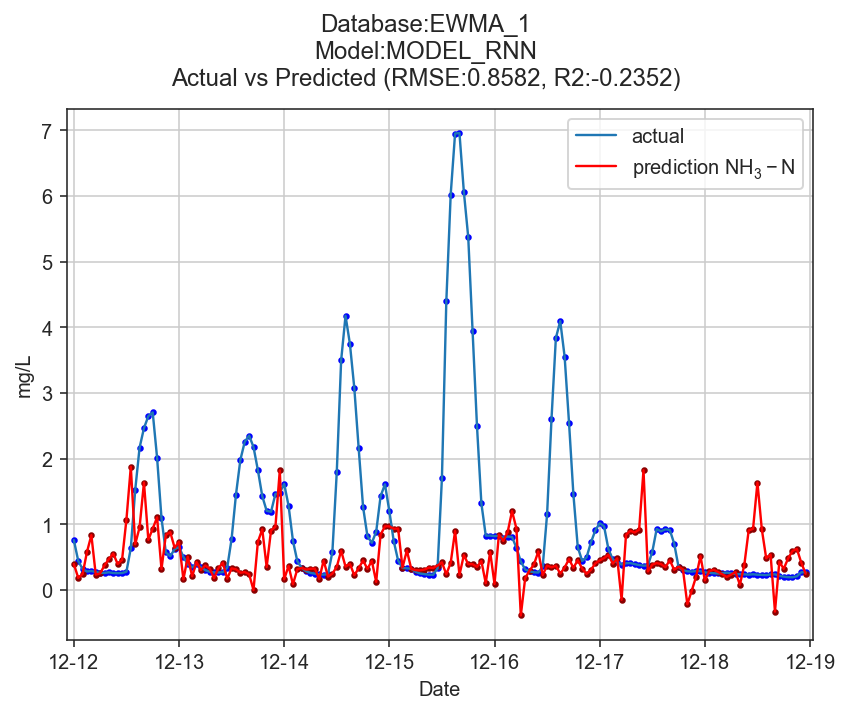

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


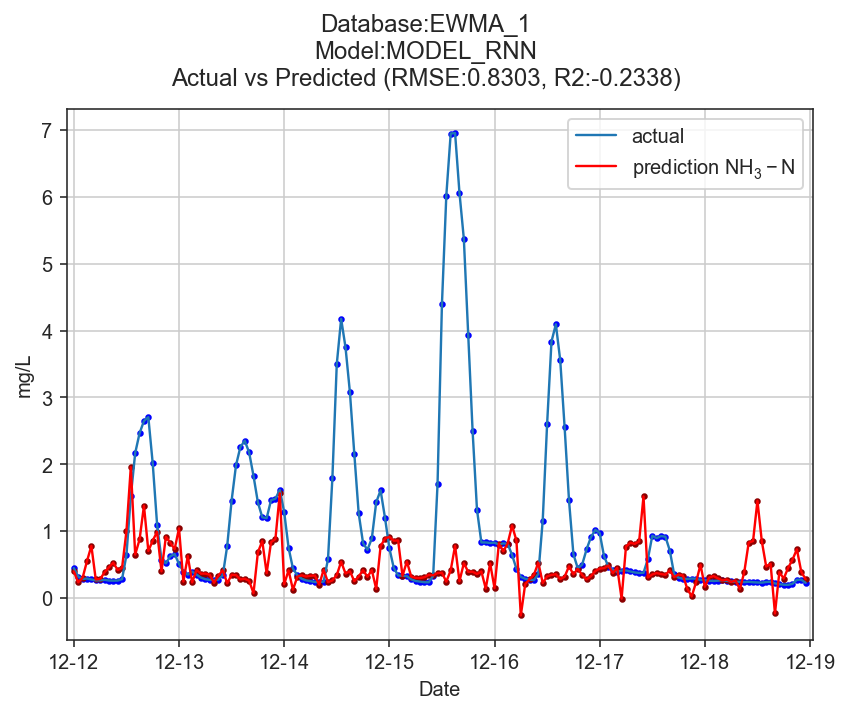

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


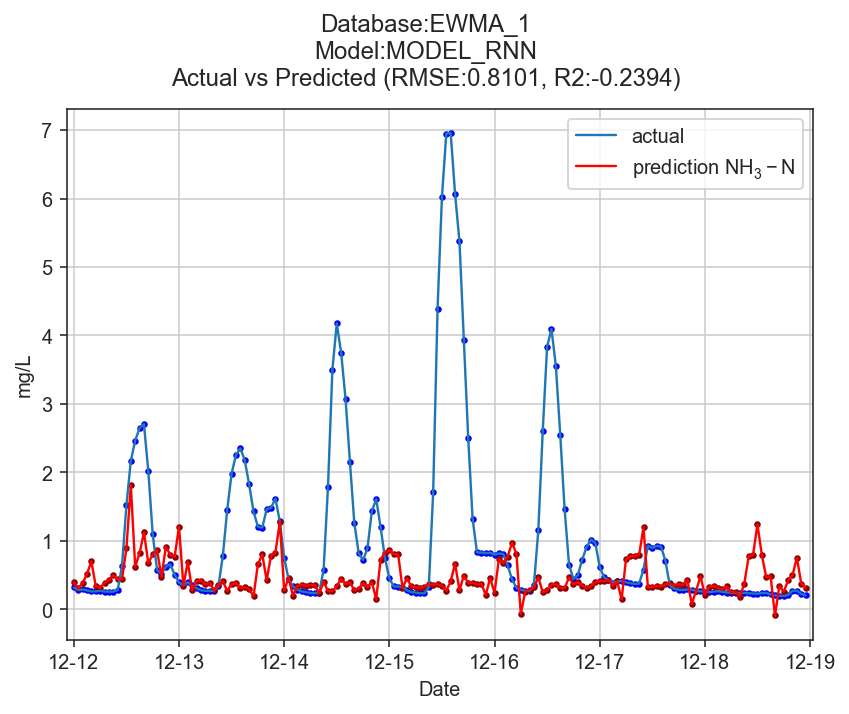

(934, 24, 1)
(670, 24, 1)
Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_3 (Conv1D)            (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d_3 (MaxPooling1 (None, 11, 64)            0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 704)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 10)                7050      
_________________________________________________________________
dense_19 (Dense)             (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


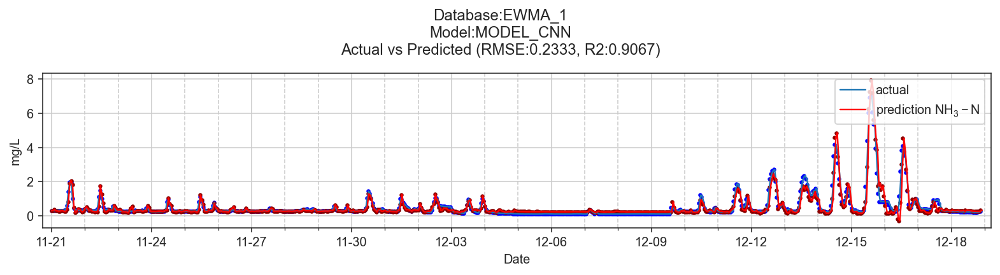

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


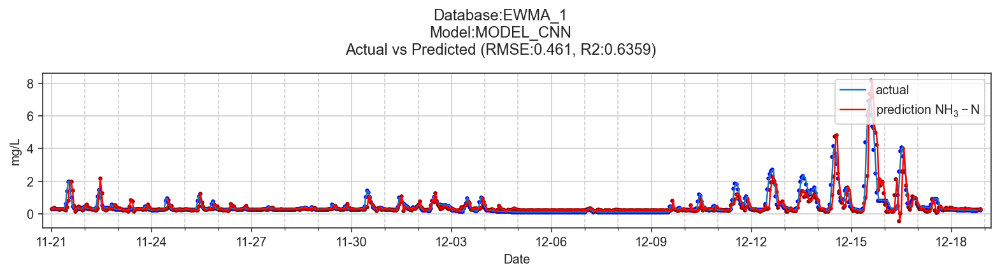

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


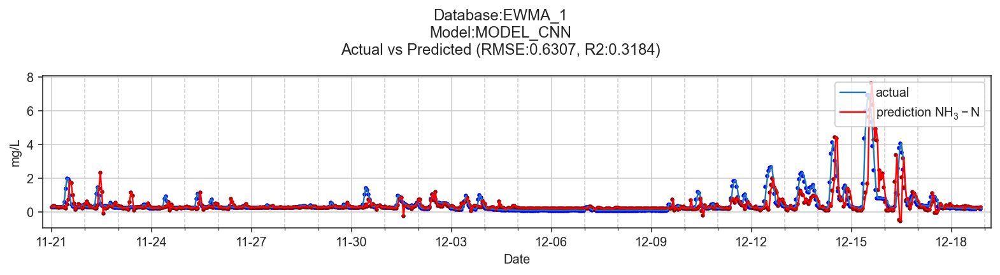

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


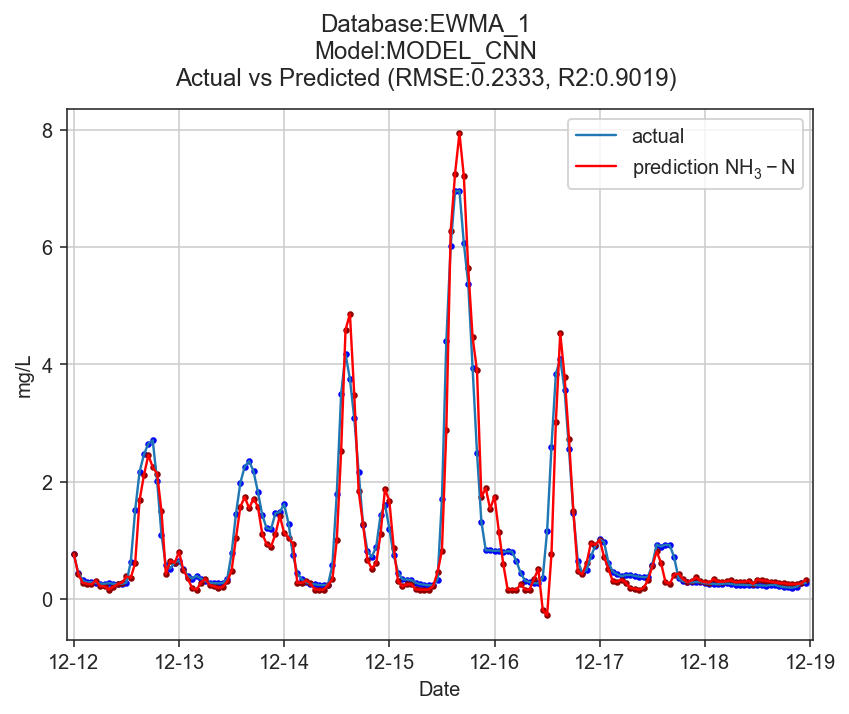

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


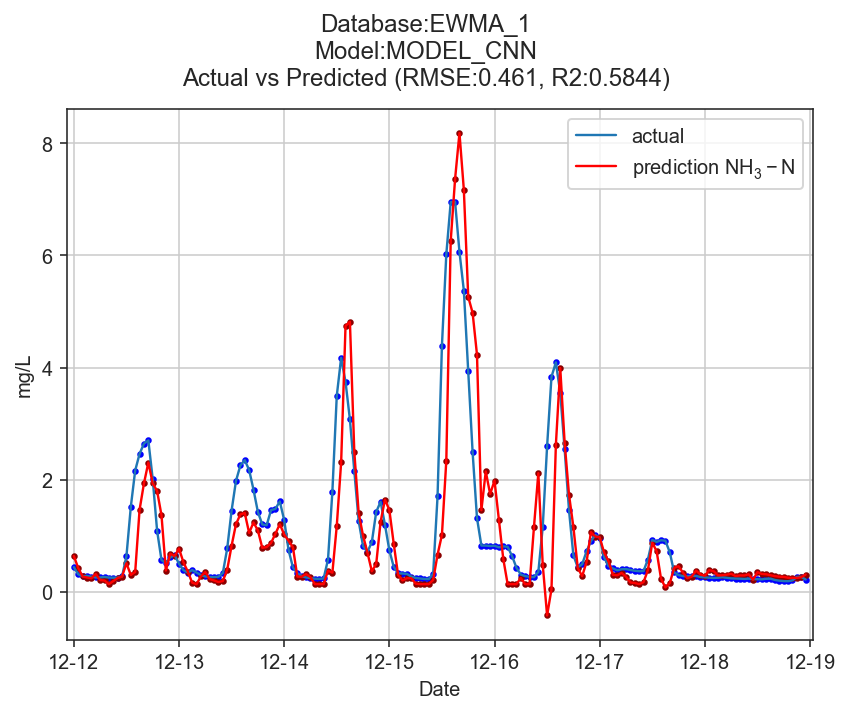

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


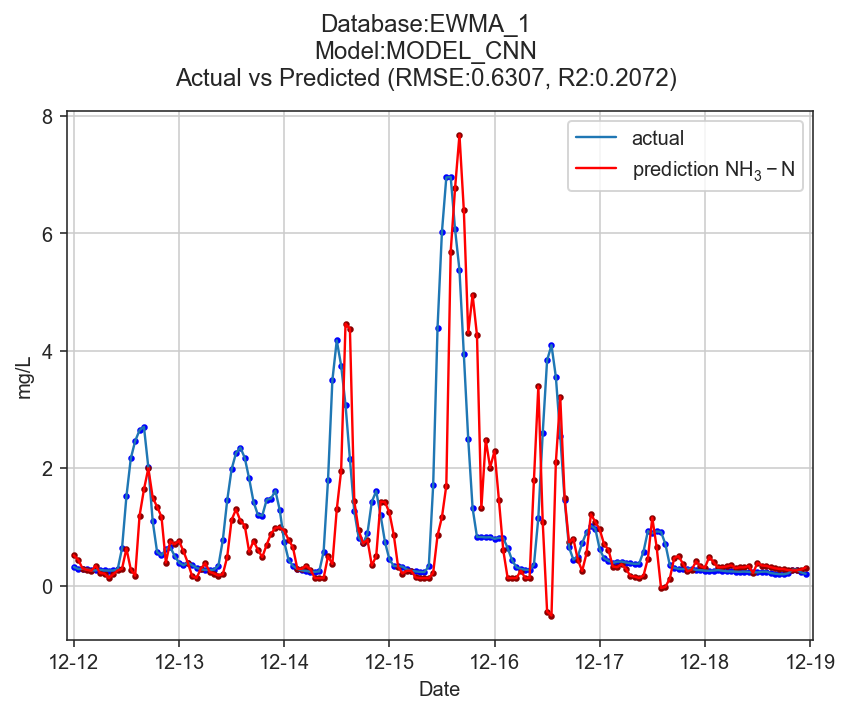

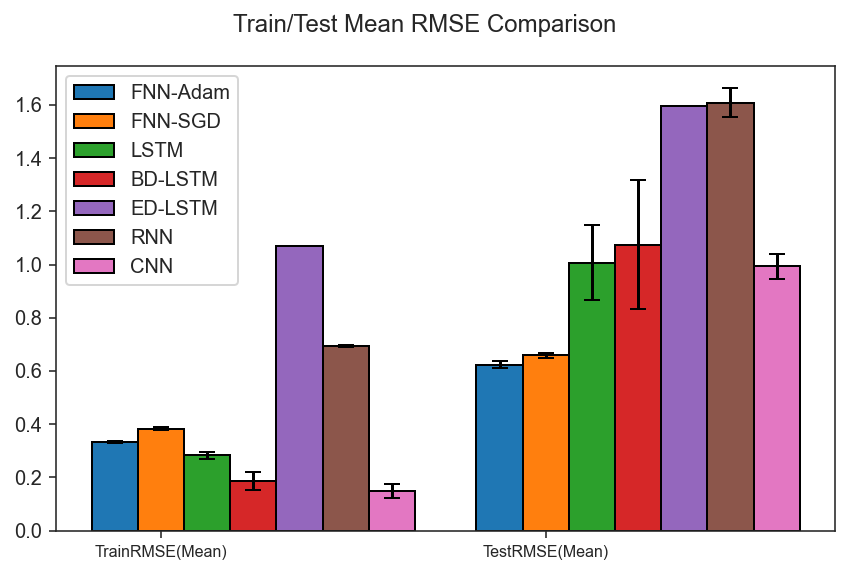

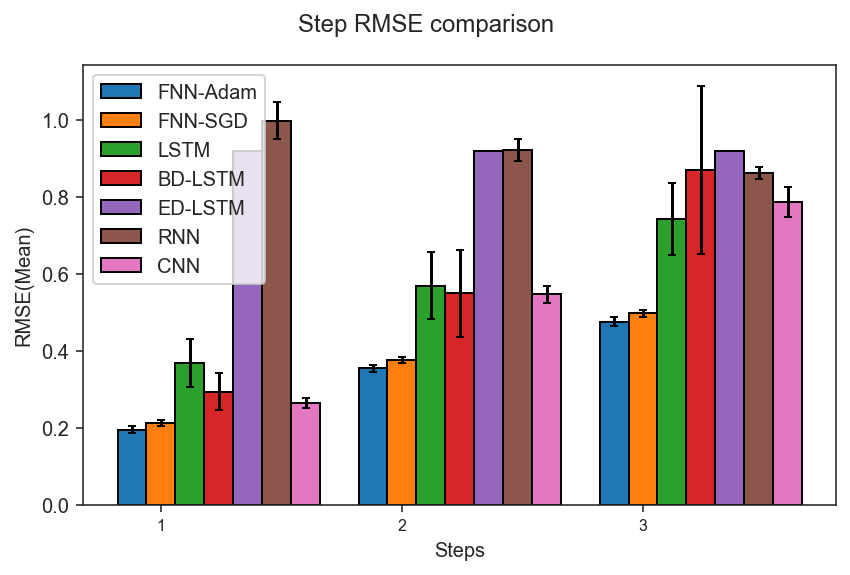

EWMA_2
Experiment 1 in progress
TrainRMSE_Mean 0.2899730318091736
TestRMSE_Mean 0.6277175781458517
Experiment 2 in progress
TrainRMSE_Mean 0.2964448969690498
TestRMSE_Mean 0.6416771350389265
Experiment 3 in progress
TrainRMSE_Mean 0.2767332786078049
TestRMSE_Mean 0.6057776498314624
Experiment 4 in progress
TrainRMSE_Mean 0.29183779350493316
TestRMSE_Mean 0.6166036371751655
Experiment 5 in progress
TrainRMSE_Mean 0.28133954374896664
TestRMSE_Mean 0.5928750296128941
Experiment 6 in progress
TrainRMSE_Mean 0.2683164682642588
TestRMSE_Mean 0.6281319635050205
Experiment 7 in progress
TrainRMSE_Mean 0.2876386729765675
TestRMSE_Mean 0.6295395595741113
Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.2993825052134681
TestRMSE_Mean 0.6171279318182202
Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.28791104353480224
TestRMSE_Mean 0.635825769254375
Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


TrainRMSE_Mean 0.26580005510659593
TestRMSE_Mean 0.6845385129477504
Total time for 10 experiments 11.554738998413086
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.28997   0.62772  0.17744  0.36402  0.47962
Exp2     0.29644   0.64168  0.19339  0.37308  0.48493
Exp3     0.27673   0.60578  0.19222  0.35833  0.44902
Exp4     0.29184   0.61660  0.18507  0.34913  0.47334
Exp5     0.28134   0.59288  0.15712  0.34149  0.45847
Exp6     0.26832   0.62813  0.16800  0.35458  0.49051
Exp7     0.28764   0.62954  0.18161  0.36471  0.47992
Exp8     0.29938   0.61713  0.18381  0.34917  0.47449
Exp9     0.28791   0.63583  0.19551  0.35356  0.49096
Exp10    0.26580   0.68454  0.19726  0.39069  0.52635
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.28454             0.01073  0.27789  0.29119  0.26580  0.29938
TestRMSE   0.62798             0.02329  0.61355  0.64242  0.59288  0.68454
Step1      0.18314             0.01219  0.17559  

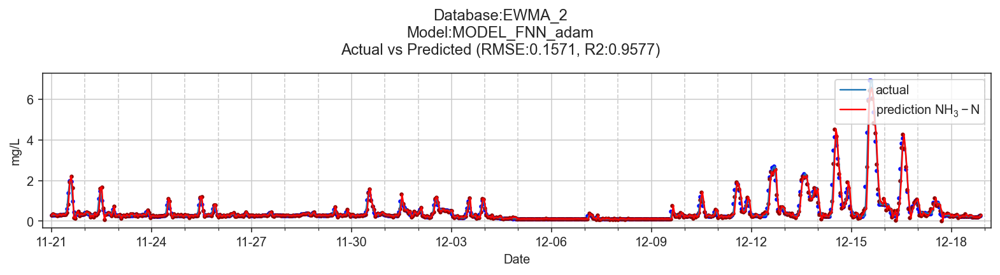

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


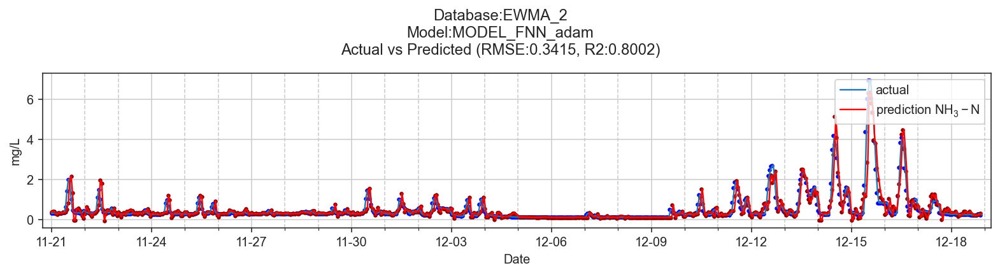

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


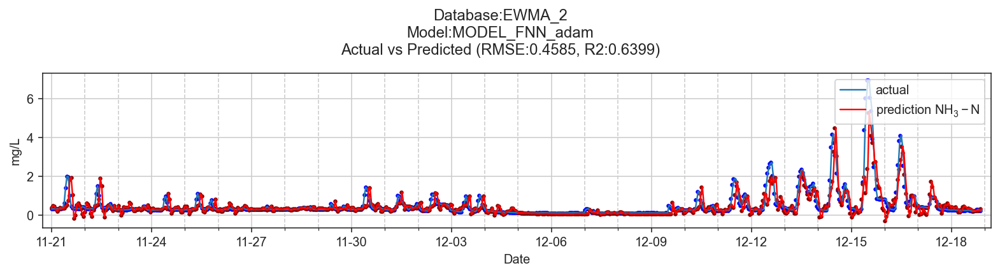

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


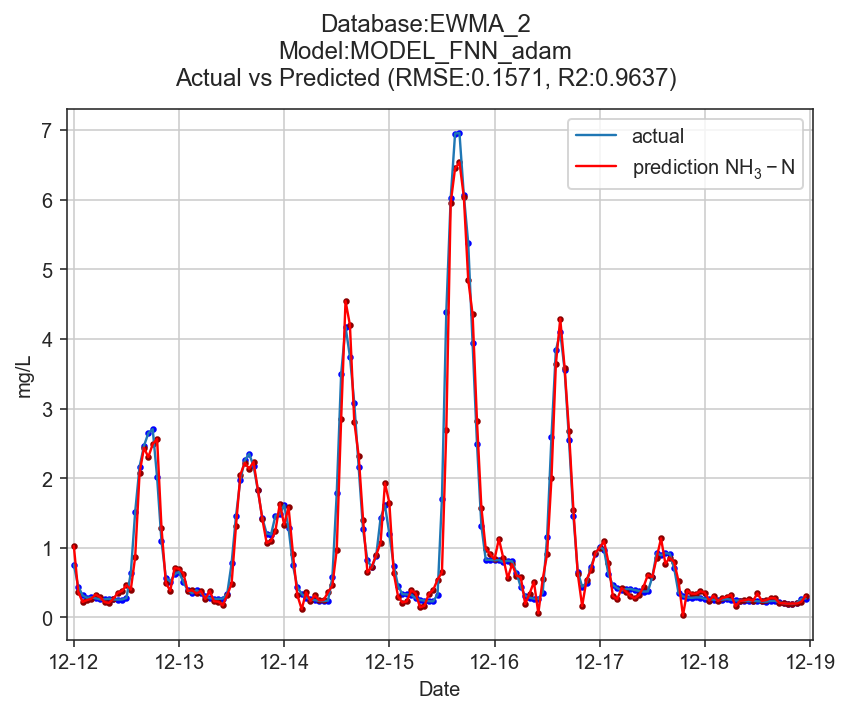

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


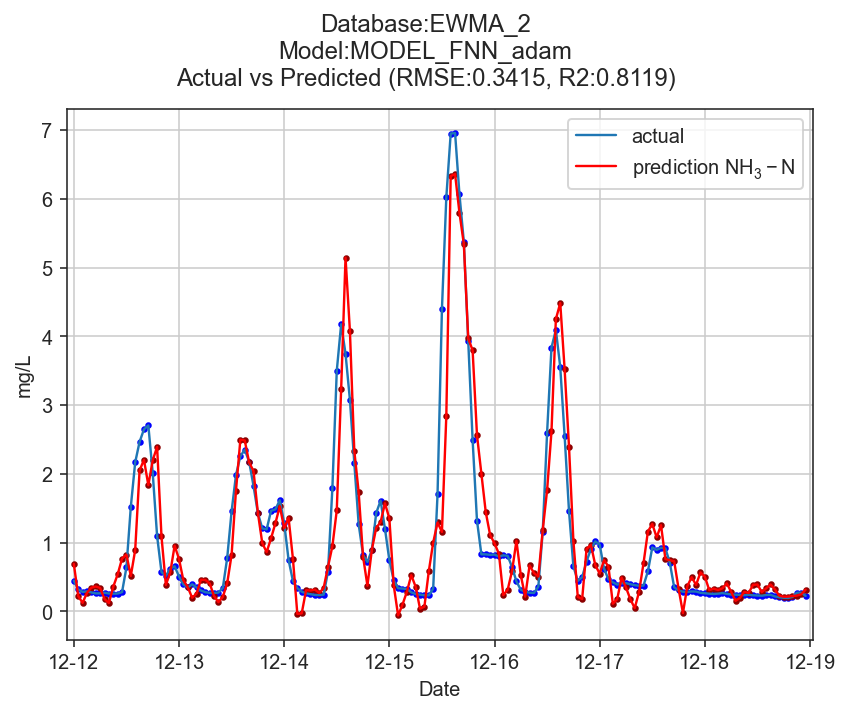

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


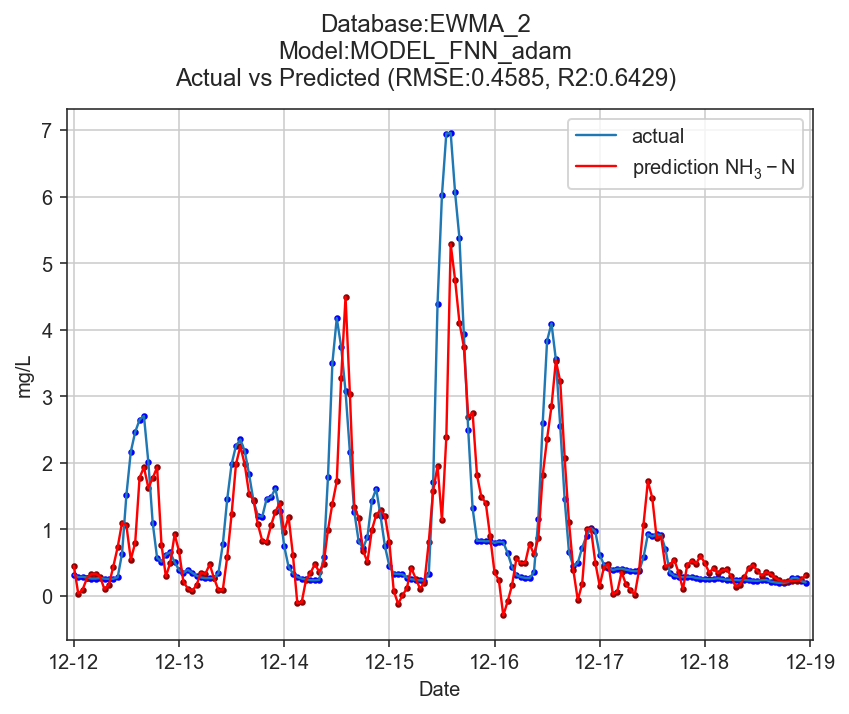

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 11.805346727371216
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.33497   0.68993  0.25354  0.39585  0.50499
Exp2     0.34643   0.69878  0.23654  0.40063  0.52138
Exp3     0.33248   0.67800  0.26014  0.38164  0.49635
Exp4     0.33901   0.71198  0.25599  0.39640  0.53315
Exp5     0.34163   0.70213  0.23968  0.41599  0.51234
Exp6     0.34046   0.69106  0.25112  0.39509  0.50834
Exp7     0.34818   0.72865  0.23765  0.44710  0.52398
Exp8     0.34295   0.71803  0.25483  0.41692  0.52612
Exp9     0.33229   0.68016  0.21246  0.40121  0.50646
Exp10    0.35283   0.71077  0.24478  0.40487  0.53043
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.34112             0.00644  0.33713  0.34511  0.33229  0.35283
TestRMSE   0.70095             0.01569  0.69122  0.71067  0.67800  0.72865
Step1      0.24467             0.01330  0.23643  0.25292  0.21246  0.26014
Step2      0.40557             0.01693  0.3

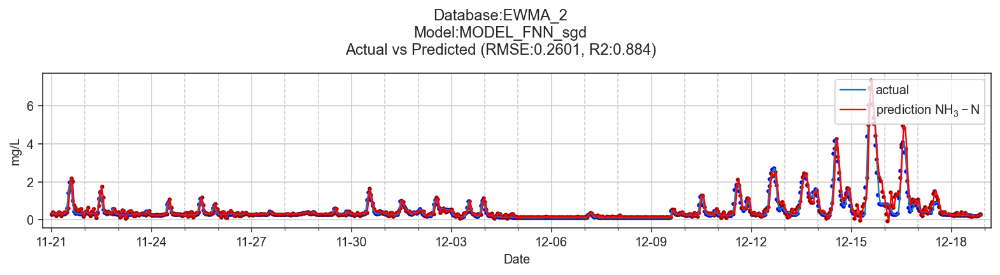

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


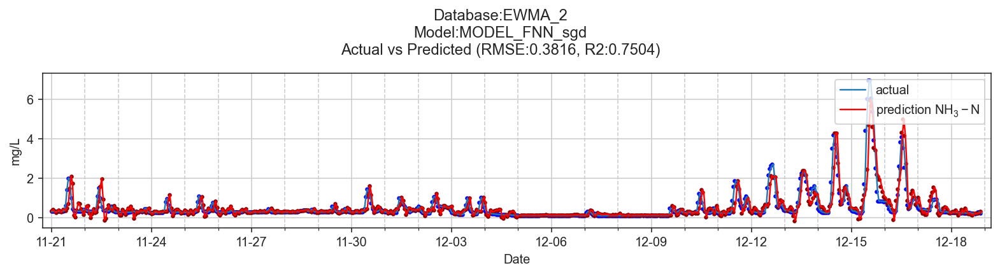

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


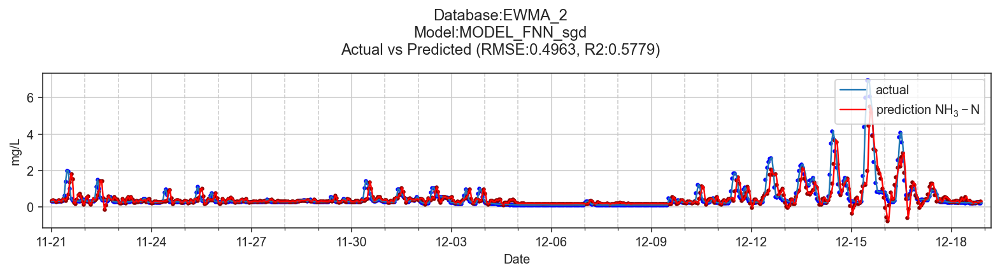

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


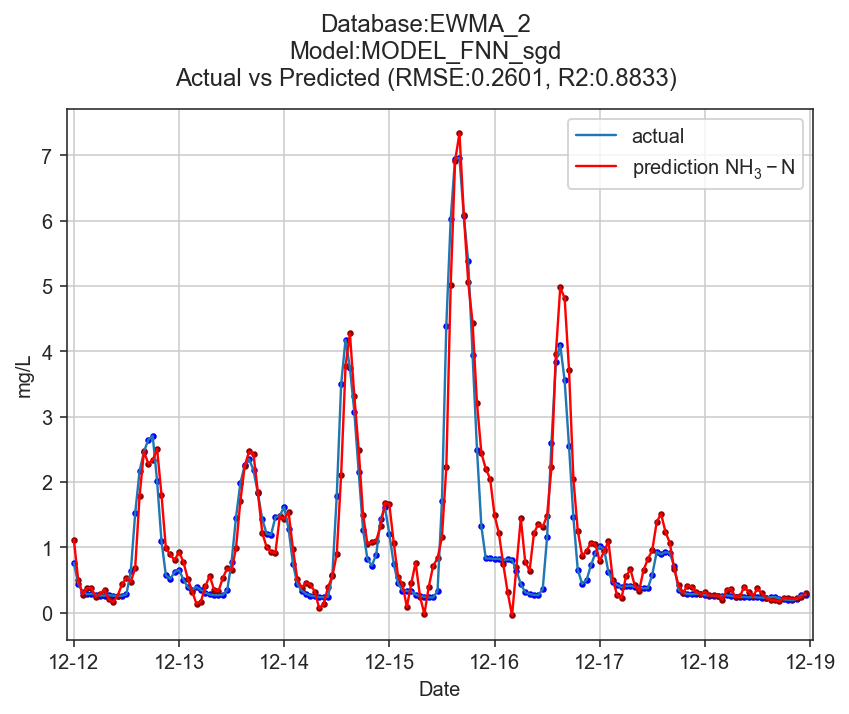

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


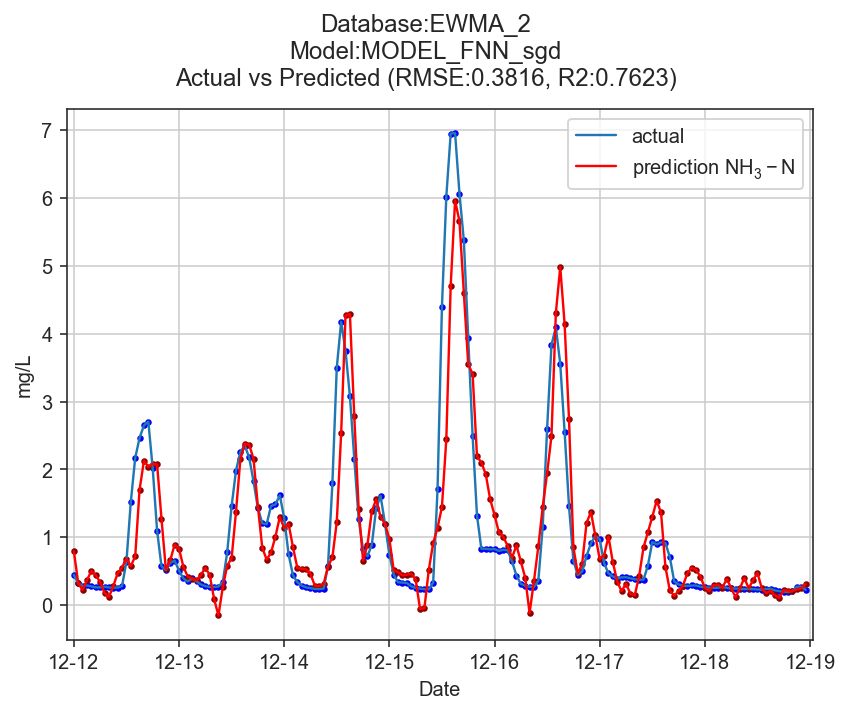

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


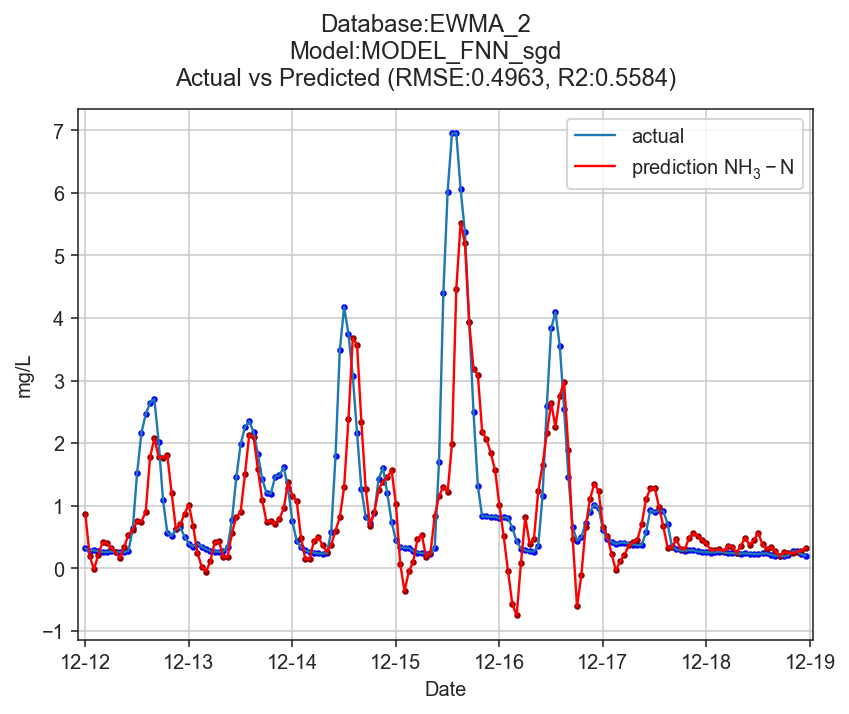

(934, 24, 1)
(670, 24, 1)
Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_16 (LSTM)               (None, 10)                480       
_________________________________________________________________
dense_20 (Dense)             (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 362.24424409866333
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.27530   1.30036  0.86544  0.63349  0.73528
Exp2     0.28891   1.08091  0.42975  0.52708  0.84016
Exp3     0.24837  

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


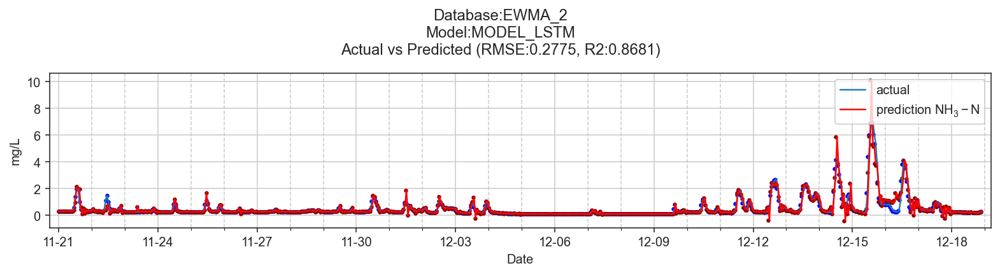

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


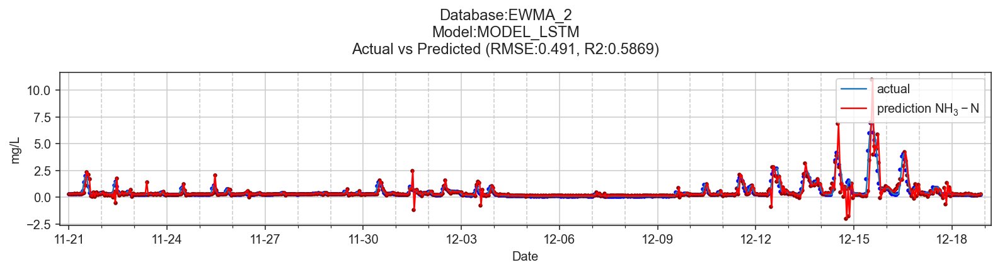

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


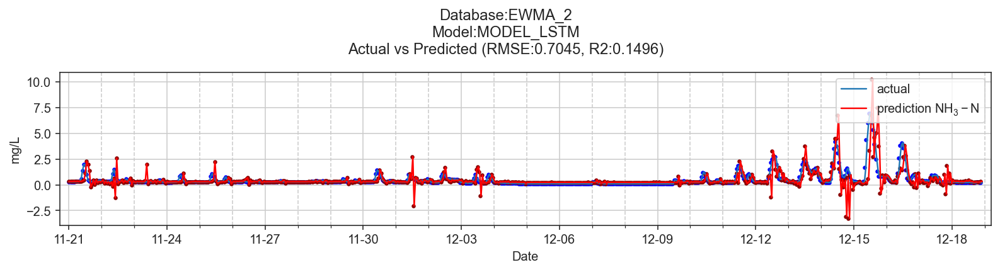

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


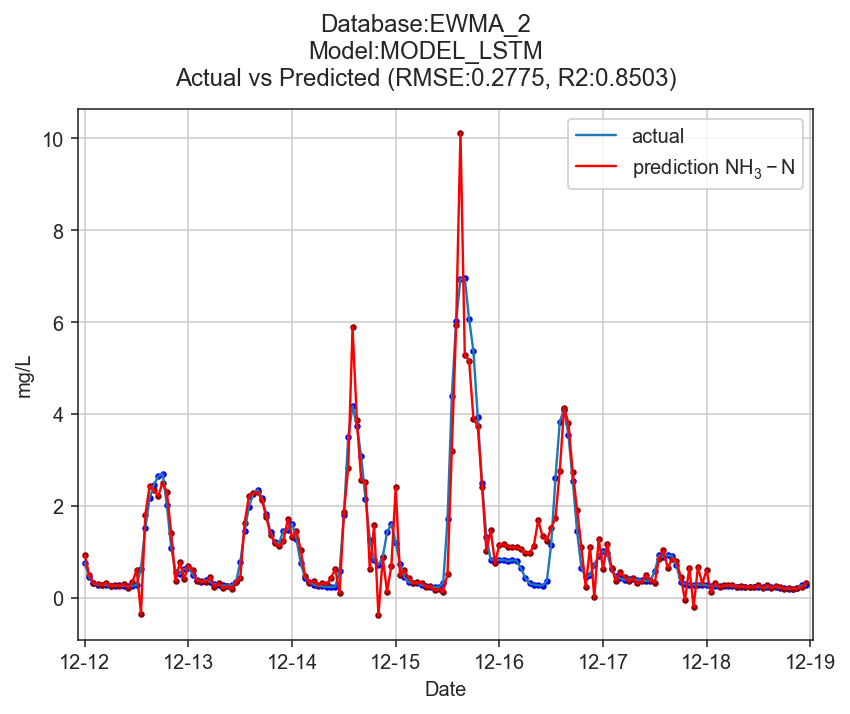

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


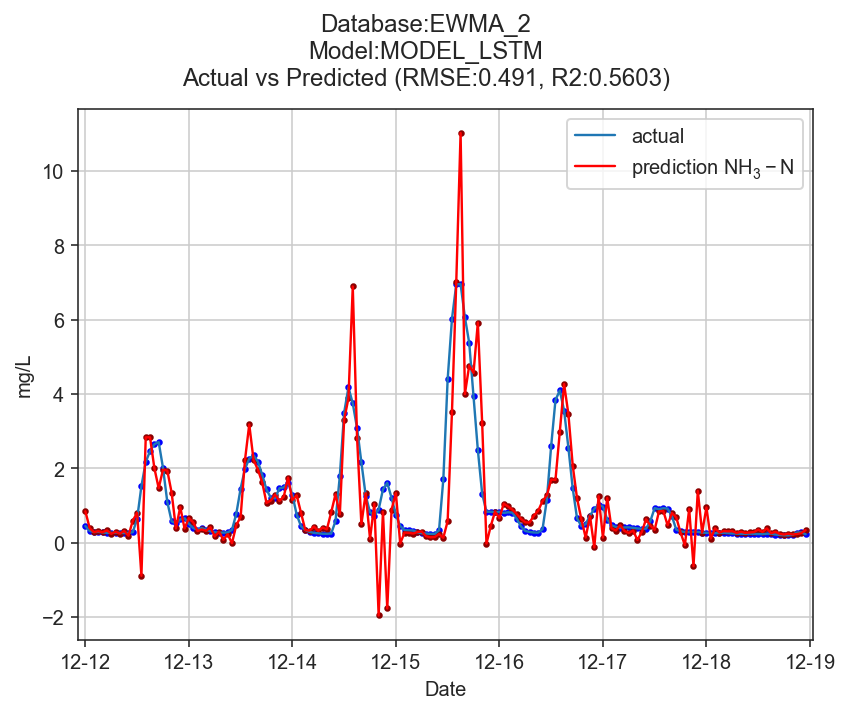

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


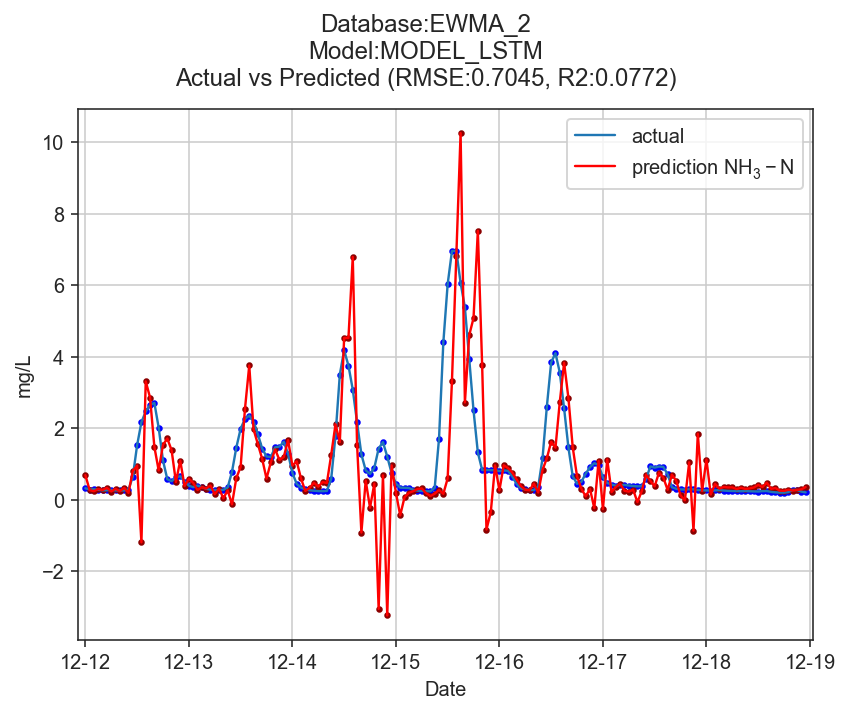

(934, 24, 1)
(670, 24, 1)
Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_4 (Bidirection (None, 20)                960       
_________________________________________________________________
dense_21 (Dense)             (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 428.11337637901306
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.24205   0.89798  0.33546  0.51573  0.65411
Exp2     0.22182   1.39807  0.33139  0.77610  1.11465
Exp3     0.

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


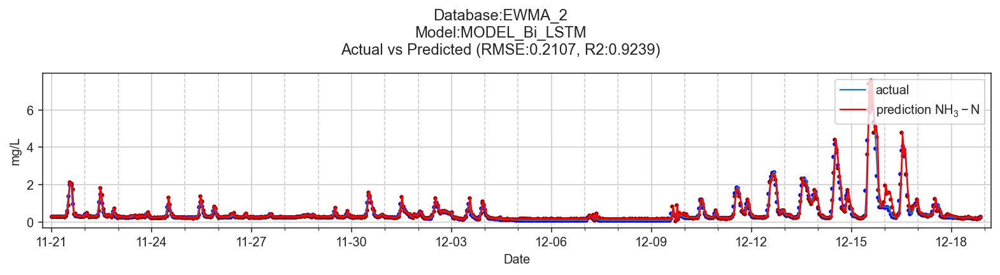

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


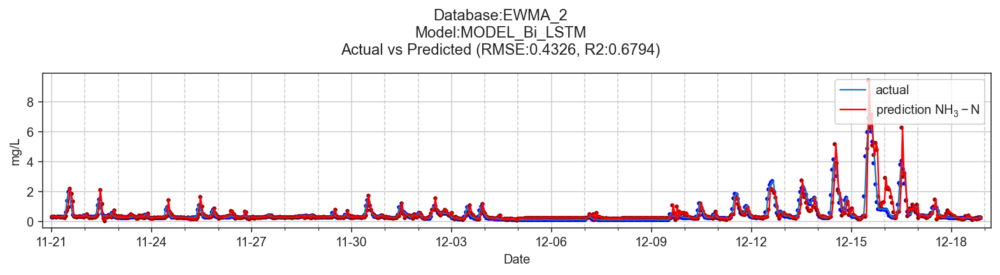

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


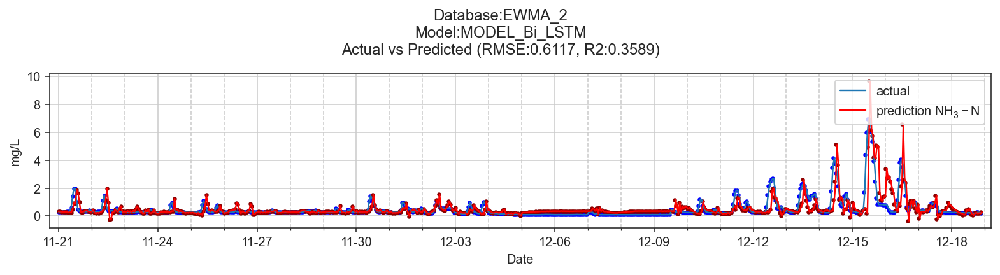

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


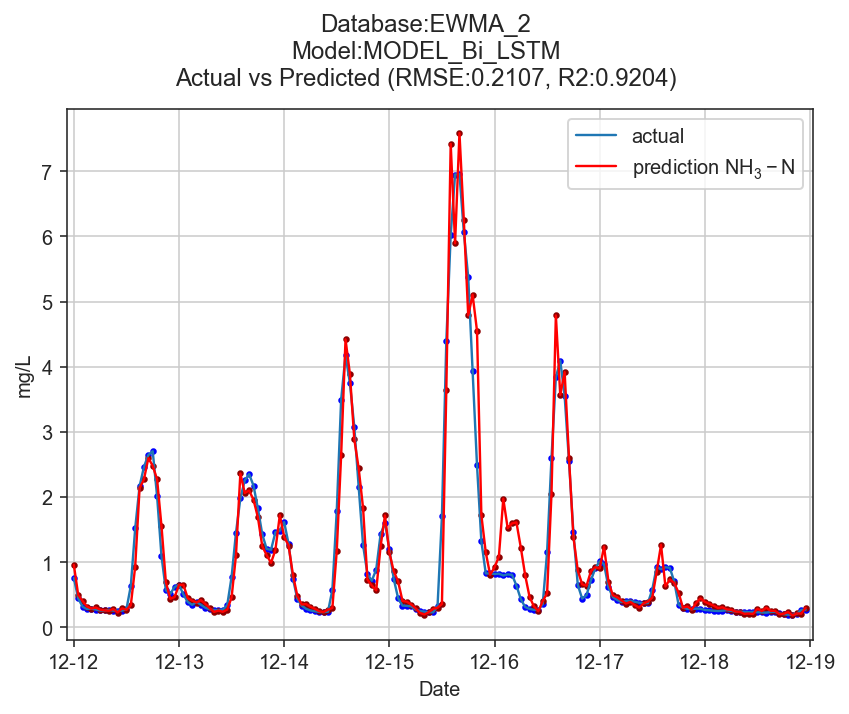

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


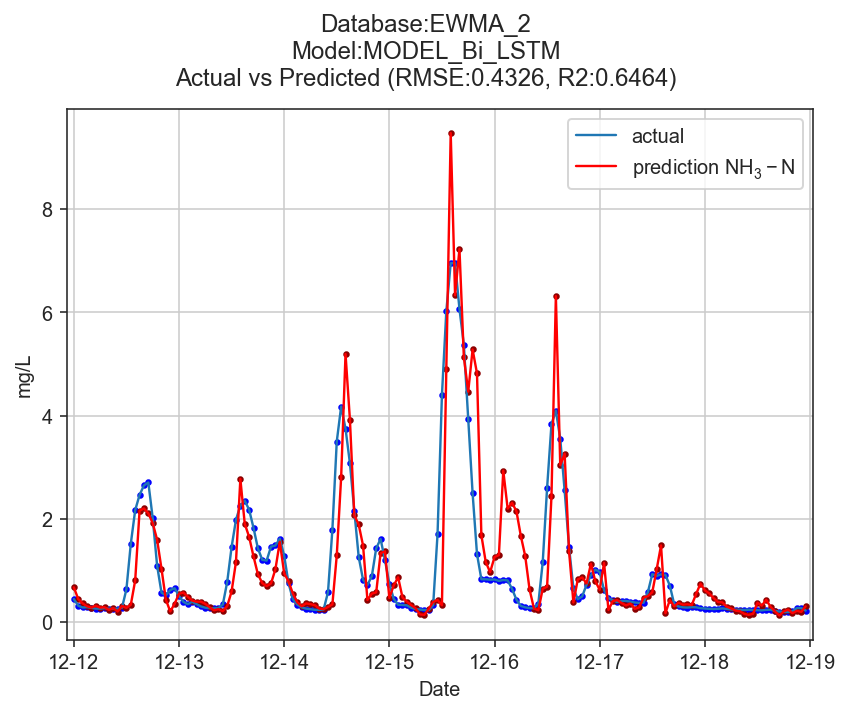

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


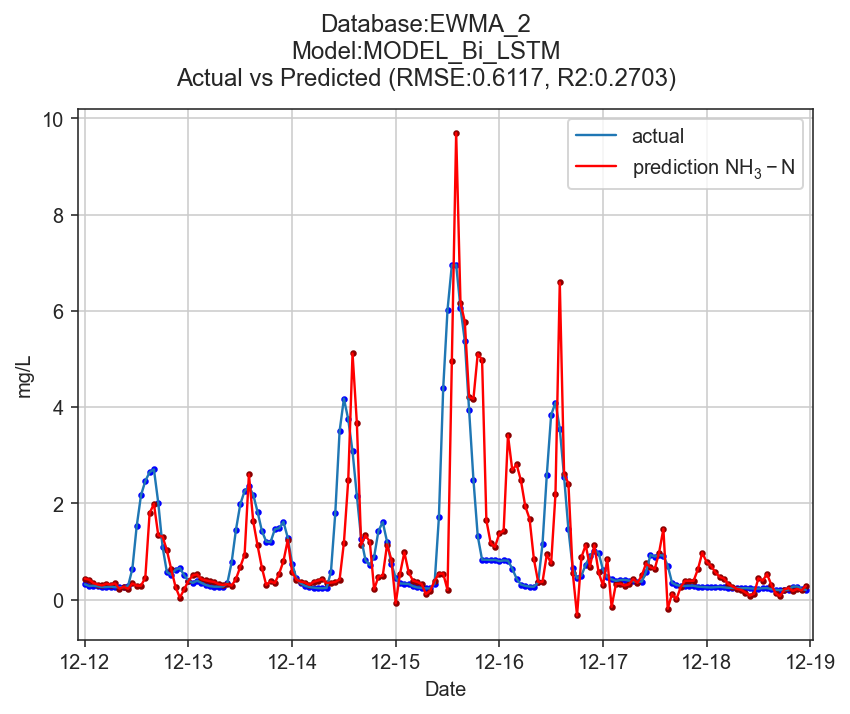

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_18 (LSTM)               (None, 10)                480       
_________________________________________________________________
repeat_vector_4 (RepeatVecto (None, 3, 10)             0         
_________________________________________________________________
lstm_19 (LSTM)               (None, 3, 10)             840       
_________________________________________________________________
time_distributed_4 (TimeDist (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


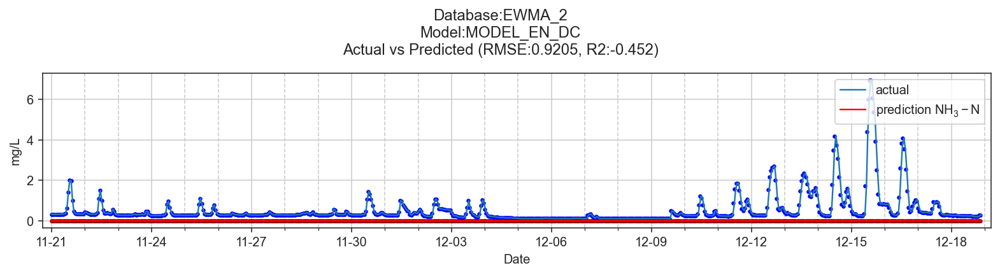

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


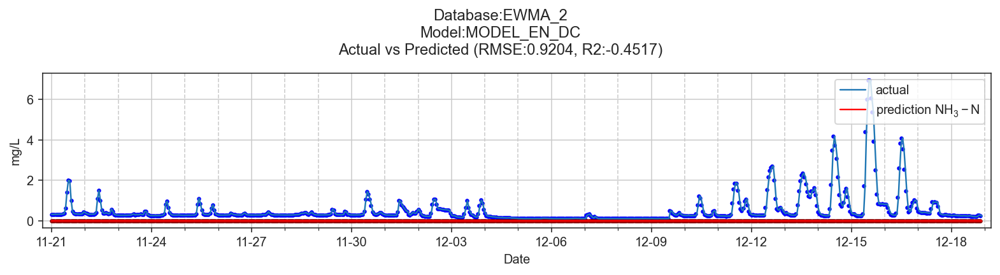

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


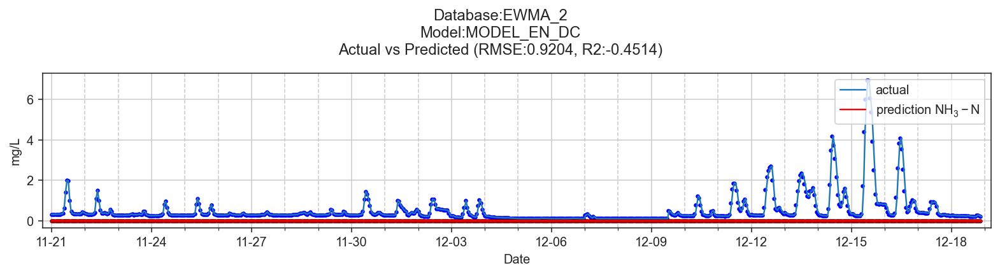

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


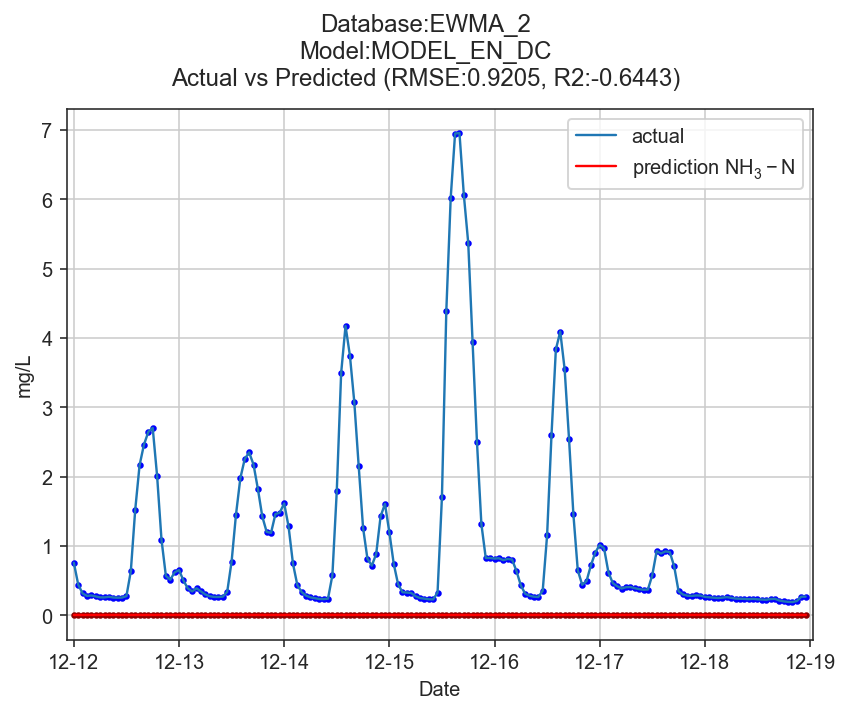

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


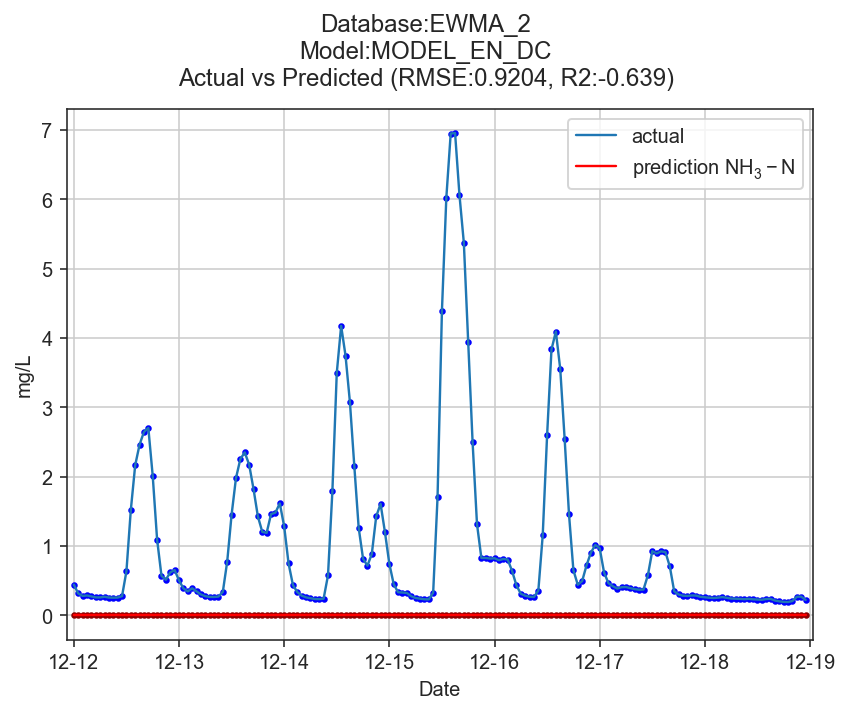

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


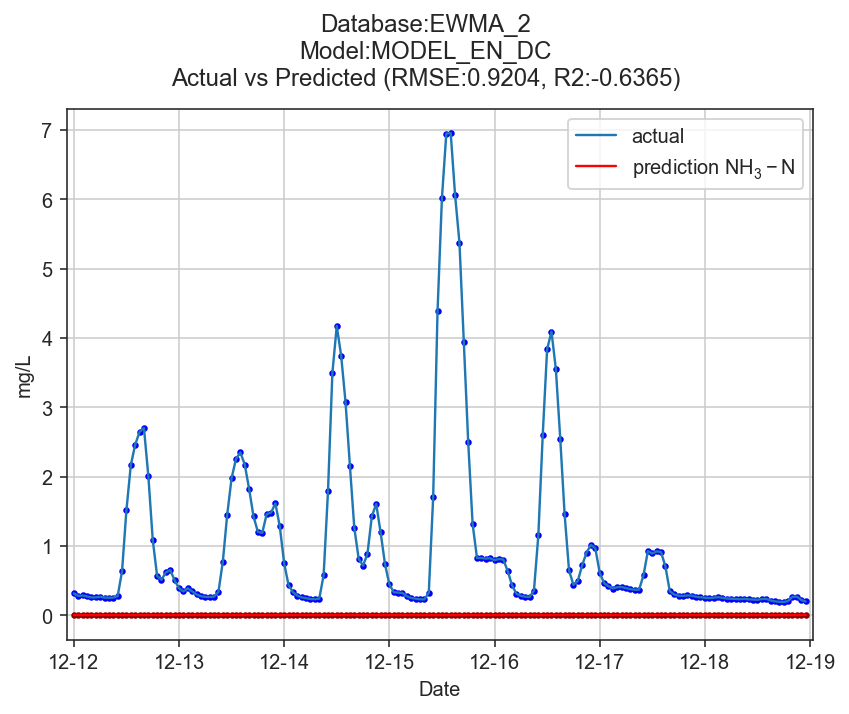

Experiment 1 in progress
TrainRMSE_Mean 0.667357746138241
TestRMSE_Mean 1.6945403227886735
Experiment 2 in progress
TrainRMSE_Mean 0.6747292479863031
TestRMSE_Mean 1.6292582699501923
Experiment 3 in progress
TrainRMSE_Mean 0.6684589967252544
TestRMSE_Mean 1.5305141584908466
Experiment 4 in progress
TrainRMSE_Mean 0.6731377796082446
TestRMSE_Mean 1.621394425169699
Experiment 5 in progress
TrainRMSE_Mean 0.6743030823970861
TestRMSE_Mean 1.5381696382606602
Experiment 6 in progress
TrainRMSE_Mean 0.6767120913597843
TestRMSE_Mean 1.5412557952107566
Experiment 7 in progress
TrainRMSE_Mean 0.6768812209872714
TestRMSE_Mean 1.5761782516207237
Experiment 8 in progress
TrainRMSE_Mean 0.680474643669814
TestRMSE_Mean 1.5863478674204574
Experiment 9 in progress
TrainRMSE_Mean 0.6765010381438913
TestRMSE_Mean 1.7465084429520834
Experiment 10 in progress
TrainRMSE_Mean 0.6785443314802111
TestRMSE_Mean 1.6932239558415303
Total time for 10 experiments 1904.410389661789
MODEL_RNN
       TrainRMSE  TestRM

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


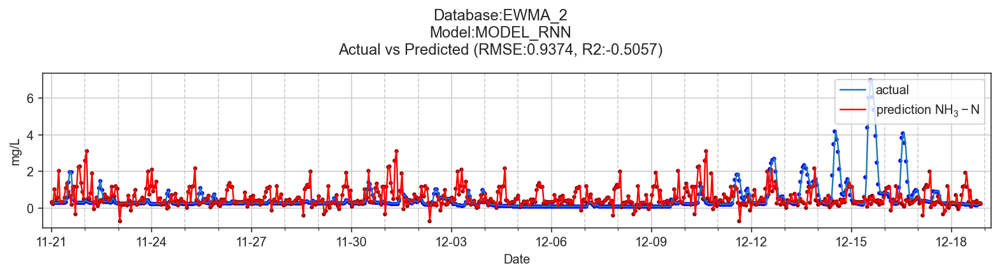

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


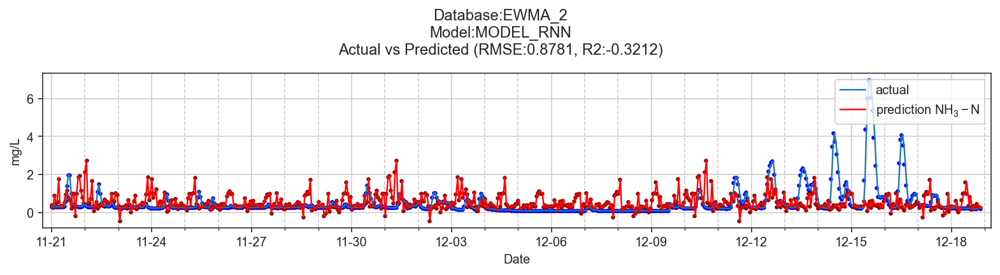

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


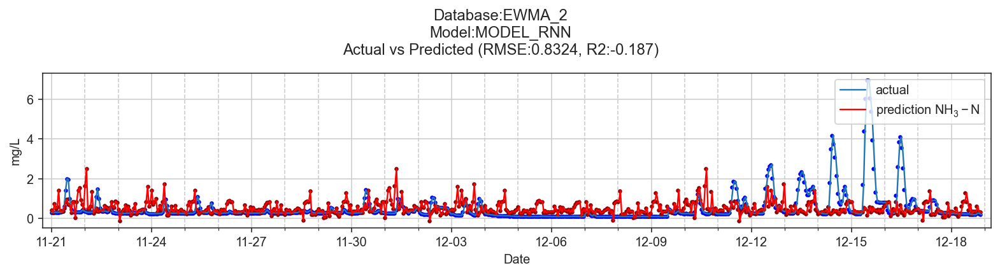

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


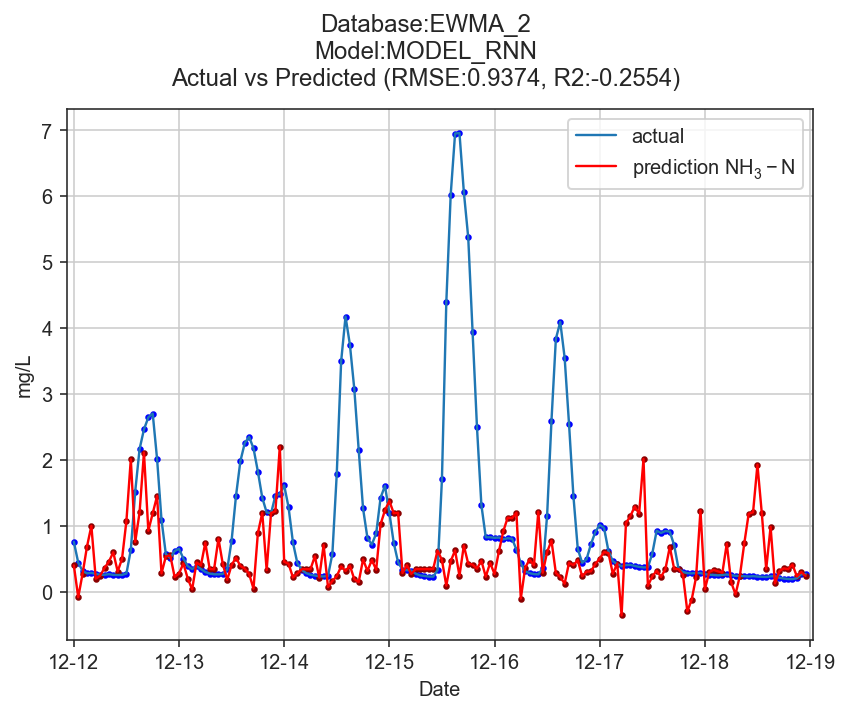

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


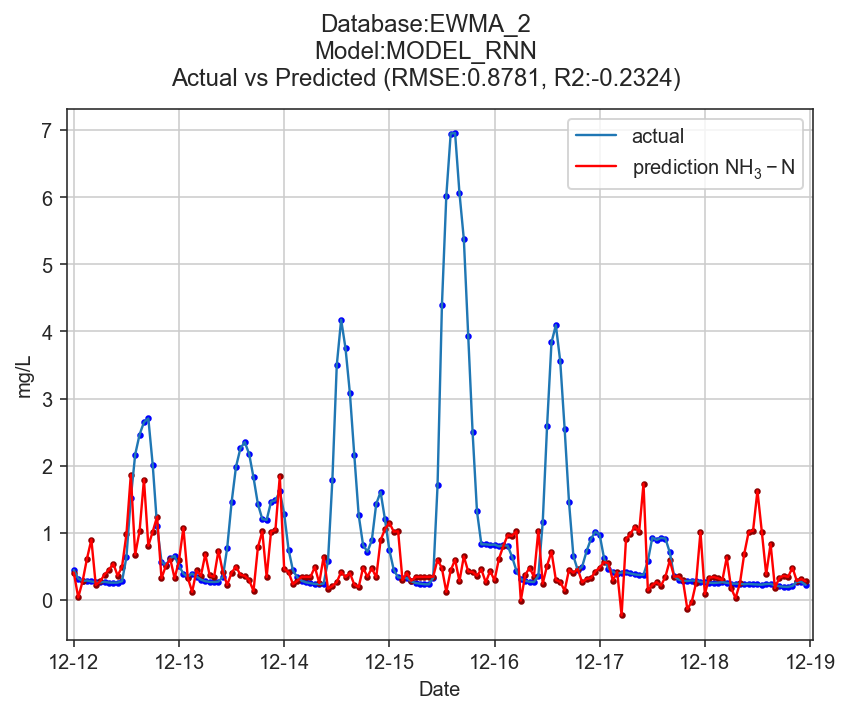

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


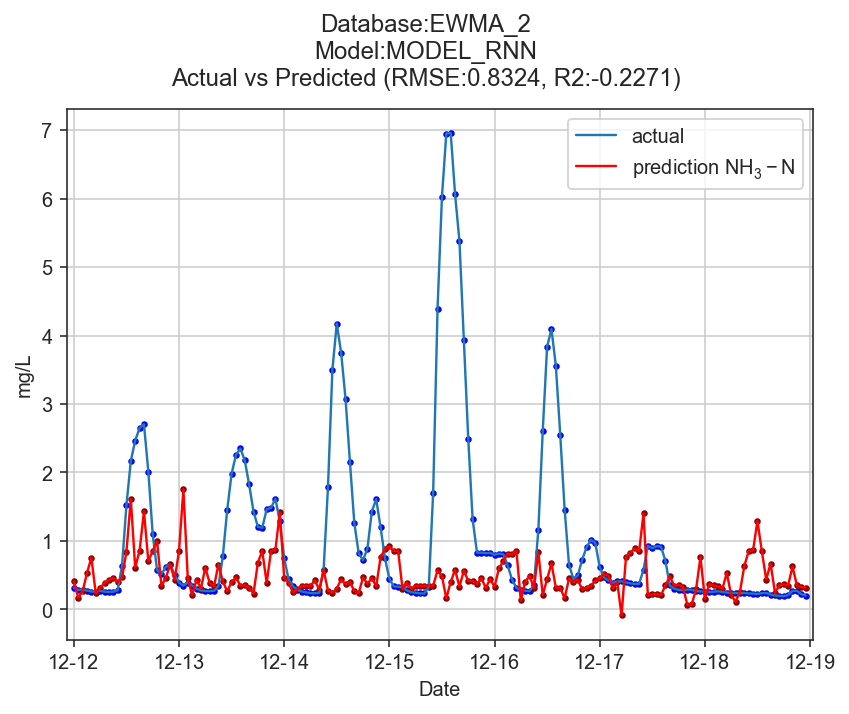

(934, 24, 1)
(670, 24, 1)
Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_4 (Conv1D)            (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d_4 (MaxPooling1 (None, 11, 64)            0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 704)               0         
_________________________________________________________________
dense_23 (Dense)             (None, 10)                7050      
_________________________________________________________________
dense_24 (Dense)             (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


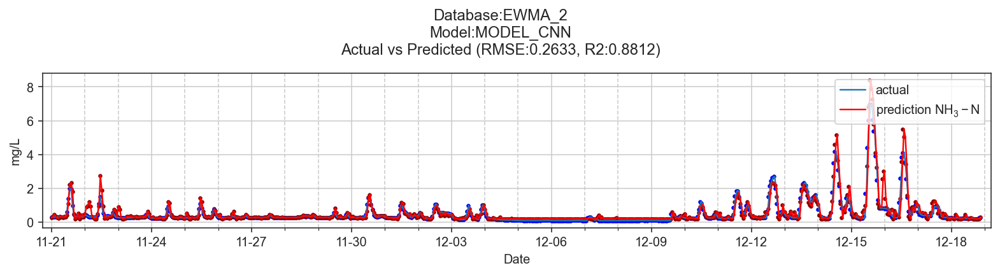

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


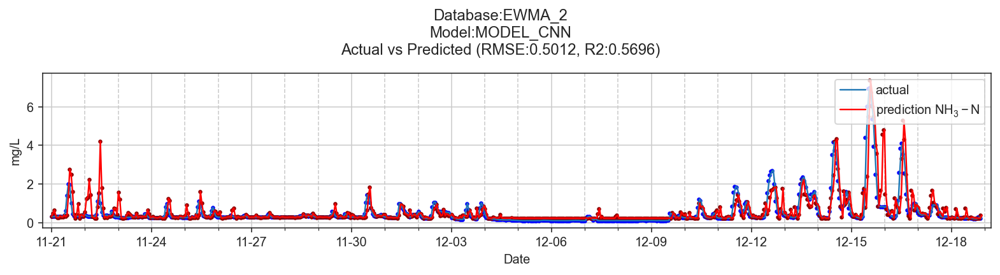

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


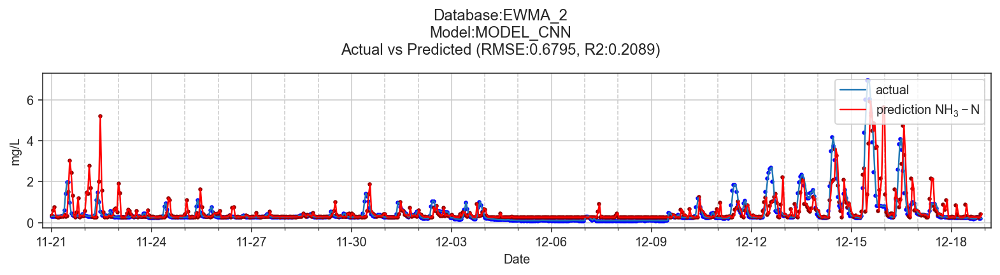

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


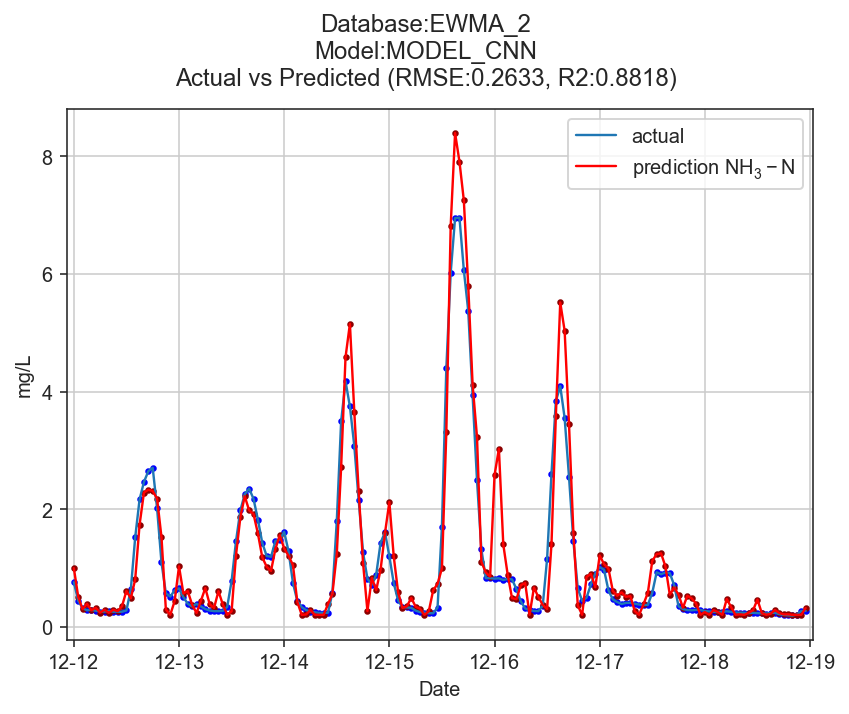

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


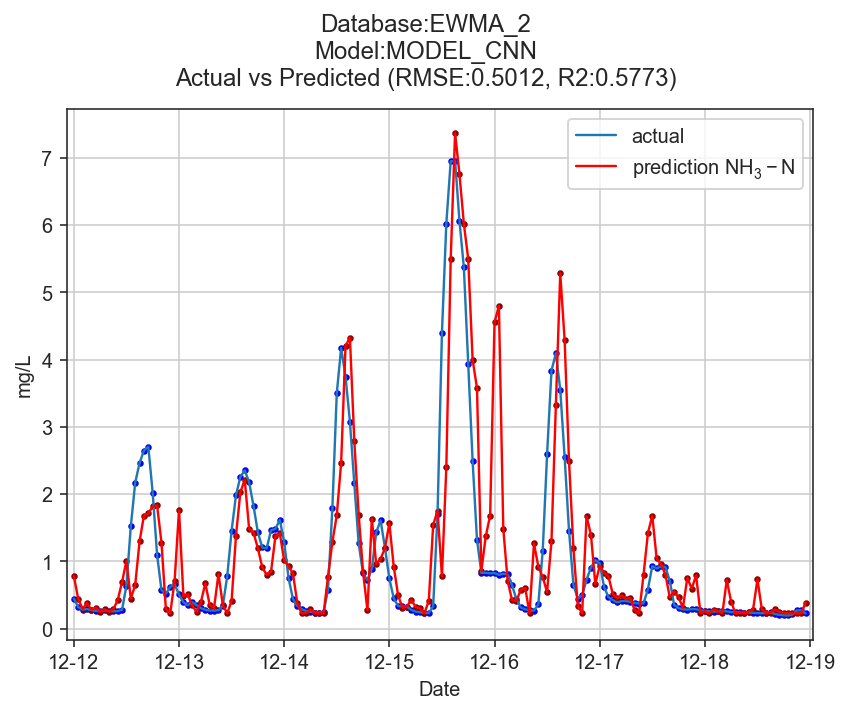

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


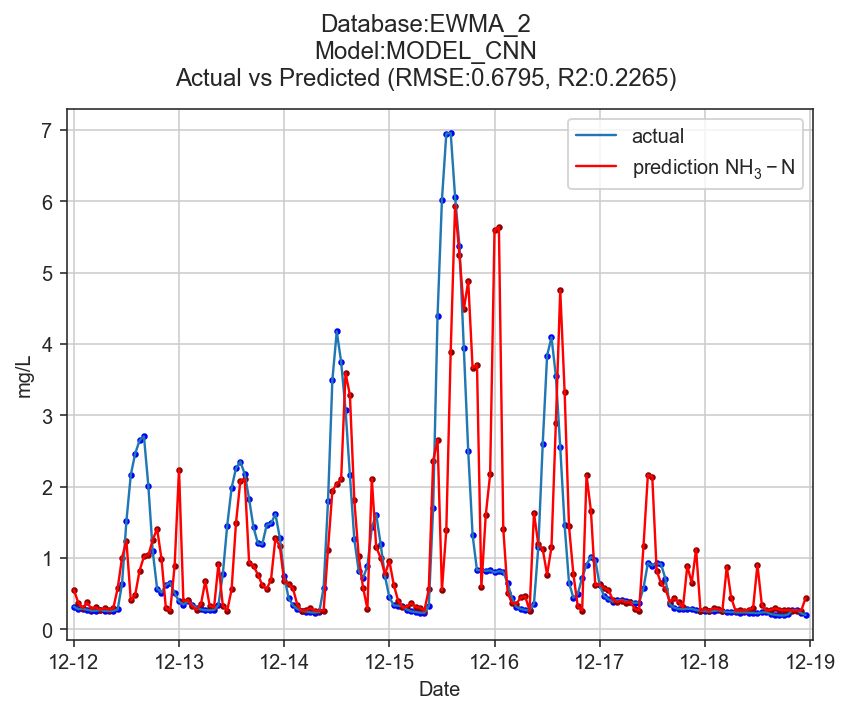

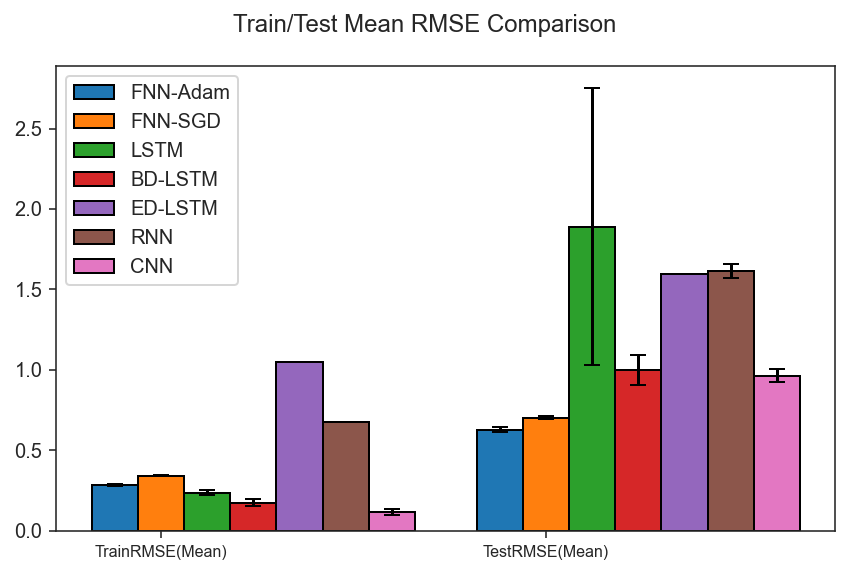

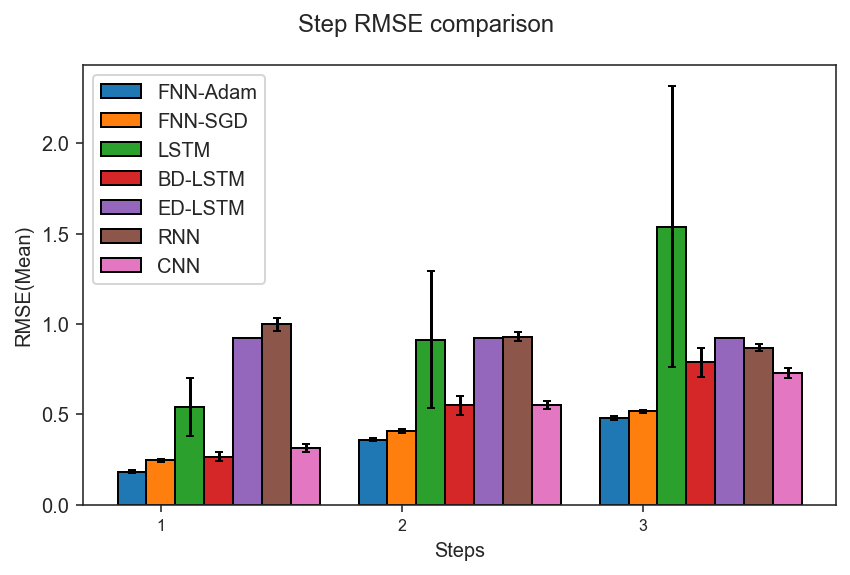

OR_1
Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.36526030517650665
TestRMSE_Mean 0.656926704963733
Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.39750070760429523
TestRMSE_Mean 0.693333166677542
Experiment 3 in progress
TrainRMSE_Mean 0.3873900360132388
TestRMSE_Mean 0.6657719405991648
Experiment 4 in progress
TrainRMSE_Mean 0.360660368016599
TestRMSE_Mean 0.6638045416641355
Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.3753463122573444
TestRMSE_Mean 0.6844568269483313
Experiment 6 in progress
TrainRMSE_Mean 0.4019911053432306
TestRMSE_Mean 0.6248288086327025
Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


TrainRMSE_Mean 0.36840264332612416
TestRMSE_Mean 0.6662843929699734
Experiment 8 in progress
TrainRMSE_Mean 0.3745546721072723
TestRMSE_Mean 0.6890476857745739
Experiment 9 in progress
TrainRMSE_Mean 0.34668226657660317
TestRMSE_Mean 0.6851549448914789
Experiment 10 in progress
TrainRMSE_Mean 0.38984054867010565
TestRMSE_Mean 0.6292245668218319
Total time for 10 experiments 11.985214948654175
MODEL_FNN_adam
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.36526   0.65693  0.18905  0.37312  0.50655
Exp2     0.39750   0.69333  0.20334  0.39623  0.53138
Exp3     0.38739   0.66577  0.20893  0.37378  0.50979
Exp4     0.36066   0.66380  0.17195  0.39043  0.50856
Exp5     0.37535   0.68446  0.18569  0.38728  0.53293
Exp6     0.40199   0.62483  0.17280  0.35982  0.48071
Exp7     0.36840   0.66628  0.18576  0.38139  0.51378
Exp8     0.37455   0.68905  0.20986  0.39415  0.52478
Exp9     0.34668   0.68515  0.20265  0.38441  0.52971
Exp10    0.38984   0.62922  0.17002  0.35861  0.4

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


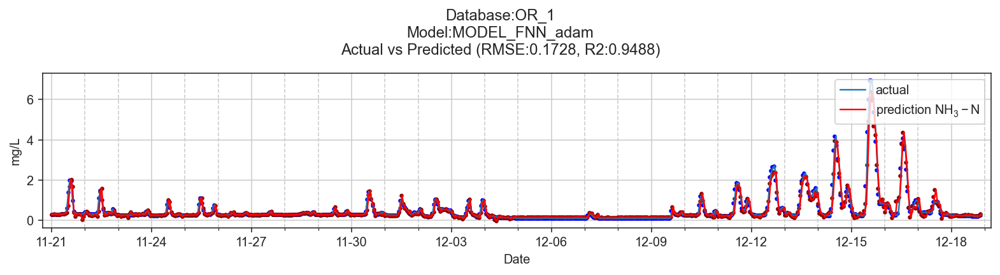

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


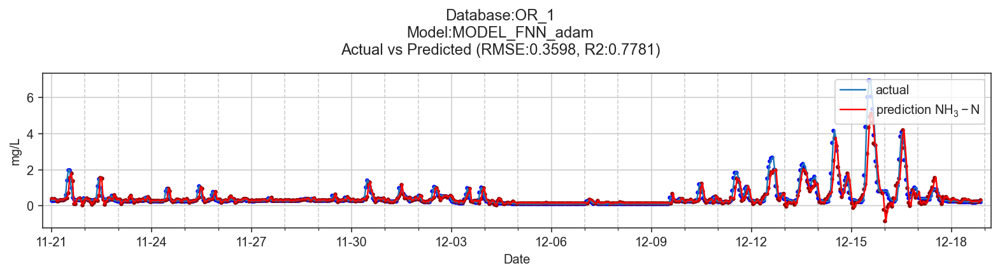

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


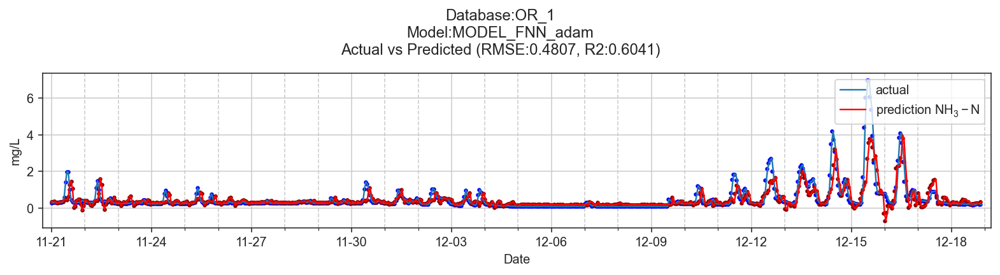

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


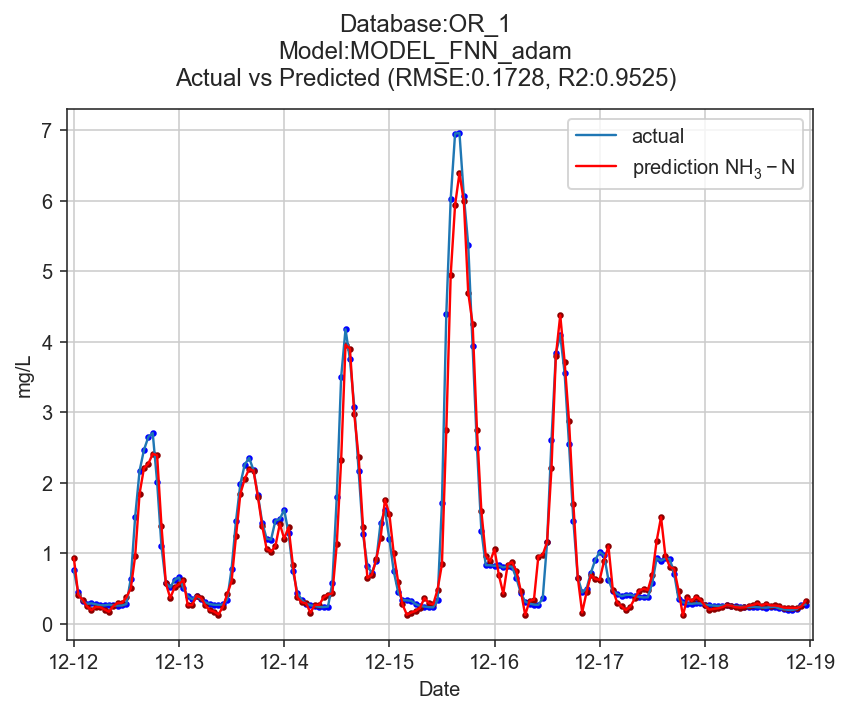

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


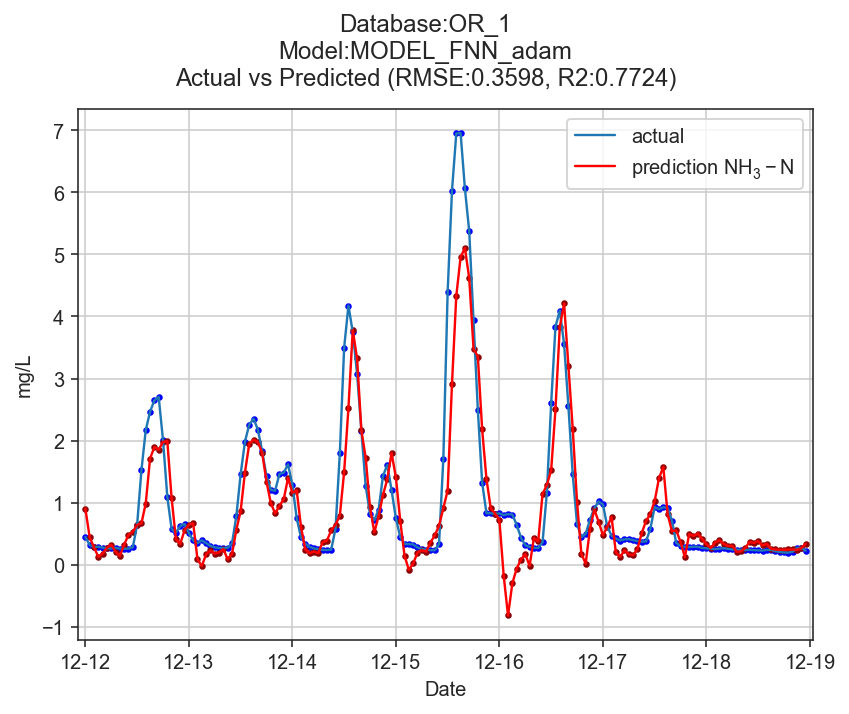

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


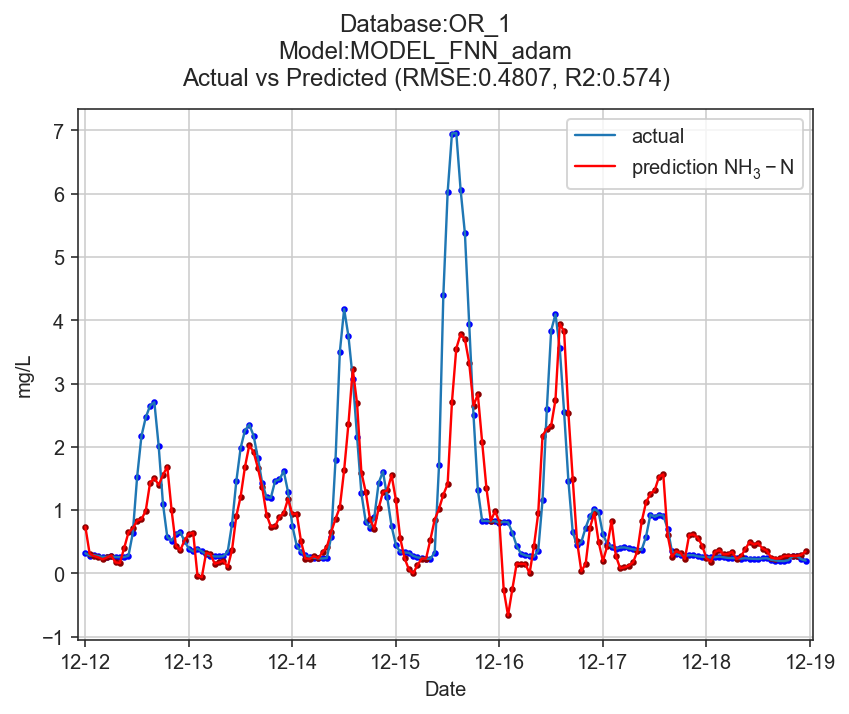

Experiment 1 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 2 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 3 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 4 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 5 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 6 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 7 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 8 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 9 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Experiment 10 in progress


C:\Users\Tim\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(
C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


Total time for 10 experiments 12.411657810211182
MODEL_FNN_sgd
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.43959   0.64979  0.20664  0.37687  0.48734
Exp2     0.43530   0.64210  0.20857  0.35737  0.49099
Exp3     0.44710   0.70641  0.23236  0.40429  0.53063
Exp4     0.43926   0.67542  0.22867  0.38921  0.50241
Exp5     0.45217   0.67538  0.23590  0.39319  0.49588
Exp6     0.43560   0.65690  0.22436  0.36996  0.49429
Exp7     0.44133   0.69019  0.22093  0.40203  0.51568
Exp8     0.43210   0.67874  0.21925  0.38914  0.51106
Exp9     0.43952   0.65775  0.22405  0.38652  0.48273
Exp10    0.44127   0.67505  0.20718  0.39349  0.50788
              Mean  Standard Deviation    CI_LB    CI_UB      Min      Max
TrainRMSE  0.44032             0.00553  0.43690  0.44375  0.43210  0.45217
TestRMSE   0.67077             0.01843  0.65935  0.68219  0.64210  0.70641
Step1      0.22079             0.00992  0.21464  0.22694  0.20664  0.23590
Step2      0.38621             0.01371  0.3

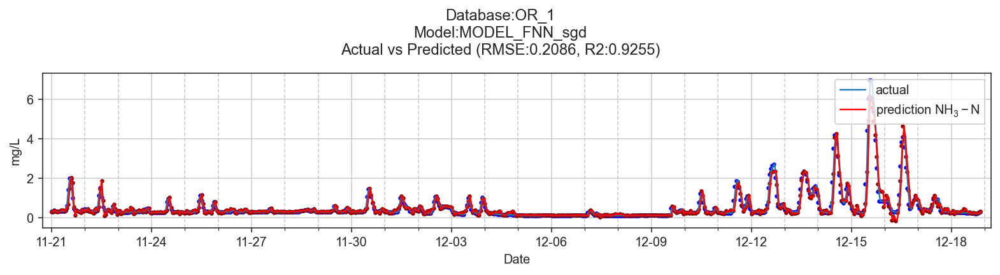

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


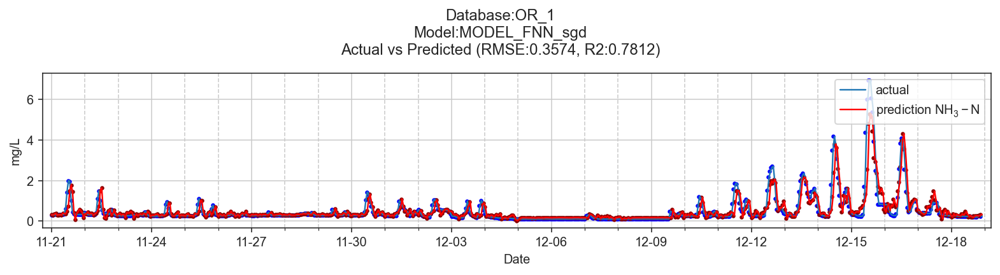

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


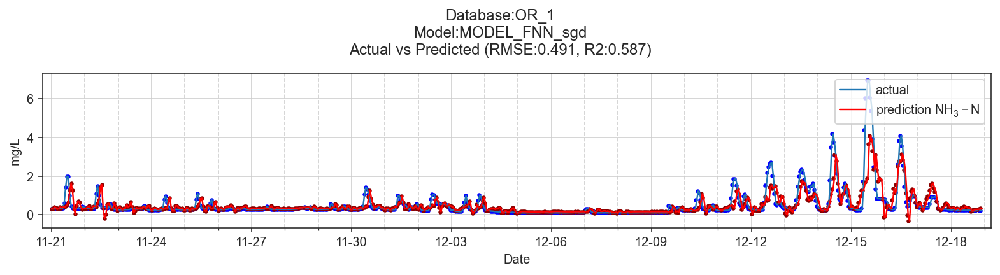

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


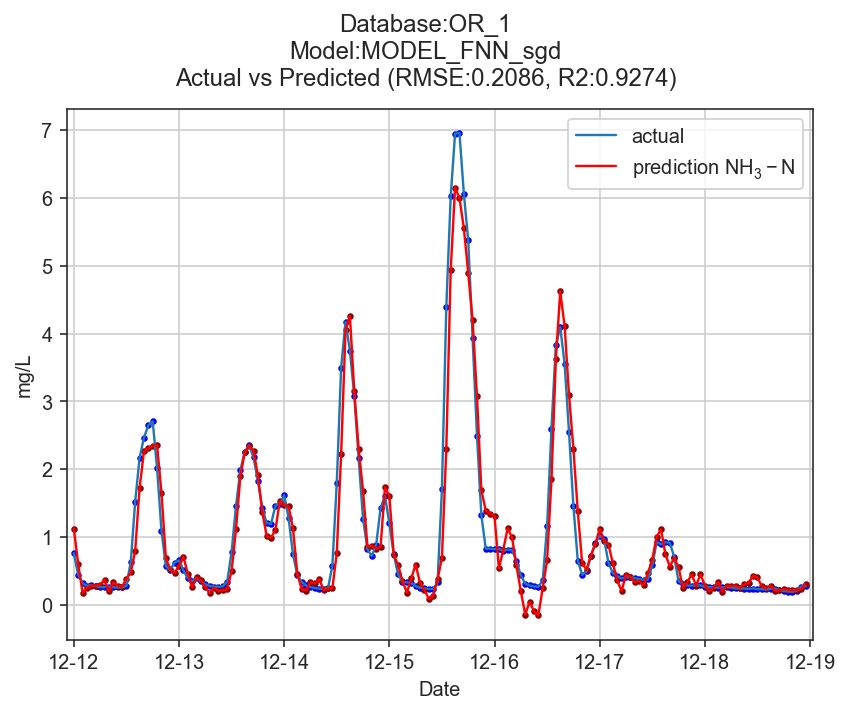

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


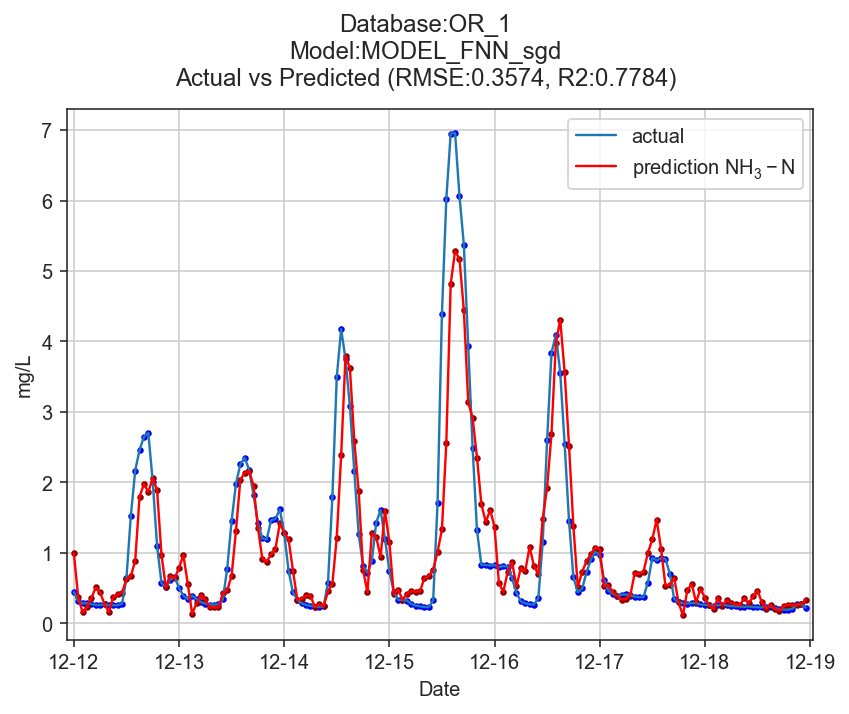

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


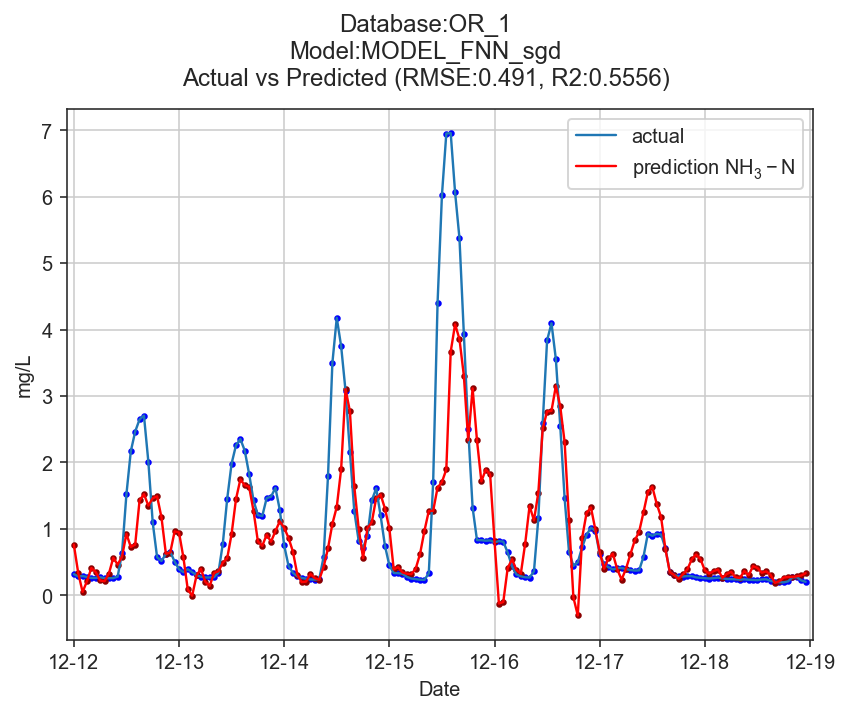

(934, 24, 1)
(670, 24, 1)
Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_20 (LSTM)               (None, 10)                480       
_________________________________________________________________
dense_25 (Dense)             (None, 3)                 33        
Total params: 513
Trainable params: 513
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 364.0688199996948
MODEL_LSTM
       TrainRMSE  TestRMSE    Step1    Step2    Step3
Exp1     0.39843   0.67554  0.18315  0.38853  0.52140
Exp2     0.38013   1.45175  0.27765  0.81351  1.16991
Exp3     0.36121   

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


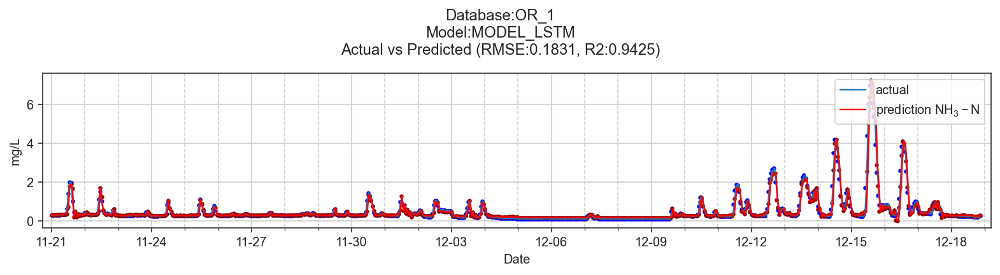

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


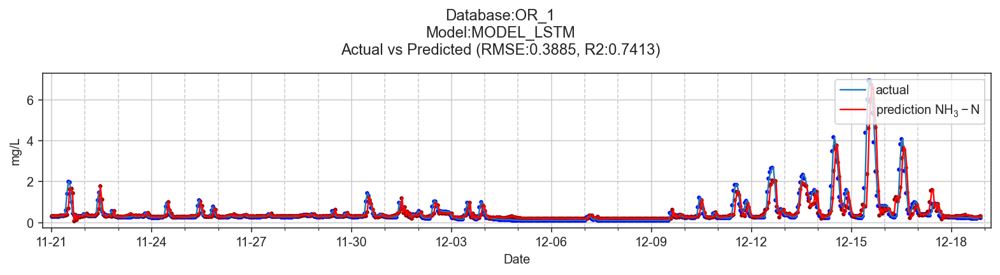

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


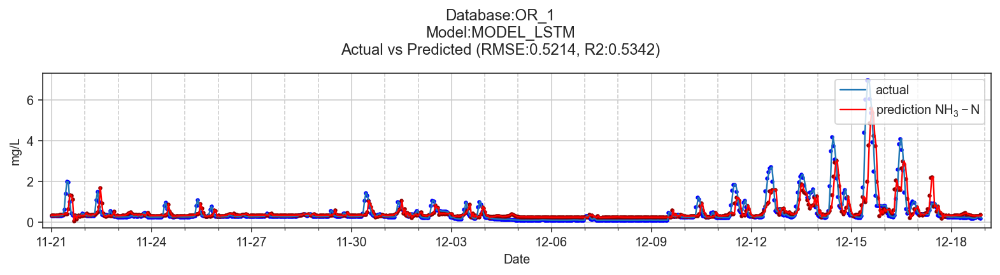

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


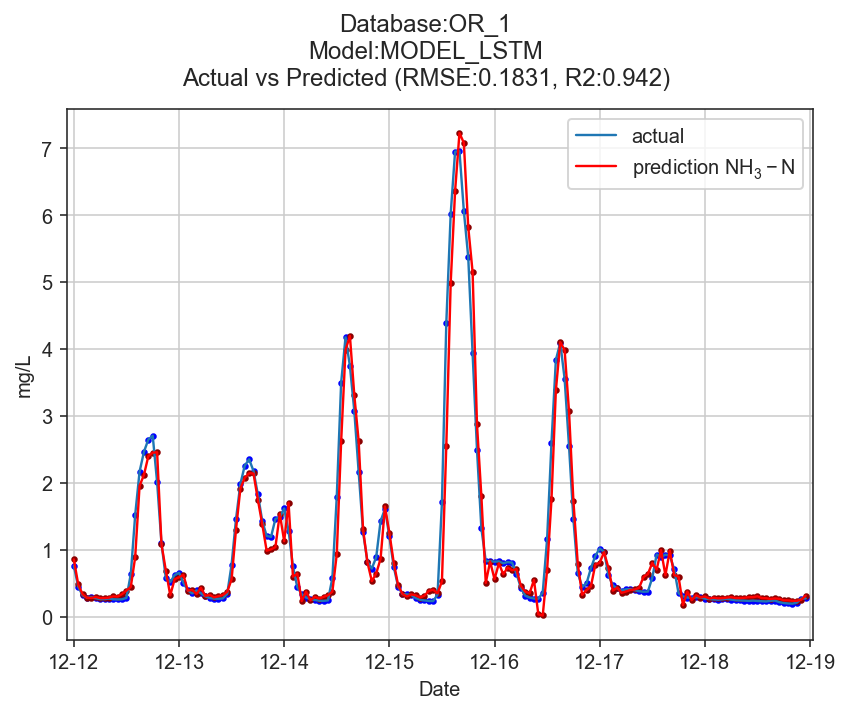

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


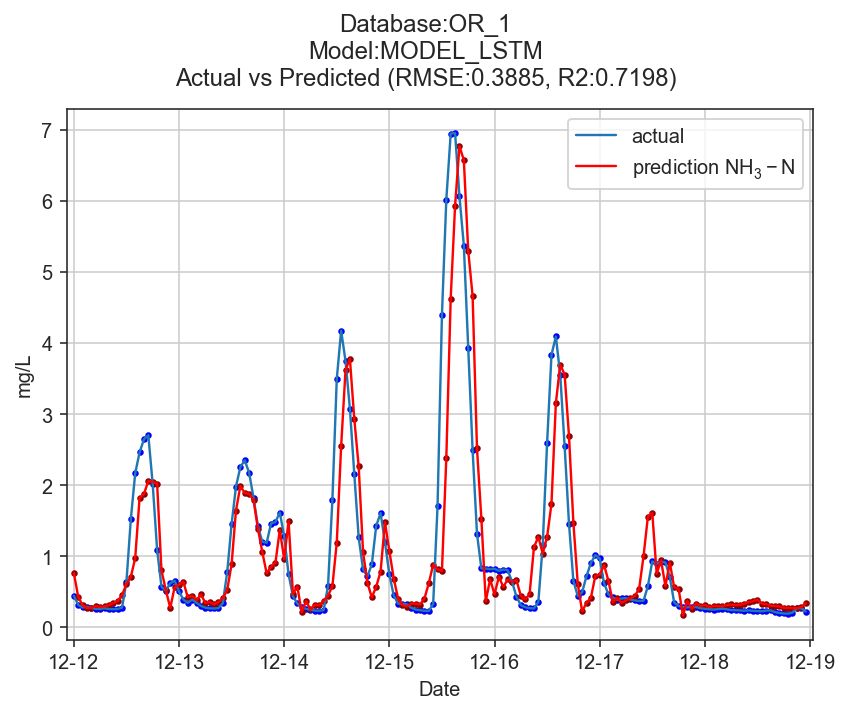

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


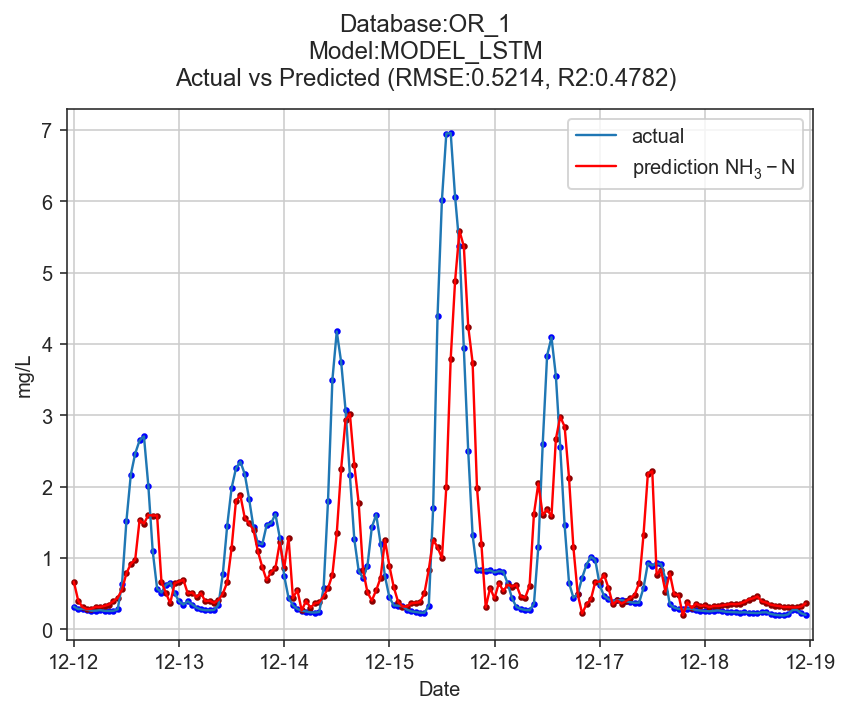

(934, 24, 1)
(670, 24, 1)
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
bidirectional_5 (Bidirection (None, 20)                960       
_________________________________________________________________
dense_26 (Dense)             (None, 3)                 63        
Total params: 1,023
Trainable params: 1,023
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress
Experiment 9 in progress
Experiment 10 in progress
Total time for 10 experiments 432.3496091365814
MODEL_Bi_LSTM
       TrainRMSE  TestRMSE    Step1     Step2     Step3
Exp1     0.35565   4.09201  1.31664   0.86380   3.77689
Exp2     0.30947  33.16315  5.23954  15.92440  28.61390
Exp3  

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


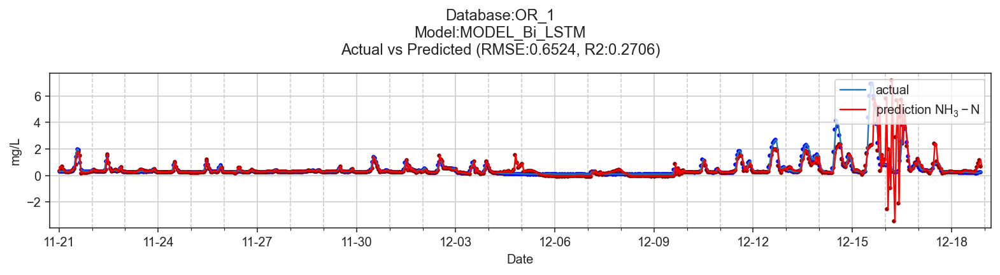

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


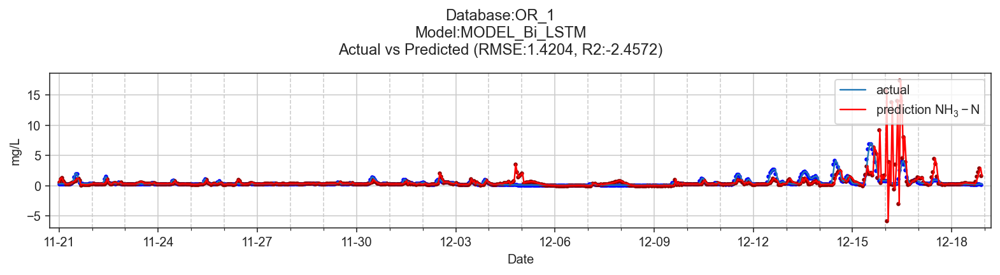

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


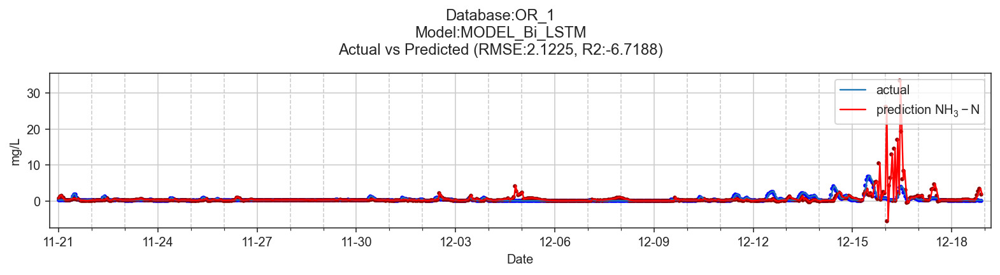

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


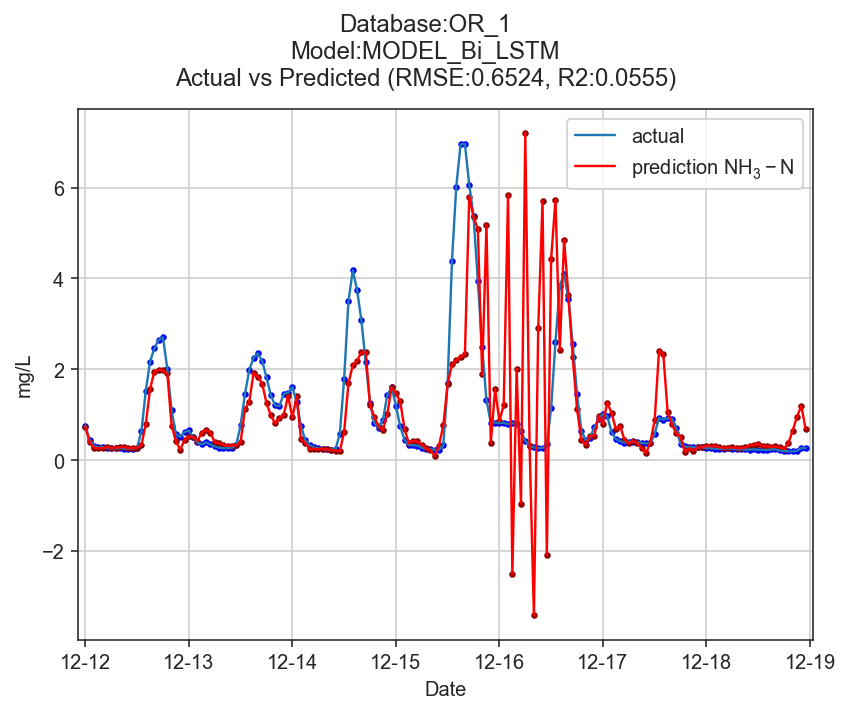

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


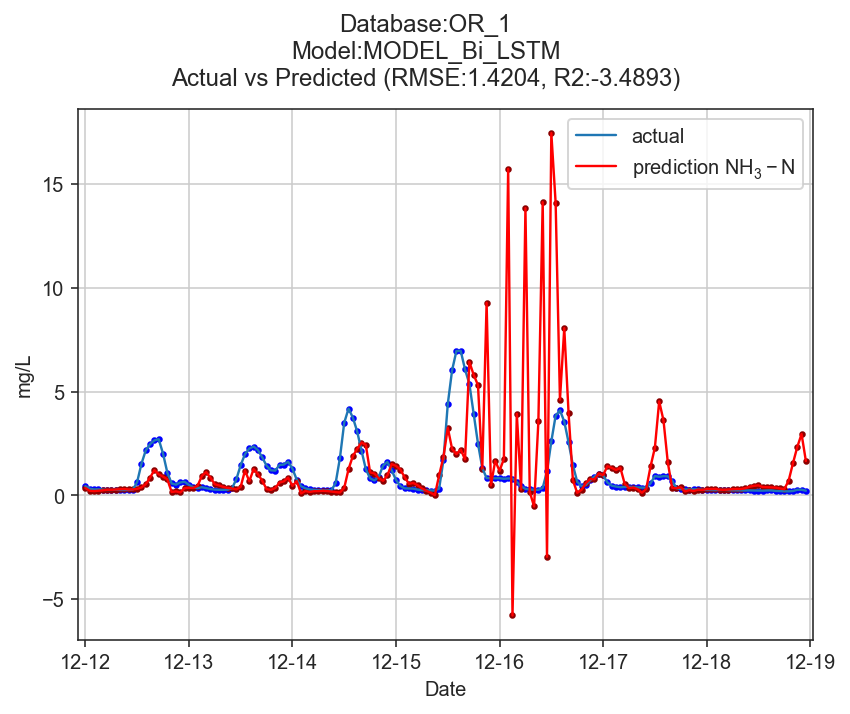

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


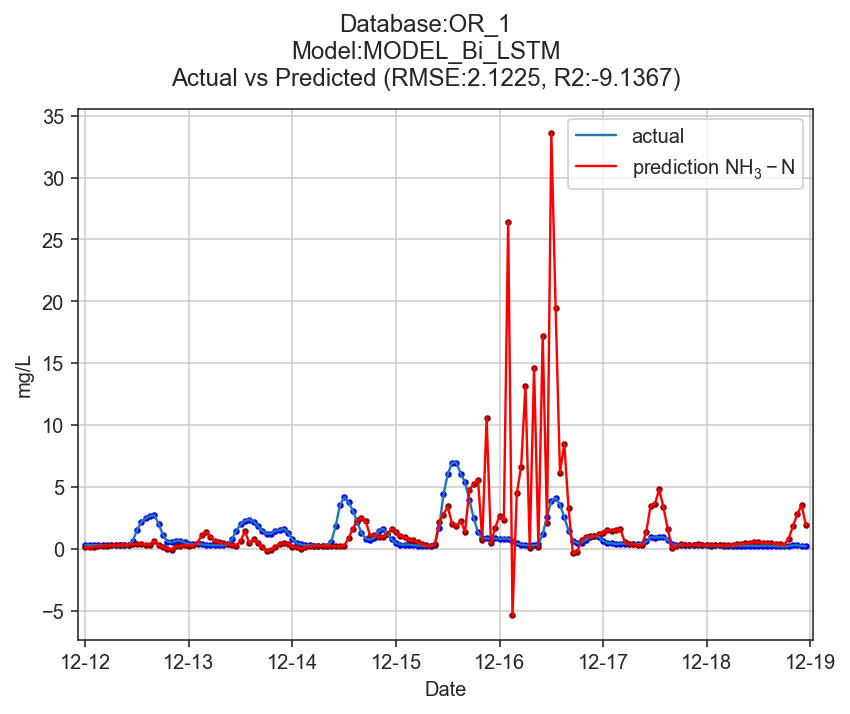

(934, 24, 1)
(670, 24, 1)
(934, 3, 1)
(670, 3, 1)
Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_22 (LSTM)               (None, 10)                480       
_________________________________________________________________
repeat_vector_5 (RepeatVecto (None, 3, 10)             0         
_________________________________________________________________
lstm_23 (LSTM)               (None, 3, 10)             840       
_________________________________________________________________
time_distributed_5 (TimeDist (None, 3, 1)              11        
Total params: 1,331
Trainable params: 1,331
Non-trainable params: 0
_________________________________________________________________
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 4 in progress
Experiment 5 in progress
Experiment 6 in progress
Experiment 7 in progress
Experiment 8 in progress

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


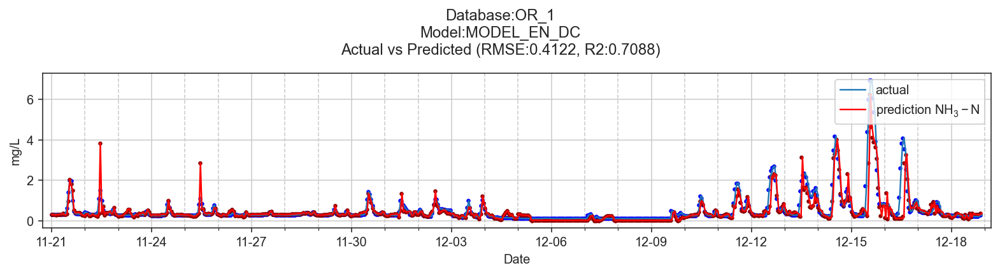

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


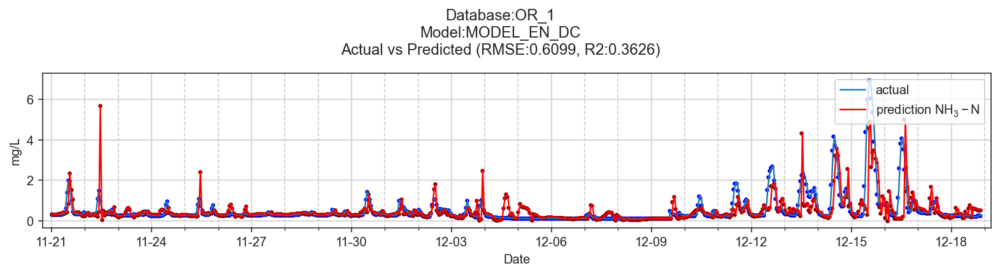

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


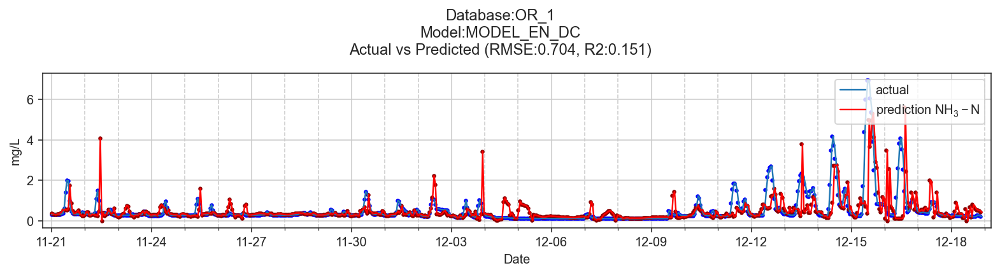

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


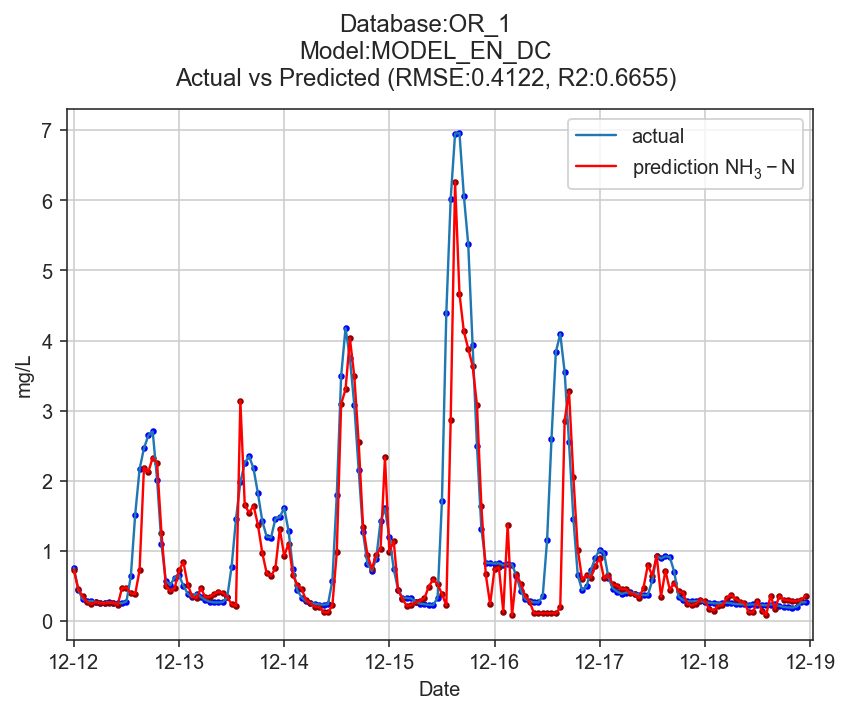

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


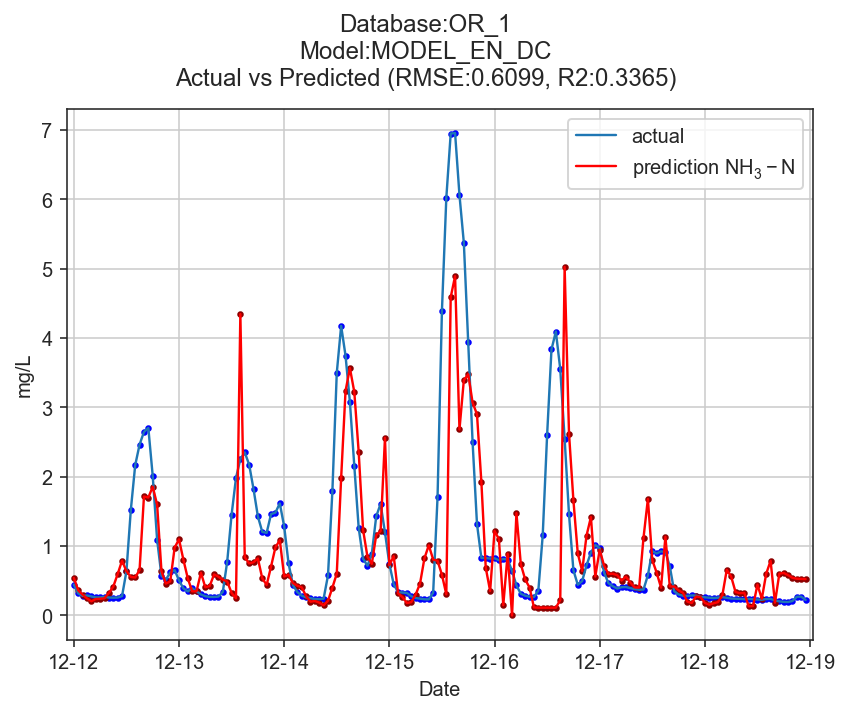

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


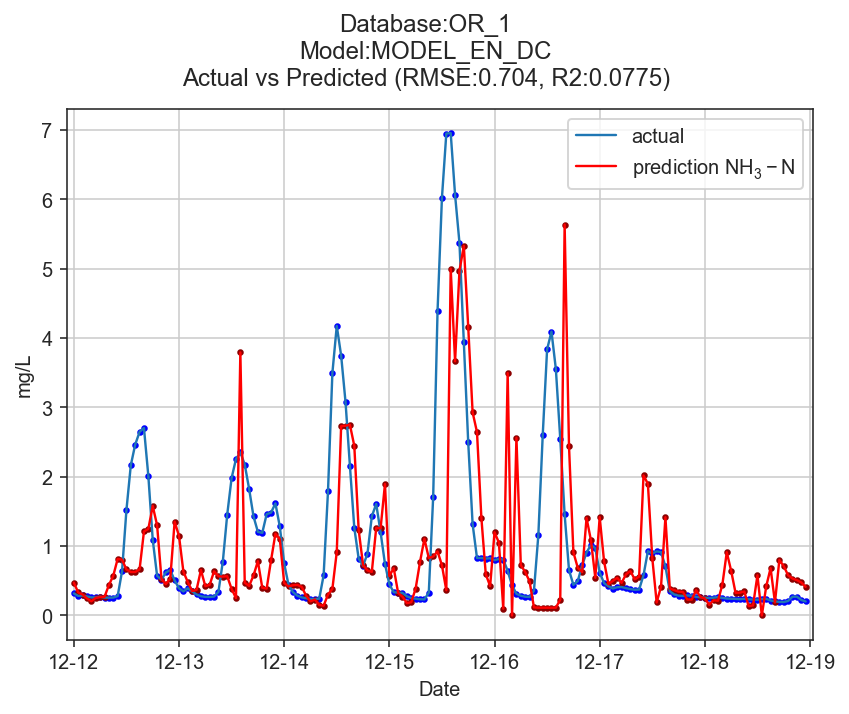

Experiment 1 in progress
TrainRMSE_Mean 0.7950578233659839
TestRMSE_Mean 1.4528746209475536
Experiment 2 in progress
TrainRMSE_Mean 0.7739823658810081
TestRMSE_Mean 1.4321529856649162
Experiment 3 in progress
TrainRMSE_Mean 0.7824622008810209
TestRMSE_Mean 1.4314195057757038
Experiment 4 in progress
TrainRMSE_Mean 0.7858470748982661
TestRMSE_Mean 1.444566520254389
Experiment 5 in progress
TrainRMSE_Mean 0.7890686532918598
TestRMSE_Mean 1.465428816856106
Experiment 6 in progress
TrainRMSE_Mean 0.7715976243527921
TestRMSE_Mean 1.4134284507623331
Experiment 7 in progress
TrainRMSE_Mean 0.7931404729284255
TestRMSE_Mean 1.4349545896306708
Experiment 8 in progress
TrainRMSE_Mean 0.7794302347813239
TestRMSE_Mean 1.4308616153119191
Experiment 9 in progress
TrainRMSE_Mean 0.7900638839363944
TestRMSE_Mean 1.4382733840329662
Experiment 10 in progress
TrainRMSE_Mean 0.7961889670249273
TestRMSE_Mean 1.4640999222094835
Total time for 10 experiments 1908.9905548095703
MODEL_RNN
       TrainRMSE  Test

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


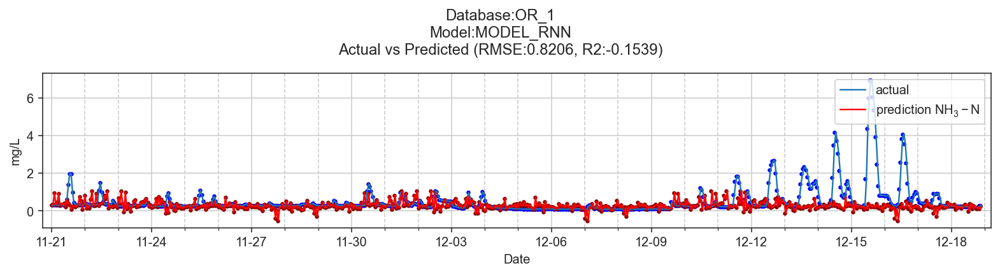

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


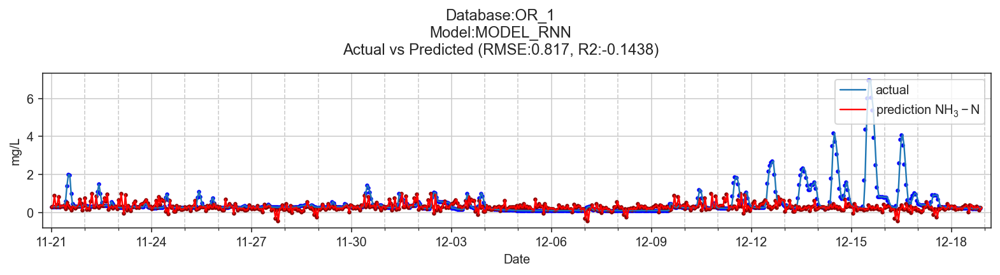

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


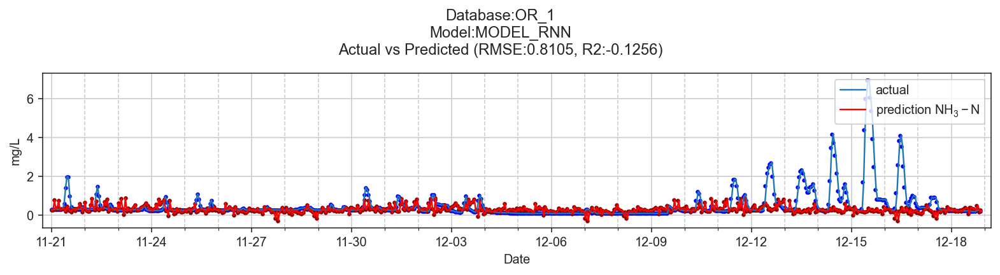

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


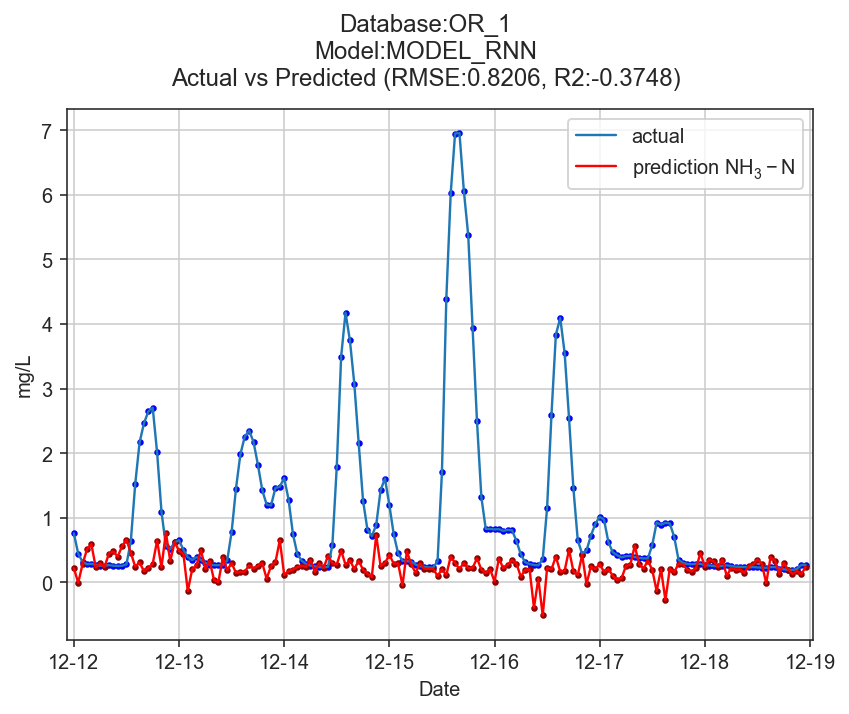

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


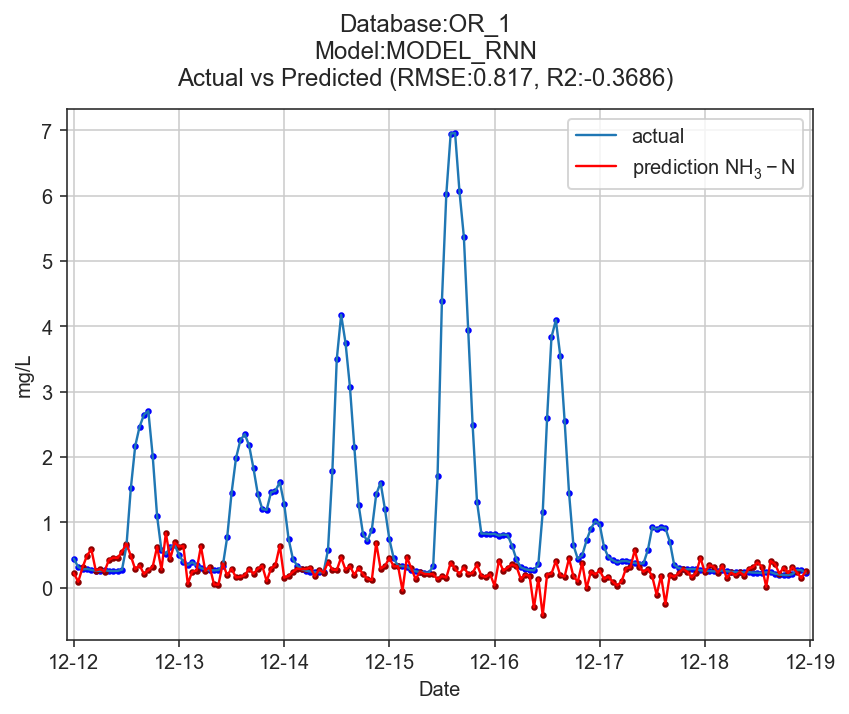

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


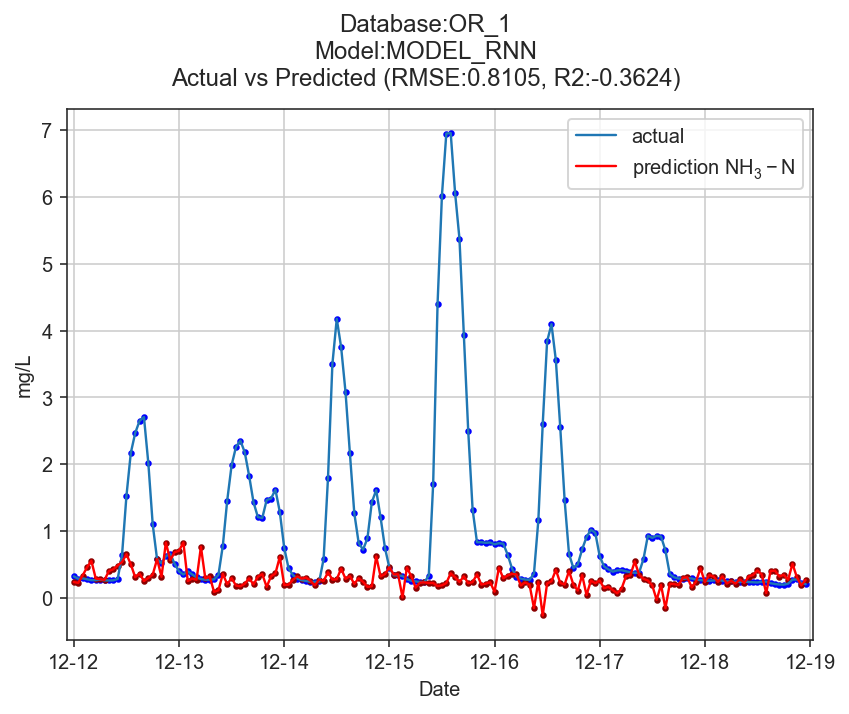

(934, 24, 1)
(670, 24, 1)
Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_5 (Conv1D)            (None, 22, 64)            256       
_________________________________________________________________
max_pooling1d_5 (MaxPooling1 (None, 11, 64)            0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 704)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 10)                7050      
_________________________________________________________________
dense_29 (Dense)             (None, 3)                 33        
Total params: 7,339
Trainable params: 7,339
Non-trainable params: 0
_________________________________________________________________
None
Experiment 1 in progress
Experiment 2 in progress
Experiment 3 in progress
Experiment 

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


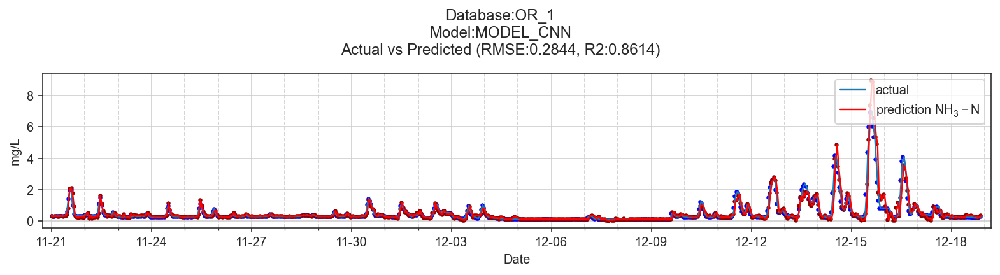

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


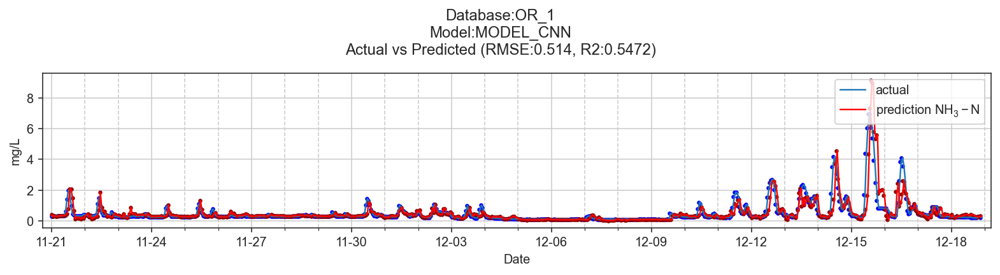

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:473: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])


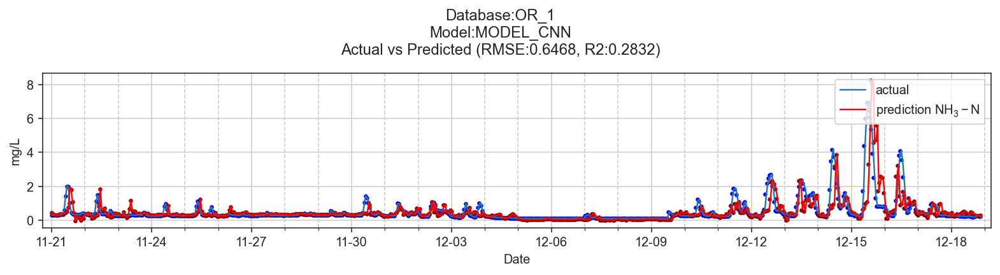

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


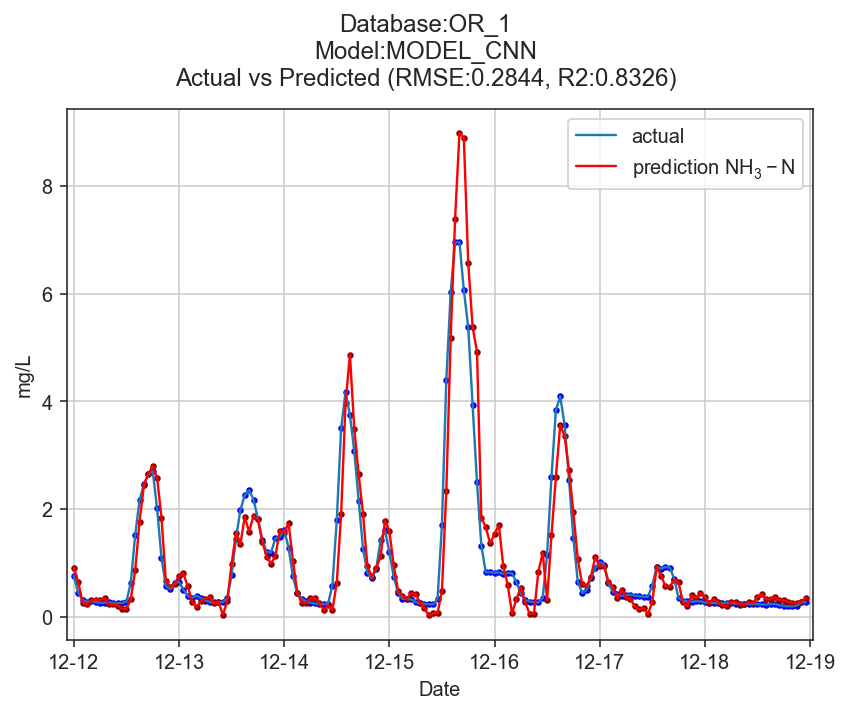

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


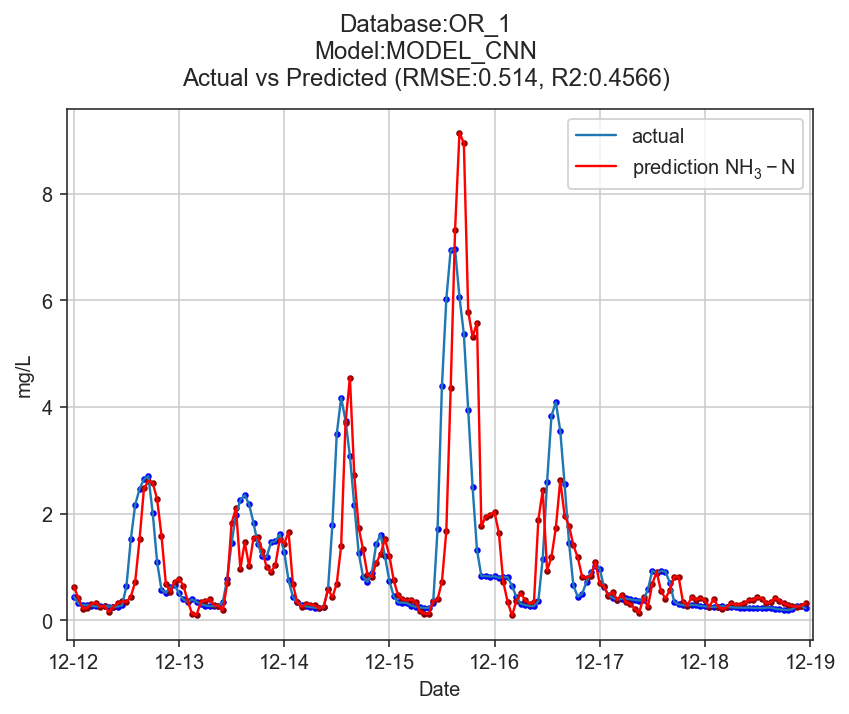

C:\Users\Tim\AppData\Local\Temp/ipykernel_37012/1892691190.py:511: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])


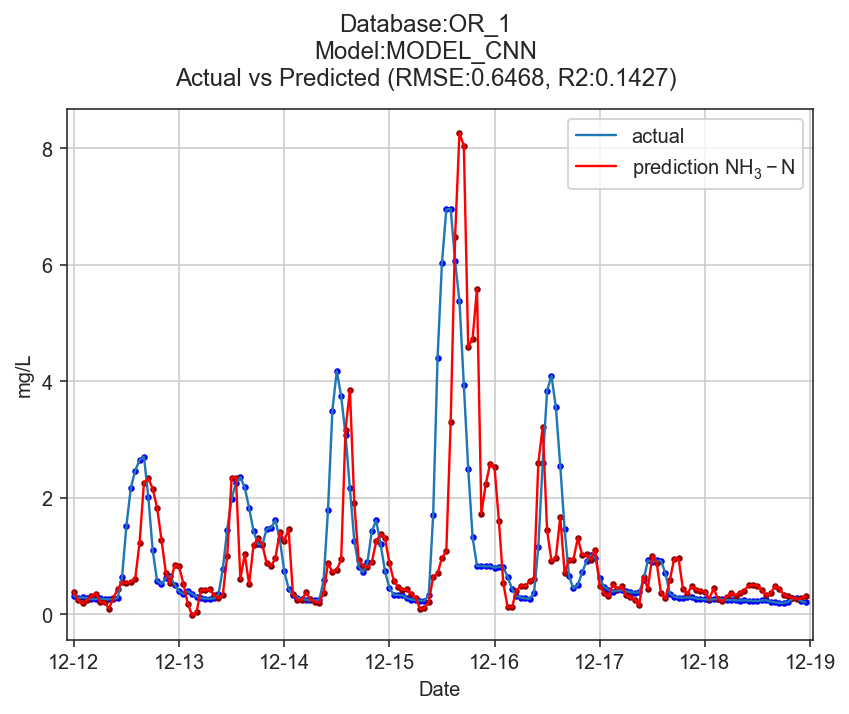

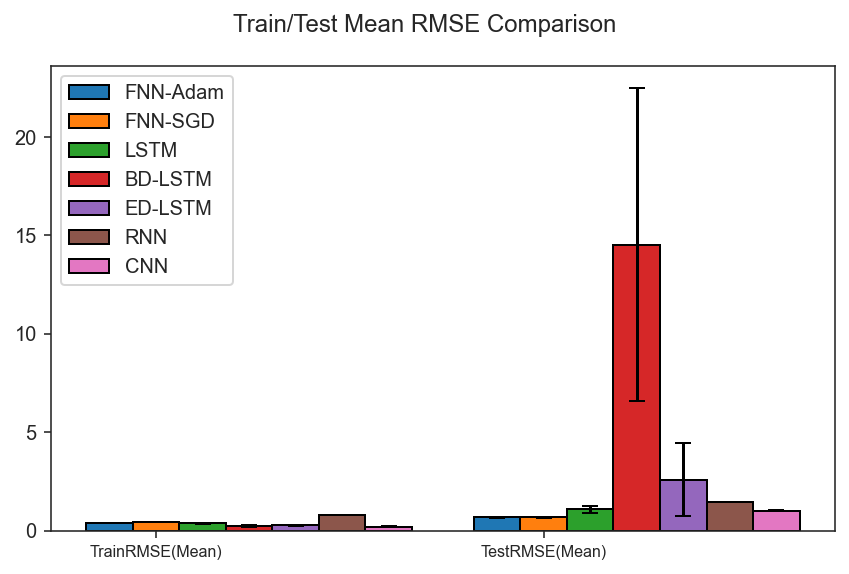

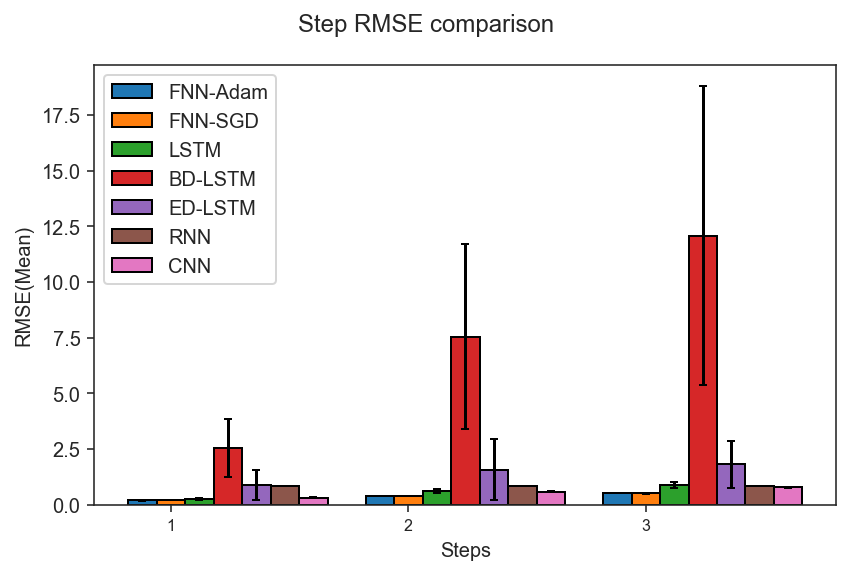

     Dataset    Method Train-RMSE-Mean Train-RMSE-Std Train-CI-LB Train-CI-UB  \
0   Observed  FNN-Adam          0.3689         0.0152      0.3594      0.3783   
1   Observed   FNN-SGD          0.4353         0.0087      0.4299      0.4407   
2   Observed      LSTM          0.2209         0.0412      0.1953      0.2464   
3   Observed   BD-LSTM          0.2354         0.0594      0.1986      0.2722   
4   Observed   ED-LSTM           1.089            0.0       1.089       1.089   
5   Observed       RNN          0.7194         0.0093      0.7137      0.7252   
6   Observed       CNN          0.2053         0.0422      0.1791      0.2315   
7       SG_1  FNN-Adam          0.3869         0.0191      0.3751      0.3987   
8       SG_1   FNN-SGD          0.4305         0.0103      0.4242      0.4369   
9       SG_1      LSTM          0.2492         0.0686      0.2067      0.2917   
10      SG_1   BD-LSTM          0.2787         0.0577       0.243      0.3145   
11      SG_1   ED-LSTM      

In [4]:
def MODEL_FNN_adam(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden):
    train_acc=np.zeros(Num_Exp) #to record the accuracy from each time of the experiment
    test_acc=np.zeros(Num_Exp)
    Step_RMSE=np.zeros([Num_Exp,n_steps_out])

    X_train_input, X_valid_input, Y_train_input, Y_valid_input = train_test_split(X_train, Y_train.values, test_size=0.2, random_state=0)

    model = RandomForestRegressor(n_estimators = 300 ,  random_state = 0)
    Best_RMSE=1000   #Assigning a large number   
    
    start_time=time.time() #to calcuate the computing time
    for run in range(Num_Exp):
        print("Experiment",run+1,"in progress")
        mlp.fit(x_train, y_train)  
        y_predicttrain = mlp.predict(x_train)
        y_predicttest = mlp.predict(x_test)
        train_acc[run] = rmse( y_predicttrain, y_train) 
        print("TrainRMSE_Mean",train_acc[run]) 
        test_acc[run] = rmse( y_predicttest, y_test)
        print("TestRMSE_Mean",test_acc[run])
        if test_acc[run]<Best_RMSE:
            Best_RMSE=test_acc[run]
            Best_Predict_Test=y_predicttest
        for j in range(n_steps_out):
            Step_RMSE[run][j]=rmse(y_predicttest[:,j], y_test[:,j])
            
    print("Total time for",Num_Exp,"experiments",time.time()-start_time)
    return train_acc,test_acc,Step_RMSE,Best_Predict_Test

def MODEL_FNN_sgd(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden):
    train_acc=np.zeros(Num_Exp)
    test_acc=np.zeros(Num_Exp)
    Step_RMSE=np.zeros([Num_Exp,n_steps_out])
    mlp_sgd = MLPRegressor(hidden_layer_sizes=(Hidden, ), activation='relu', solver='adam', alpha=0.1,max_iter=Epochs, tol=0)
    Best_RMSE=1000   #Assigning a large number  
    
    start_time=time.time()
    for run in range(Num_Exp):
        print("Experiment",run+1,"in progress")
        mlp_sgd.fit(x_train,y_train)
        y_predicttrain = mlp_sgd.predict(x_train)
        y_predicttest = mlp_sgd.predict(x_test)
        train_acc[run] = rmse( y_predicttrain,y_train) 
        test_acc[run] = rmse( y_predicttest, y_test) 
        if test_acc[run]<Best_RMSE:
            Best_RMSE=test_acc[run]
            Best_Predict_Test=y_predicttest
        for j in range(n_steps_out):
            Step_RMSE[run][j]=rmse(y_predicttest[:,j], y_test[:,j])
            
    print("Total time for",Num_Exp,"experiments",time.time()-start_time)
    return train_acc,test_acc,Step_RMSE,Best_Predict_Test

def main():

    #if n_steps_in and n_stes_out are changed, also need to change the transformation (should be integrated together later on)
    n_steps_in, n_steps_out = 24,3 #past 24 hours to predict next five hours
    Overall_Analysis=np.zeros([1*8,10+n_steps_out*5]) #the number of the rows are the number of database times number of methods, which are 6 and 7 repectively
    #Overall_Analysis = pd.read_csv("Results/OverallAnalysis.csv",index_col = 0)
    #Overall_Analysis=Overall_Analysis.values
    #Overall_Analysis=Overall_Analysis[:,2:]
    for i in range(1,9):
        problem=i
        if problem ==1:
            TrainData = pd.read_csv("data/train/obs/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'obs'
        if problem ==2:
            TrainData = pd.read_csv("data/train/sg5/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'sg5'
        if problem ==3:
            TrainData = pd.read_csv("data/train/sg7/train.csv",index_col = 0)
            TrainData = TrainData.values
            name='sg7'
        if problem ==4:
            TrainData = pd.read_csv("data/train/sg9/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'sg9'
        if problem ==5:
            TrainData = pd.read_csv("data/train/ew2/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'ew2'
        if problem ==6:
            TrainData = pd.read_csv("data/train/ew3/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'ew3'
        if problem ==6:
            TrainData = pd.read_csv("data/train/ew4/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'ew4'
        if problem ==6:
            TrainData = pd.read_csv("data/train/or/train.csv",index_col = 0)
            TrainData = TrainData.values
            name= 'or'

        TestData = pd.read_csv("data/test/test.csv",index_col = 0)
        TestData = TestData.values

        x_train = TrainData[:,0:n_steps_in]
        y_train = TrainData[:,n_steps_in : n_steps_in+n_steps_out ]
        x_test = TestData[:,0:n_steps_in]
        y_test = TestData[:,n_steps_in : n_steps_in+n_steps_out]
        print(name)

        Num_Exp=10    #No. of experiments
        Epochs=1000
        Hidden=10
        train_acc=np.zeros(Num_Exp)
        test_acc=np.zeros(Num_Exp)
        Step_RMSE=np.zeros([Num_Exp,n_steps_out])


        for k in range(1,8):

            method=k
            if method ==1:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_FNN_adam(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_FNN_adam"
            if method ==2:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_FNN_sgd(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_FNN_sgd"
            if method ==3:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_LSTM(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_LSTM"
            if method ==4:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_Bi_LSTM(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_Bi_LSTM"
            if method ==5:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_EN_DC(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_EN_DC"
            if method ==6:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_RNN(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_RNN"
            if method ==7:
                train_acc,test_acc,Step_RMSE,Best_Predict_Test=MODEL_CNN(x_train,x_test,y_train,y_test,Num_Exp,n_steps_in,n_steps_out,Epochs,Hidden)
                Mname="MODEL_CNN"
                

            print(Mname)

            arr = np.dstack((train_acc,test_acc))  #turn 1D-array (M,) into (1,M,1) #the way i used to do it is to create a dataframe, then input the array as a column
            arr=arr.reshape(Num_Exp,2) #
            arr=np.concatenate((arr,Step_RMSE), axis=1)
            arr=arr.reshape(Num_Exp,2+n_steps_out)
            
            ExpIndex=np.array([])
            for j in range(Num_Exp):
                ExpIndex=np.concatenate((ExpIndex,["Exp"+str(j+1)]))

            ExpIndex1=['TrainRMSE','TestRMSE']
            for j in range(n_steps_out):
                ExpIndex1=np.concatenate((ExpIndex1,["Step"+str(j+1)]))
                
            arr=np.round_(arr, decimals = 5) 
            arr = pd.DataFrame(arr, index = ExpIndex , columns = ExpIndex1)

            #write file to non-exist folder path
            outname_ExpAnalysis = 'ExpAnalysis.csv'
            outdir_ExpAnalysis = f'Results/{name}/{Mname}'

            if not os.path.exists(outdir_ExpAnalysis):
                os.makedirs(outdir_ExpAnalysis)
            
            fullname_ExpAnalysis = os.path.join(outdir_ExpAnalysis, outname_ExpAnalysis)
            arr.to_csv(fullname_ExpAnalysis)
            print(arr)
            
            
            Train_Mean=np.mean(train_acc) #train mean is the mean value from all the RMSE in NumExp
            Train_Std=np.std(train_acc) 
            Train_CI_LB= Train_Mean-1.96*(Train_Std/np.sqrt(Num_Exp))
            Train_CI_UB= Train_Mean+1.96*(Train_Std/np.sqrt(Num_Exp))
            
            Test_Mean=np.mean(test_acc)
            Test_Std=np.std(test_acc)
            Test_CI_LB= Test_Mean-1.96*(Test_Std/np.sqrt(Num_Exp))
            Test_CI_UB= Test_Mean+1.96*(Test_Std/np.sqrt(Num_Exp))
            
            database_n = 6
            model_n = 7
            #input the statistics of train and test results 
            #The "7" here needs to be changed into different number if we are applying for more models
            Overall_Analysis[(i-1)*model_n+(k-1)][0]=Train_Mean  #for database i, model k (e.g., i=1, k=1), Overall_Analysis is a 2D-array, from Train_Mean to np.min(test_acc) will be input into row=0, model k=2, input into row=2...
            Overall_Analysis[(i-1)*model_n+(k-1)][1]=Train_Std
            Overall_Analysis[(i-1)*model_n+(k-1)][2]=Train_CI_LB
            Overall_Analysis[(i-1)*model_n+(k-1)][3]=Train_CI_UB
            Overall_Analysis[(i-1)*model_n+(k-1)][4]=np.min(train_acc)
            #for test
            Overall_Analysis[(i-1)*model_n+(k-1)][5]=Test_Mean
            Overall_Analysis[(i-1)*model_n+(k-1)][6]=Test_Std
            Overall_Analysis[(i-1)*model_n+(k-1)][7]=Test_CI_LB
            Overall_Analysis[(i-1)*model_n+(k-1)][8]=Test_CI_UB
            Overall_Analysis[(i-1)*model_n+(k-1)][9]=np.min(test_acc)
            
            arr1 = np.vstack(([Train_Mean,Train_Std,Train_CI_LB,Train_CI_UB,np.min(train_acc),np.max(train_acc)],[Test_Mean,Test_Std,Test_CI_LB,Test_CI_UB,np.min(test_acc),np.max(test_acc)]))
            
            #input step stats
            for j in range(n_steps_out):
                Step_mean = np.mean(Step_RMSE[:,j])
                Step_std = np.std(Step_RMSE[:,j])
                Step_min = np.min(Step_RMSE[:,j])
                Step_CI_LB= Step_mean-1.96*(Step_std/np.sqrt(Num_Exp))
                Step_CI_UB= Step_mean+1.96*(Step_std/np.sqrt(Num_Exp))
                arr1=np.vstack((arr1,[Step_mean,Step_std,Step_CI_LB,Step_CI_UB,Step_min,np.max(Step_RMSE[:,j])]))
                #The "7" here needs to be changed into different number if we are applying for more models
                Overall_Analysis[(i-1)*model_n+(k-1)][5*j+10]= Step_mean 
                Overall_Analysis[(i-1)*model_n+(k-1)][5*j+11]= Step_std
                Overall_Analysis[(i-1)*model_n+(k-1)][5*j+12]= Step_CI_LB
                Overall_Analysis[(i-1)*model_n+(k-1)][5*j+13]= Step_CI_UB
                Overall_Analysis[(i-1)*model_n+(k-1)][5*j+14]= Step_min
            arr1=np.round_(arr1, decimals = 5) 
            arr1 = pd.DataFrame(arr1, index=ExpIndex1, columns = ['Mean','Standard Deviation','CI_LB','CI_UB','Min','Max'])
            print(arr1)
            
            arr1.to_csv("Results/"+name+"/"+Mname+"/OverallAnalysis.csv")
            
            #plot the best result from each step, at the time i might need to add rmse value on the plot?
            x_data=np.linspace(0,y_test.shape[0], num=y_test.shape[0])             
            for j in range(n_steps_out):

                %config InlineBackend.figure_format='retina'
                params = {'mathtext.default': 'regular' }          
                plt.rcParams.update(params)
                sns.set_style("ticks")
                R2 = r2_score(y_test[:,j],Best_Predict_Test[:,j])
                rmse_val = rmse(Best_Predict_Test[:,j], y_test[:,j])

                fig, ax = plt.subplots(figsize=(11,3))
                plt.suptitle(f'Database:{name}\nModel:{Mname}\nActual vs Predicted (RMSE:{round(rmse_val,4)}, R2:{round(R2,4)})')

                size=5
                ax.scatter(np.arange(0,len(x_data)), y_test[:,j],s=size,color='blue')
                ax.plot(x_data, y_test[:,j], label='actual',linewidth=1.2)

                ax.scatter(np.arange(0,len(x_data)), Best_Predict_Test[:,j], s=size,c='darkred')
                ax.plot(x_data, Best_Predict_Test[:,j], label='prediction $NH_3-N$', color='red',linewidth=1.2)

                ax.legend(loc='upper right')
                ax.grid(which='both')
                ax.set_xlabel('Date')
                ax.set_ylabel('mg/L')
                ax.margins(x=0.01)

                xmajorLocator = MultipleLocator(72)
                ax.xaxis.set_major_locator(xmajorLocator)

                xminorLocator = MultipleLocator(24) #将x轴次刻度标签设置为5的倍数 
                ax.xaxis.set_minor_locator(xminorLocator)
                ax.xaxis.grid(which='minor', ls='--')
                ax.xaxis.grid(which='major', ls='-')

                #11/20~12/18
                ax.set_xticklabels(['11-18','11-21','11-24','11-27','11-30','12-03','12-06','12-09','12-12','12-15','12-18'])
                plt.tight_layout()
                plt.savefig("Results/"+name+"/"+Mname+'/pred_Step'+str(j+1)+'.png',dpi=300,bbox_inches='tight') 
                plt.show()
                plt.close()
            
            #plot only the last 7 days
            for j in range(n_steps_out):

                %config InlineBackend.figure_format='retina'
                params = {'mathtext.default': 'regular' }          
                plt.rcParams.update(params)
                sns.set_style("ticks")
                R2 = r2_score(y_test[-24*7:,j],Best_Predict_Test[-24*7:,j])
                rmse_val = rmse(Best_Predict_Test[:,j], y_test[:,j])

                fig, ax = plt.subplots(figsize=(6,5))
                plt.suptitle(f'Database:{name}\nModel:{Mname}\nActual vs Predicted (RMSE:{round(rmse_val,4)}, R2:{round(R2,4)})')

                size=5
                ax.scatter(np.arange(0,24*7), y_test[-24*7:,j],s=size,color='blue')
                ax.plot(np.arange(0,24*7), y_test[-24*7:,j], label='actual',linewidth=1.2)

                ax.scatter(np.arange(0,24*7), Best_Predict_Test[-24*7:,j], s=size,c='darkred')
                ax.plot(np.arange(0,24*7), Best_Predict_Test[-24*7:,j], label='prediction $NH_3-N$', color='red',linewidth=1.2)

                ax.legend(loc='upper right')
                ax.grid(which='both')
                ax.set_xlabel('Date')
                ax.set_ylabel('mg/L')
                ax.margins(x=0.01)

                xmajorLocator = MultipleLocator(24)
                ax.xaxis.set_major_locator(xmajorLocator)

                ax.xaxis.grid(which='major', ls='-')

                #11/20~12/18
                ax.set_xticklabels(['12-11','12-12','12-13','12-14','12-15','12-16','12-17','12-18','12-19'])
                plt.tight_layout()
                plt.savefig("Results/"+name+"/"+Mname+'/7d_pred_Step'+str(j+1)+'.png',dpi=300,bbox_inches='tight') 
                plt.show()
                plt.close()                



            
        
        
        #Plot mean of train_RMSE and test_RMSE
        #Plot Std of train_RMSE and test_RMSE
        Plot_Mean(name,Overall_Analysis[7*(i-1):(7*i),:],n_steps_out)
        #Plot Step wise RMSE mean for different methods
        Plot_Step_RMSE_Mean(name,Overall_Analysis[7*(i-1):(7*i),:],n_steps_out)
    
    Overall_Analysis=Overall_Analysis.astype('float64')
    Overall_Analysis=np.round_(Overall_Analysis, decimals = 4)  
    
    Index1=[]
    for j in range(database_n):
        Index1=np.concatenate((Index1, ['FNN-Adam','FNN-SGD','LSTM','BD-LSTM','ED-LSTM','RNN','CNN'])) #np.shape=(49,)
    Index2=['Observed','SG_1','SG_2','EWMA_1','EWMA_2','OR_1'] 
    #Index2=['Observed']
    Index2=np.repeat(Index2,model_n) #the first element will repeat itself for seven times before it move to element 2, and 7 here is the number of the model
    Index=np.dstack((Index2,Index1))
    Index=Index.reshape(database_n*model_n,2)
    Column=['Dataset','Method','Train-RMSE-Mean','Train-RMSE-Std','Train-CI-LB','Train-CI-UB','TrainRMSE-Min','Test-RMSE-Mean','Test-RMSE-Std','Test-CI-LB','Test-CI-UB','Test-RMSE-Min']
    for j in range(1,n_steps_out+1):
        Column=np.concatenate((Column, ['Step'+str(j)+'-RMSE-Mean','Step'+str(j)+'-RMSE-Std','Step'+str(j)+'-CI-LB','Step'+str(j)+'-CI-UB','Step'+str(j)+'-RMSE-Min'])) # 12+5*n_step_out columns
  
    Overall_Analysis=np.concatenate((Index,Overall_Analysis), axis=1)
    Overall_Analysis = pd.DataFrame(Overall_Analysis, columns = Column)
    print(Overall_Analysis)
    Overall_Analysis.to_csv("Results/OverallAnalysis.csv")
    
    
    
if __name__ == "__main__": main()

finish = now.strftime("%Y/%m/%d %H:%M:%S")
print("Last edit =", finish)	